In [1]:
from multi_imbalance.datasets import load_datasets
import experiment_autoencoder as ex
from sklearn.model_selection import StratifiedKFold
from collections import Counter, defaultdict
from multi_imbalance.utils.metrics import gmean_score
from sklearn.metrics import f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from utils import plot_embeddings
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis

In [2]:
datasets = load_datasets()

In [3]:
ds_name = 'glass'
test_on_all_folds = True
test_all_ds = True

In [4]:
datasets = ex.one_hot_encode_all(datasets)

In [5]:
config = ex.config_calculation_strategy2(datasets)

In [6]:
config['cmc'] = {'nn_config': {'units_1st_layer': 17,
                               'units_2nd_layer': 256,
                               'units_3rd_layer': 128,
                               'units_latent_layer': 8},
                 'weighted_triplet_loss': True,
                 'lr': 0.0002,
                 'batch_size': 16,
                 'gamma': 0.99,
                 'epochs': 30}


config['dermatology'] = {'nn_config': {'units_1st_layer': 97,
                                       'units_2nd_layer': 128,
                                       'units_3rd_layer': 64,
                                       'units_latent_layer': 48},
                         'weighted_triplet_loss': True,
                         'lr': 0.0010,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 45}

config['hayes-roth'] = {'nn_config': {'units_1st_layer': 11,
                                      'units_2nd_layer': 128,
                                      'units_3rd_layer': 64,
                                      'units_latent_layer': 16},
                        'weighted_triplet_loss': True,
                        'lr': 0.007,
                        'batch_size': 16,
                        'gamma': 0.99,
                        'epochs': 20}

config['new_vehicle'] = {'nn_config': {'units_1st_layer': 18,
                                       'units_2nd_layer': 256,
                                       'units_3rd_layer': 128,
                                       'units_latent_layer': 16},
                         'weighted_triplet_loss': True,
                         'lr': 0.001,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 45}

config['new_yeast'] = {'nn_config': {'units_1st_layer': 9,
                                     'units_2nd_layer': 300,
                                     'units_3rd_layer': 200,
                                     'units_latent_layer': 12},
                       'weighted_triplet_loss': True,
                       'lr': 0.0004,
                       'batch_size': 32,
                       'gamma': 0.99,
                       'epochs': 3}

config['balance-scale'] = {'nn_config': {'units_1st_layer': 16,
                                         'units_2nd_layer': 64,
                                         'units_3rd_layer': 32,
                                         'units_latent_layer': 16},
                           'weighted_triplet_loss': True,
                           'lr': 0.007,
                           'batch_size': 16,
                           'gamma': 0.99,
                           'epochs': 50}

config['cleveland'] = {'nn_config': {'units_1st_layer': 24,
                                     'units_2nd_layer': 256,
                                     'units_3rd_layer': 128,
                                     'units_latent_layer': 24},
                       'weighted_triplet_loss': True,
                       'lr': 0.001,
                       'batch_size': 16,
                       'gamma': 0.99,
                       'epochs': 10}

config['cleveland_v2'] = {'nn_config': {'units_1st_layer': 23,
                                        'units_2nd_layer': 256,
                                        'units_3rd_layer': 128,
                                        'units_latent_layer': 24},
                          'weighted_triplet_loss': True,
                          'lr': 0.001,
                          'batch_size': 16,
                          'gamma': 0.99,
                          'epochs': 10}

config['glass'] = {'nn_config': {'units_1st_layer': 9,
                                 'units_2nd_layer': 256,
                                 'units_3rd_layer': 128,
                                 'units_latent_layer': 14},
                   'weighted_triplet_loss': True,
                   'lr': 0.001,
                   'batch_size': 16,
                   'gamma': 0.99,
                   'epochs': 50}

config['thyroid-newthyroid'] = {'nn_config': {'units_1st_layer': 5,
                                              'units_2nd_layer': 64,
                                              'units_3rd_layer': 32,
                                              'units_latent_layer': 8},
                                'weighted_triplet_loss': True,
                                'lr': 0.001,
                                'batch_size': 16,
                                'gamma': 0.99,
                                'epochs': 50}

config['new_ecoli'] = {'nn_config': {'units_1st_layer': 7,
                                     'units_2nd_layer': 128,
                                     'units_3rd_layer': 64,
                                     'units_latent_layer': 8},
                       'weighted_triplet_loss': True,
                       'lr': 0.0001,
                       'batch_size': 16,
                       'gamma': 0.99,
                       'epochs': 15}

config['new_led7digit'] = {'nn_config': {'units_1st_layer': 7,
                                         'units_2nd_layer': 64,
                                         'units_3rd_layer': 32,
                                         'units_latent_layer': 8},
                           'weighted_triplet_loss': True,
                           'lr': 0.0001,
                           'batch_size': 16,
                           'gamma': 0.99,
                           'epochs': 15}

config['new_winequality-red'] = {'nn_config': {'units_1st_layer': 11,
                                               'units_2nd_layer': 128,
                                               'units_3rd_layer': 64,
                                               'units_latent_layer': 12},
                                 'weighted_triplet_loss': True,
                                 'lr': 0.0001,
                                 'batch_size': 16,
                                 'gamma': 0.99,
                                 'epochs': 15}

config['4delikatne-bezover-cut'] = {'nn_config': {'units_1st_layer': 2,
                                                  'units_2nd_layer': 128,
                                                  'units_3rd_layer': 64,
                                                  'units_latent_layer': 8},
                                    'weighted_triplet_loss': True,
                                    'lr': 0.001,
                                    'batch_size': 16,
                                    'gamma': 0.99,
                                    'epochs': 30}

config['3mocniej-cut'] = {'nn_config': {'units_1st_layer': 2,
                                        'units_2nd_layer': 64,
                                        'units_3rd_layer': 32,
                                        'units_latent_layer': 8},
                          'weighted_triplet_loss': True,
                          'lr': 0.001,
                          'batch_size': 16,
                          'gamma': 0.99,
                          'epochs': 30}


config['1czysty-cut'] = {'nn_config': {'units_1st_layer': 2,
                                       'units_2nd_layer': 64,
                                       'units_3rd_layer': 32,
                                       'units_latent_layer': 8},
                         'weighted_triplet_loss': True,
                         'lr': 0.004,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 10}

config['2delikatne-cut'] = {'nn_config': {'units_1st_layer': 2,
                                          'units_2nd_layer': 64,
                                          'units_3rd_layer': 32,
                                          'units_latent_layer': 8},
                            'weighted_triplet_loss': True,
                            'lr': 0.001,
                            'batch_size': 16,
                            'gamma': 0.99,
                            'epochs': 40}

In [7]:
config

{'1czysty-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 64,
   'units_3rd_layer': 32,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.004,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 10},
 '2delikatne-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 64,
   'units_3rd_layer': 32,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.001,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 40},
 '3mocniej-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 64,
   'units_3rd_layer': 32,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.001,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 30},
 '4delikatne-bezover-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 128,
   'units_3rd_layer': 64,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.001,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 30},
 'balance-scale': {'nn_config': {'units_

In [8]:
autoencoder_config = ex.autoenc_config_calc_strategy1(datasets)

In [9]:
autoencoder_config['balance-scale']

{'epochs': 25,
 'batch_size': 16,
 'test_batch_size': 16,
 'lr': 0.001,
 'gamma': 1}

In [10]:
autoencoder_config['hayes-roth'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}


autoencoder_config['dermatology'] = {
    'epochs': 70,
    'batch_size': 16,
    'test_batch_size': 16,
    'lr': 0.002,
    'gamma': 1
}

autoencoder_config['balance-scale'] = {
    'epochs': 30,
    'batch_size': 16,
    'test_batch_size': 16,
    'lr': 0.002,
    'gamma': 1
}

autoencoder_config['2delikatne-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['3mocniej-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}


autoencoder_config['cleveland'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['cleveland_v2'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['glass'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.002,
    "gamma": 1
}


autoencoder_config['4delikatne-bezover-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}


autoencoder_config['new_yeast'] = {
    "epochs": 30,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['new_ecoli'] = {
    "epochs": 30,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['1czysty-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

In [11]:
k_dict = ex.construct_k_dict(datasets)
k_dict['balance-scale'] = 21
k_dict['new_vehicle'] = 13
k_dict['new_yeast'] = 21
k_dict['2delikatne-cut'] = 21

In [12]:
def instantiate_classifiers():
    classifiers = {
#             "RF24": RandomForestClassifier(random_state=0, min_samples_leaf=2, min_samples_split=4, class_weight='balanced'),
            "DT": DecisionTreeClassifier(random_state=0, min_samples_split=4, min_samples_leaf=2, class_weight='balanced'),
            "KNN": KNeighborsClassifier(n_neighbors=1)
#             "QDA": QuadraticDiscriminantAnalysis(),
#             "LDA": LinearDiscriminantAnalysis()
        } 
    return classifiers

In [13]:
from experiment import dt_name_to_cols_to_encode, dt_name_minority_classes


In [14]:
from sklearn.neighbors import KNeighborsClassifier

def calc_safety5(X,y):
    result = {
        "safe":0,
        "borderline":0,
        "rare":0,
        "outlier":0
    }
    neigh = KNeighborsClassifier(n_neighbors=5)
    neigh.fit(X, y)
    neighbors = neigh.kneighbors(X, 5+1, False)
    for i, (x, nbors) in enumerate(list(zip(X, neighbors))):
        same_class_nbrs = (y[nbors[1:]] == y[i]).sum()
        if same_class_nbrs >= 4:
            result['safe'] += 1
        elif same_class_nbrs >= 2:
            result['borderline'] += 1
        elif same_class_nbrs == 1:
            result['rare'] += 1
        else:
            result['outlier'] += 1
    return result

In [15]:
def standardize(X_train, X_test):
    means = X_train.mean(axis=0)
    stds = X_train.std(axis=0)
    return (X_train - means) / (stds+1e-6), (X_test - means) / (stds + 1e-6)

cmc


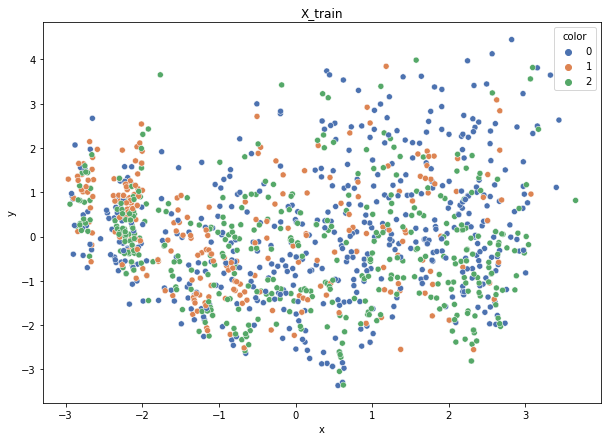

Class cardinalities: Counter({0: 503, 2: 409, 1: 266})
Weights: {0: 0.2426709552796112, 1: 0.45888530265279864, 2: 0.29844374206759033}
Training autoencoder...


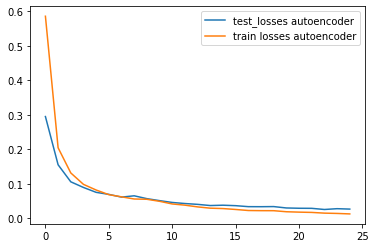

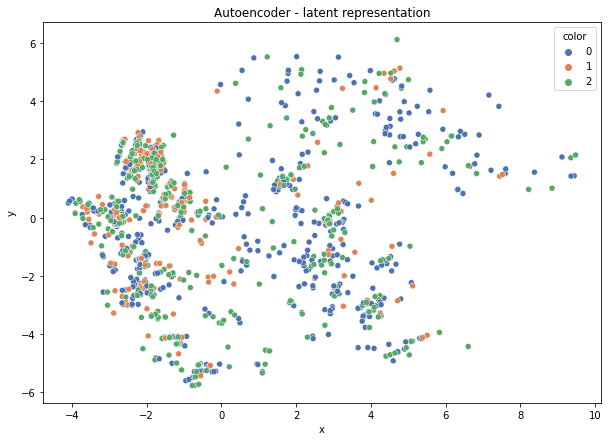

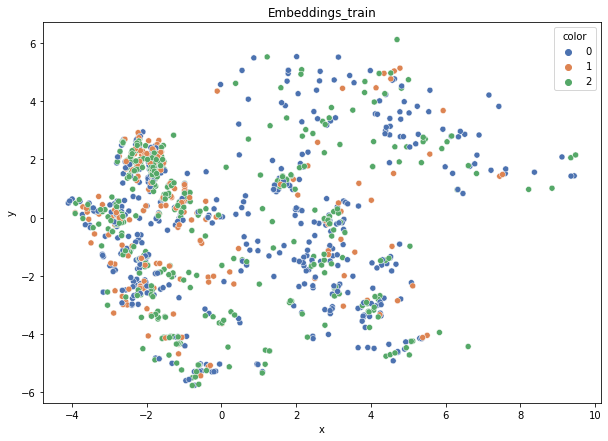

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.419
DT-f1-old+new-features: 0.437
DT-f1-old-features: 0.469
DT-gmean-new-features: 0.427
DT-gmean-old+new-features: 0.438
DT-gmean-old-features: 0.467
DT-minority_gmean-new-features: 0.008
DT-minority_gmean-old+new-features: 0.007
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.427
KNN-f1-old+new-features: 0.424
KNN-f1-old-features: 0.431
KNN-gmean-new-features: 0.428
KNN-gmean-old+new-features: 0.422
KNN-gmean-old-features: 0.425
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007


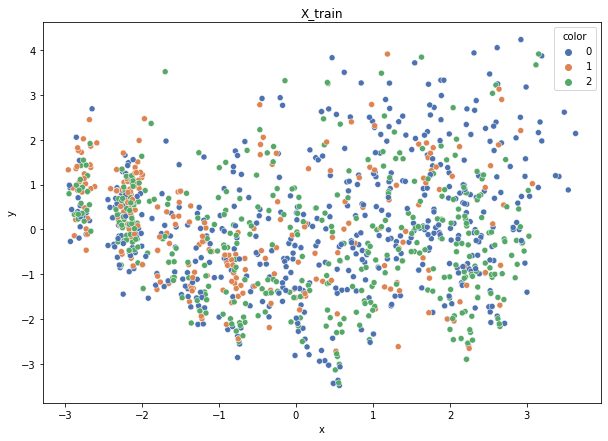

Class cardinalities: Counter({0: 503, 2: 409, 1: 266})
Weights: {0: 0.2426709552796112, 1: 0.45888530265279864, 2: 0.29844374206759033}
Training autoencoder...


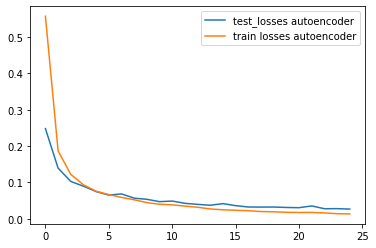

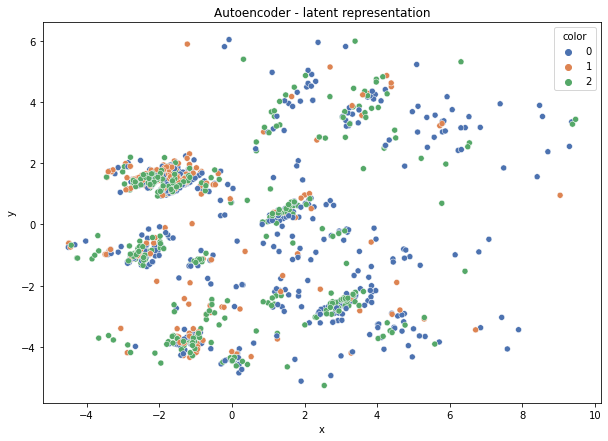

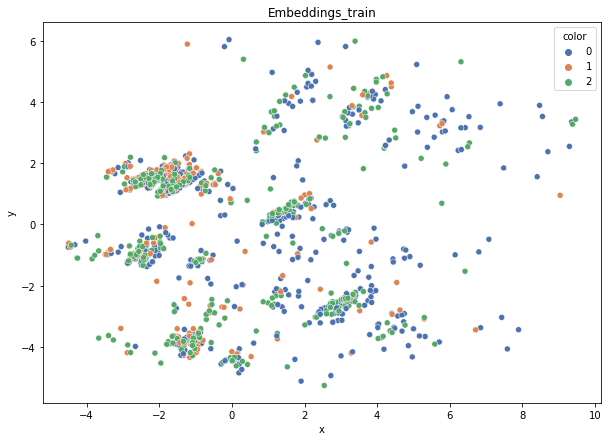

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.378
DT-f1-old+new-features: 0.446
DT-f1-old-features: 0.491
DT-gmean-new-features: 0.38
DT-gmean-old+new-features: 0.447
DT-gmean-old-features: 0.503
DT-minority_gmean-new-features: 0.007
DT-minority_gmean-old+new-features: 0.007
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.405
KNN-f1-old+new-features: 0.411
KNN-f1-old-features: 0.443
KNN-gmean-new-features: 0.397
KNN-gmean-old+new-features: 0.402
KNN-gmean-old-features: 0.433
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007


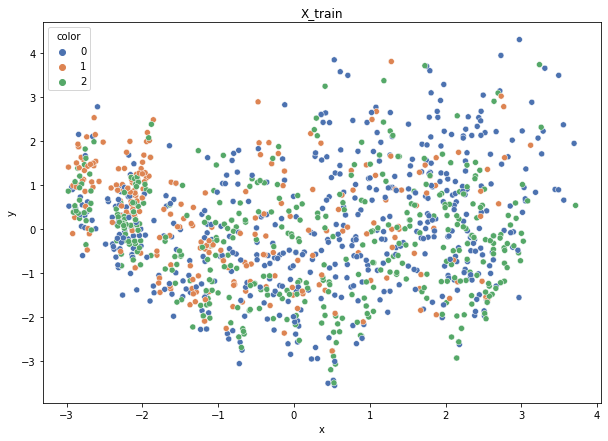

Class cardinalities: Counter({0: 503, 2: 408, 1: 267})
Weights: {0: 0.2429107547813522, 1: 0.45761838822104933, 2: 0.29947085699759846}
Training autoencoder...


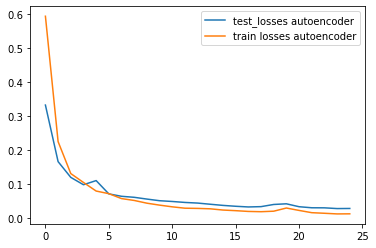

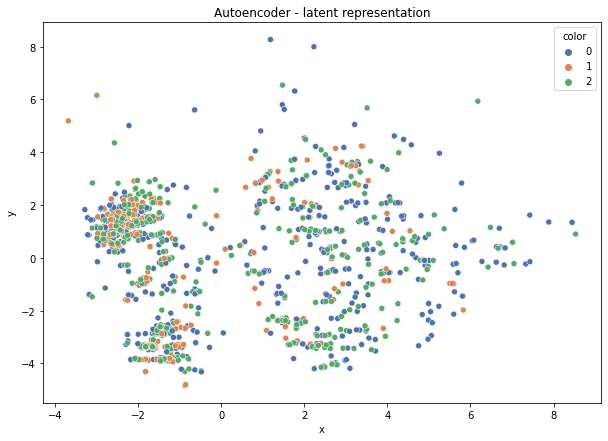

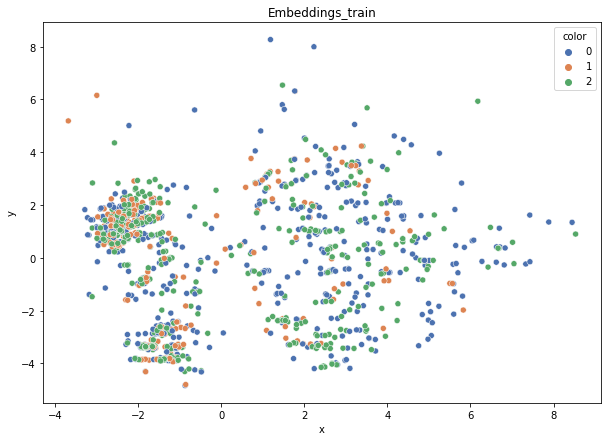

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.36
DT-f1-old+new-features: 0.482
DT-f1-old-features: 0.462
DT-gmean-new-features: 0.366
DT-gmean-old+new-features: 0.477
DT-gmean-old-features: 0.46
DT-minority_gmean-new-features: 0.007
DT-minority_gmean-old+new-features: 0.007
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.41
KNN-f1-old+new-features: 0.415
KNN-f1-old-features: 0.413
KNN-gmean-new-features: 0.406
KNN-gmean-old+new-features: 0.411
KNN-gmean-old-features: 0.399
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007


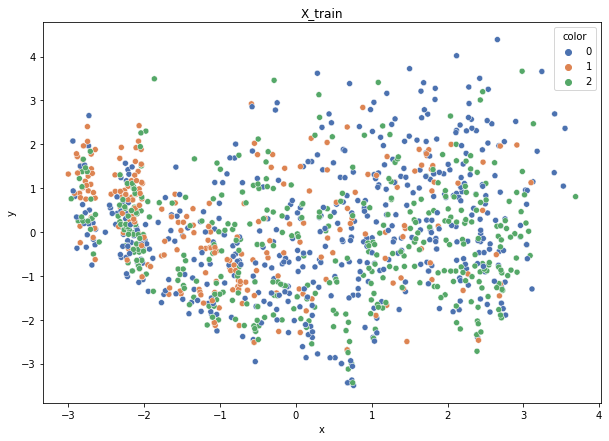

Class cardinalities: Counter({0: 503, 2: 409, 1: 267})
Weights: {0: 0.24308874498865835, 1: 0.4579537031059744, 2: 0.29895755190536716}
Training autoencoder...


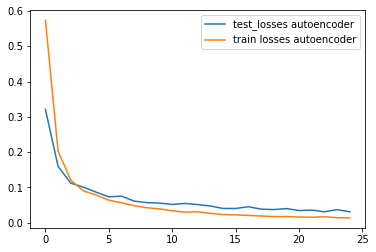

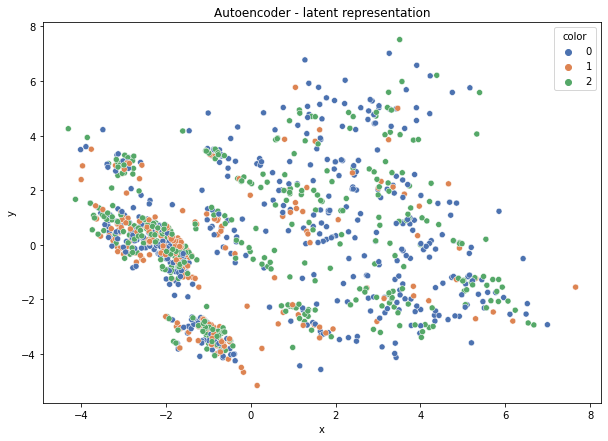

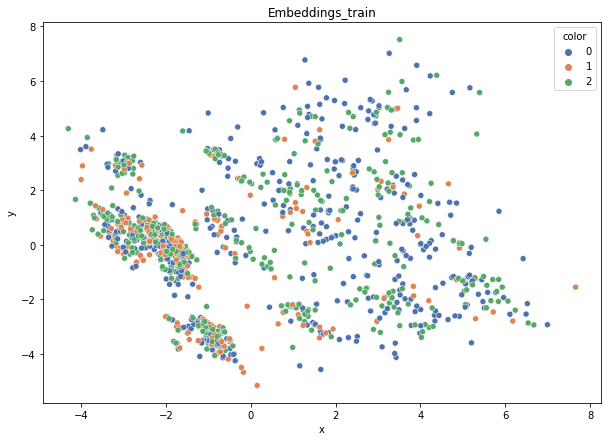

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.419
DT-f1-old+new-features: 0.457
DT-f1-old-features: 0.44
DT-gmean-new-features: 0.42
DT-gmean-old+new-features: 0.466
DT-gmean-old-features: 0.438
DT-minority_gmean-new-features: 0.007
DT-minority_gmean-old+new-features: 0.008
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.406
KNN-f1-old+new-features: 0.401
KNN-f1-old-features: 0.418
KNN-gmean-new-features: 0.402
KNN-gmean-old+new-features: 0.4
KNN-gmean-old-features: 0.413
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007


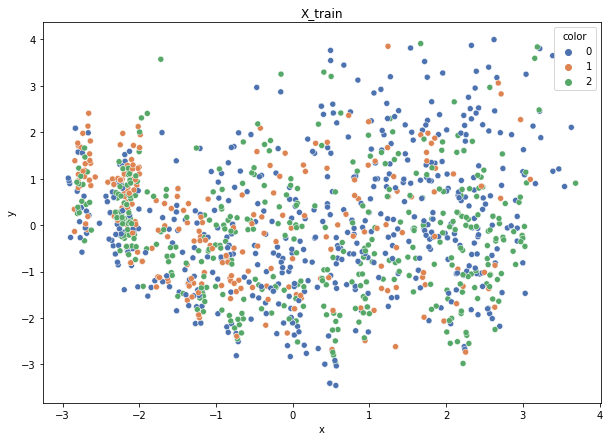

Class cardinalities: Counter({0: 504, 2: 409, 1: 266})
Weights: {0: 0.24230613326681422, 1: 0.4591063577687006, 2: 0.29858750896448505}
Training autoencoder...


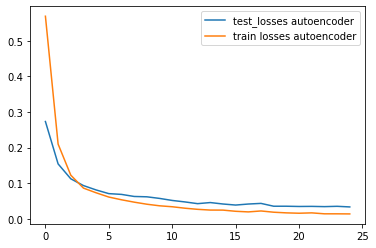

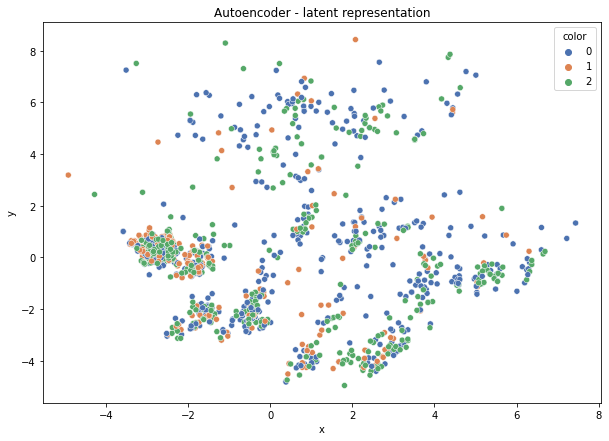

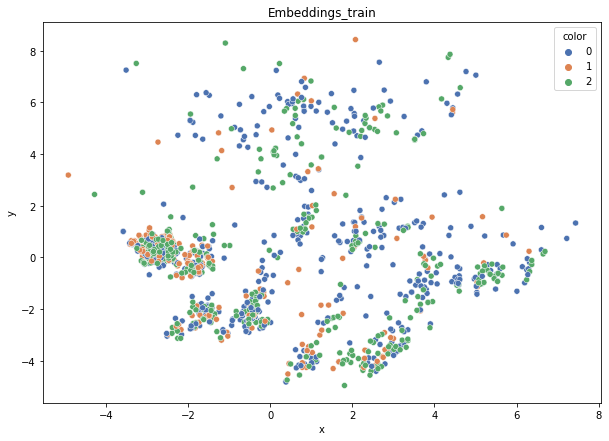

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.371
DT-f1-old+new-features: 0.431
DT-f1-old-features: 0.473
DT-gmean-new-features: 0.369
DT-gmean-old+new-features: 0.43
DT-gmean-old-features: 0.483
DT-minority_gmean-new-features: 0.007
DT-minority_gmean-old+new-features: 0.007
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.368
KNN-f1-old+new-features: 0.397
KNN-f1-old-features: 0.408
KNN-gmean-new-features: 0.355
KNN-gmean-old+new-features: 0.387
KNN-gmean-old-features: 0.394
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007
dermatology


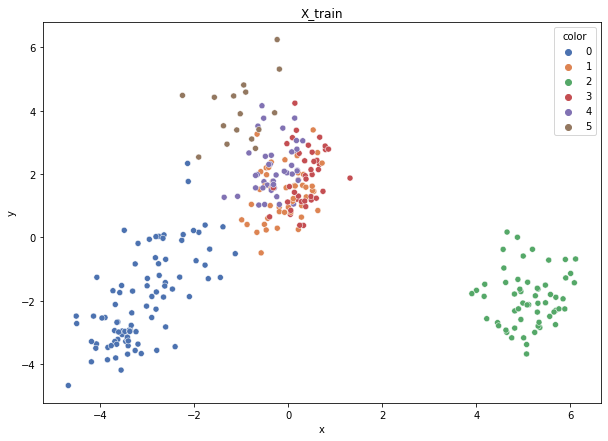

Class cardinalities: Counter({0: 90, 2: 58, 1: 48, 4: 41, 3: 39, 5: 16})
Weights: {1: 0.1288257963857323, 0: 0.0687070914057239, 2: 0.10661445218129569, 4: 0.15082044454915, 3: 0.1585548263209013, 5: 0.38647738915719687}
Training autoencoder...


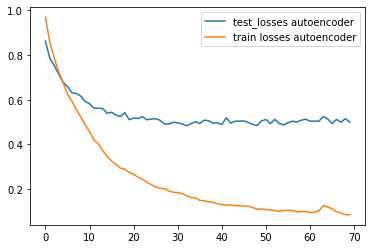

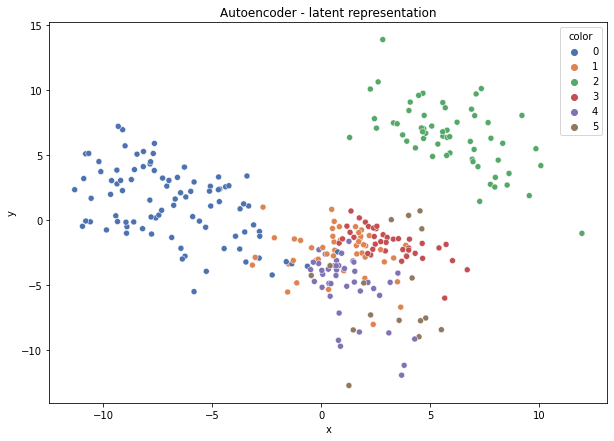

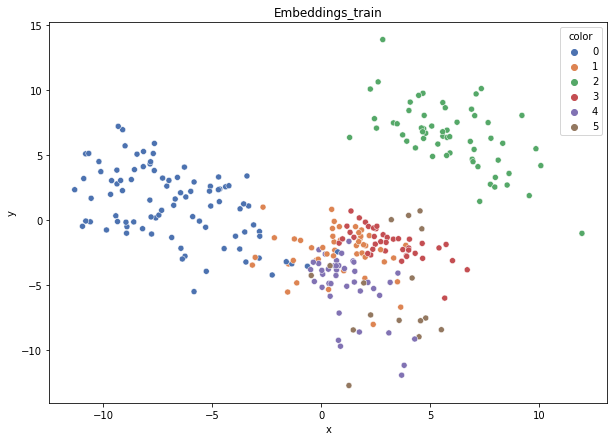

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.606
DT-f1-old+new-features: 0.851
DT-f1-old-features: 0.914
DT-gmean-new-features: 0.559
DT-gmean-old+new-features: 0.83
DT-gmean-old-features: 0.911
DT-minority_gmean-new-features: 0.008
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.918
KNN-f1-old+new-features: 0.877
KNN-f1-old-features: 0.944
KNN-gmean-new-features: 0.915
KNN-gmean-old+new-features: 0.868
KNN-gmean-old-features: 0.941
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


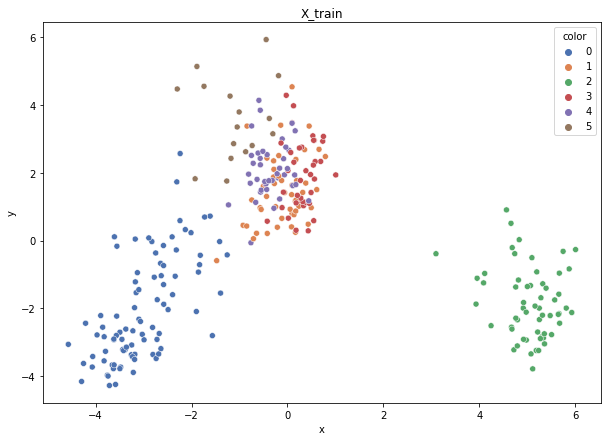

Class cardinalities: Counter({0: 89, 2: 58, 1: 49, 4: 41, 3: 40, 5: 16})
Weights: {1: 0.1269355878601628, 2: 0.10723868629565478, 0: 0.06988588545110087, 4: 0.1517035074426336, 3: 0.15549609512869944, 5: 0.3887402378217486}
Training autoencoder...


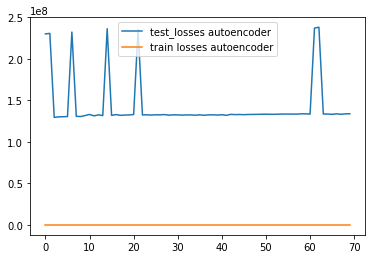

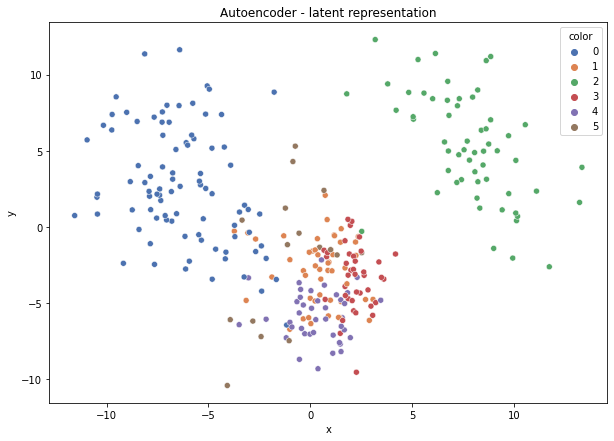

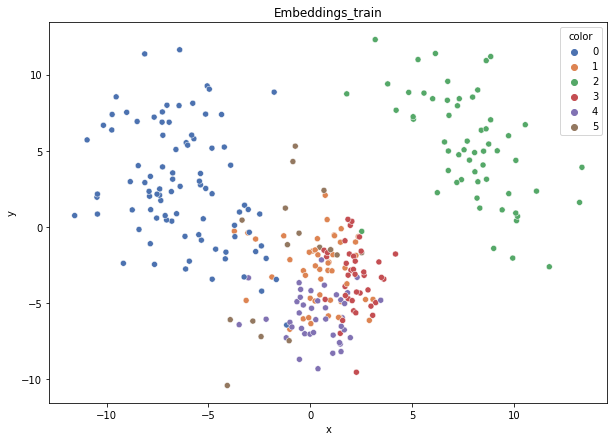

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.77
DT-f1-old+new-features: 0.94
DT-f1-old-features: 0.955
DT-gmean-new-features: 0.758
DT-gmean-old+new-features: 0.94
DT-gmean-old-features: 0.955
DT-minority_gmean-new-features: 0.027
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.917
KNN-f1-old+new-features: 0.944
KNN-f1-old-features: 0.952
KNN-gmean-new-features: 0.925
KNN-gmean-old+new-features: 0.951
KNN-gmean-old-features: 0.951
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


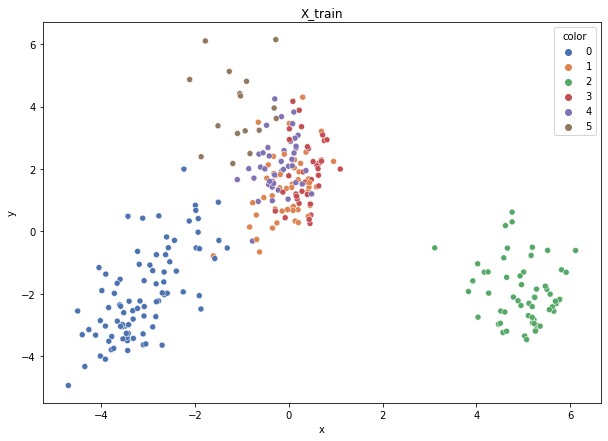

Class cardinalities: Counter({0: 89, 2: 58, 1: 49, 4: 42, 3: 39, 5: 16})
Weights: {0: 0.06985968170695418, 2: 0.10719847710205038, 4: 0.14803599218854577, 3: 0.15942337620304928, 1: 0.1268879933044678, 5: 0.38859447949493264}
Training autoencoder...


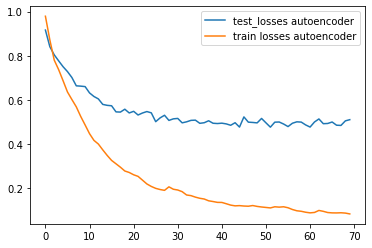

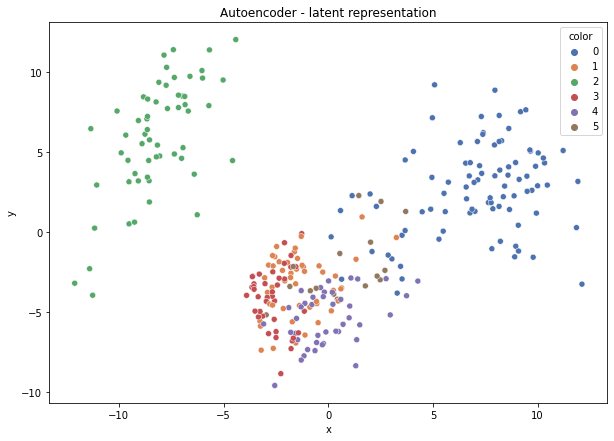

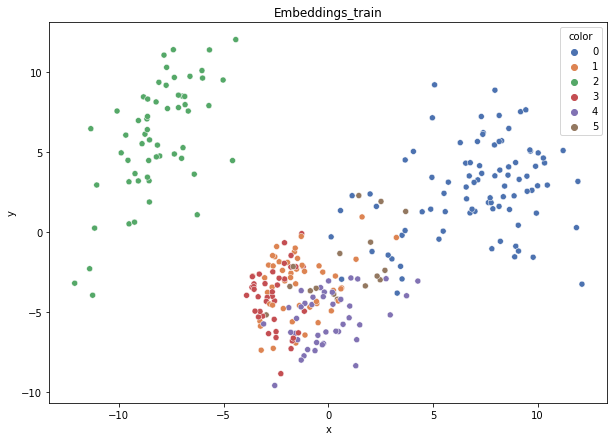

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.662
DT-f1-old+new-features: 0.935
DT-f1-old-features: 0.945
DT-gmean-new-features: 0.606
DT-gmean-old+new-features: 0.946
DT-gmean-old-features: 0.953
DT-minority_gmean-new-features: 0.022
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.895
KNN-f1-old+new-features: 0.937
KNN-f1-old-features: 0.906
KNN-gmean-new-features: 0.913
KNN-gmean-old+new-features: 0.939
KNN-gmean-old-features: 0.891
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


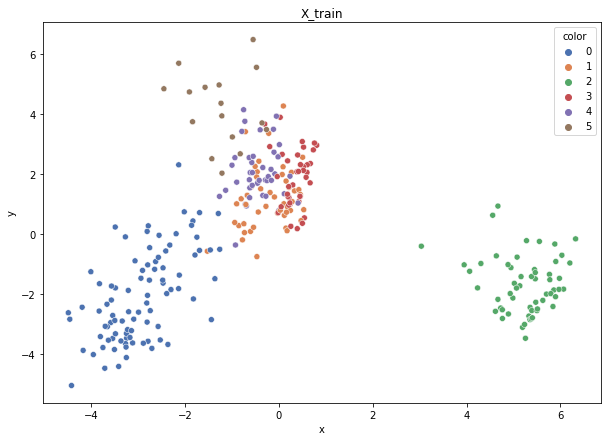

Class cardinalities: Counter({0: 90, 2: 57, 1: 49, 4: 42, 3: 39, 5: 16})
Weights: {1: 0.12674800566460384, 0: 0.06900724752850654, 2: 0.10895881188711559, 4: 0.14787267327537115, 3: 0.15924749429655355, 5: 0.3881657673478493}
Training autoencoder...


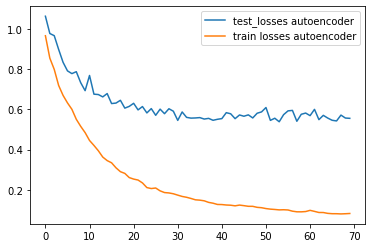

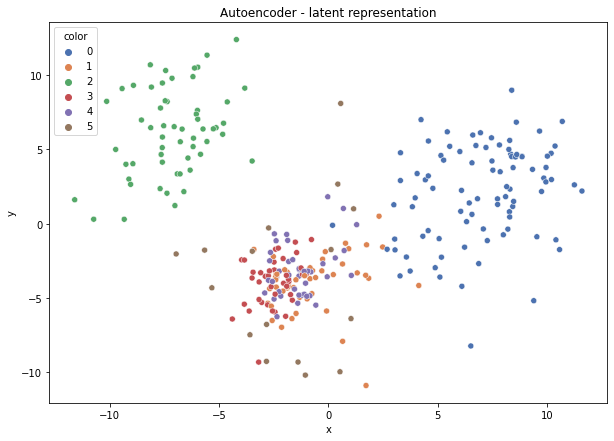

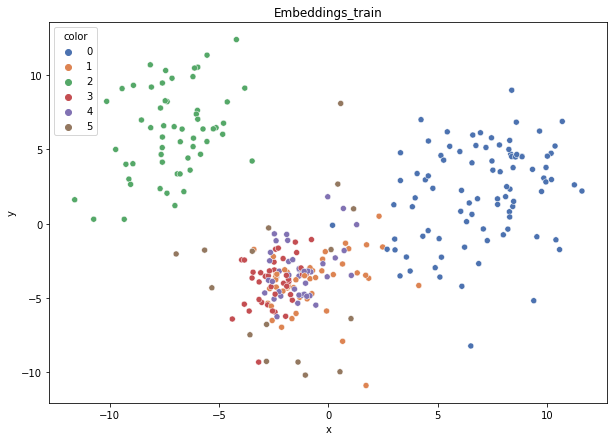

DT-f1-new-features: 0.611
DT-f1-old+new-features: 0.946
DT-f1-old-features: 0.946
DT-gmean-new-features: 0.523
DT-gmean-old+new-features: 0.945
DT-gmean-old-features: 0.945
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.927
KNN-f1-old+new-features: 0.926
KNN-f1-old-features: 0.939
KNN-gmean-new-features: 0.929
KNN-gmean-old+new-features: 0.926
KNN-gmean-old-features: 0.937
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


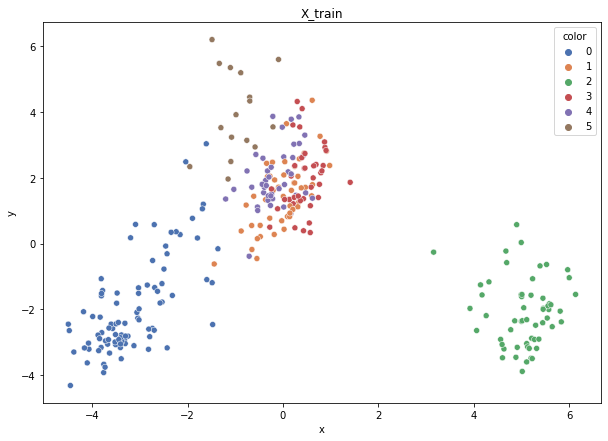

Class cardinalities: Counter({0: 90, 2: 57, 1: 49, 4: 42, 3: 39, 5: 16})
Weights: {1: 0.12674800566460384, 0: 0.06900724752850654, 2: 0.10895881188711559, 3: 0.15924749429655355, 4: 0.14787267327537115, 5: 0.3881657673478493}
Training autoencoder...


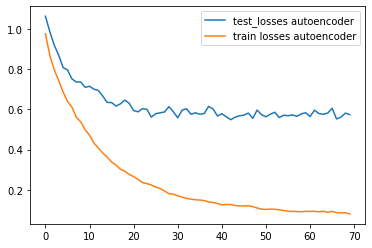

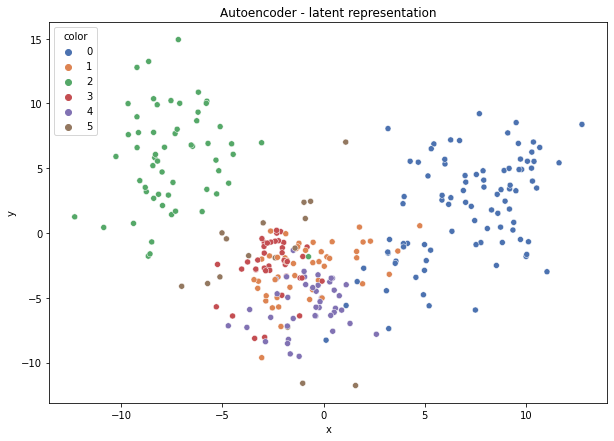

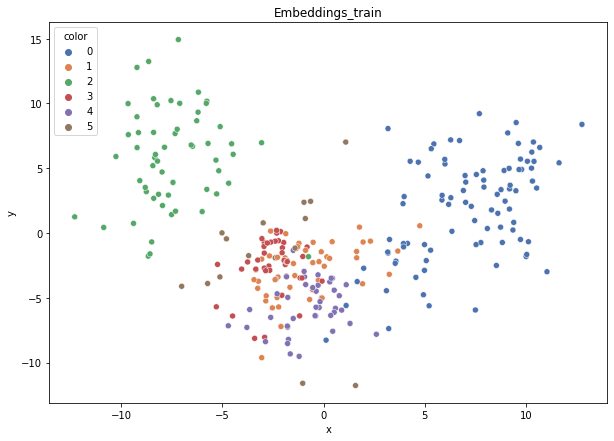

DT-f1-new-features: 0.776
DT-f1-old+new-features: 0.974
DT-f1-old-features: 0.989
DT-gmean-new-features: 0.756
DT-gmean-old+new-features: 0.978
DT-gmean-old-features: 0.992
DT-minority_gmean-new-features: 0.027
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.943
KNN-f1-old+new-features: 0.939
KNN-f1-old-features: 0.944
KNN-gmean-new-features: 0.953
KNN-gmean-old+new-features: 0.947
KNN-gmean-old-features: 0.942
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0
hayes-roth


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


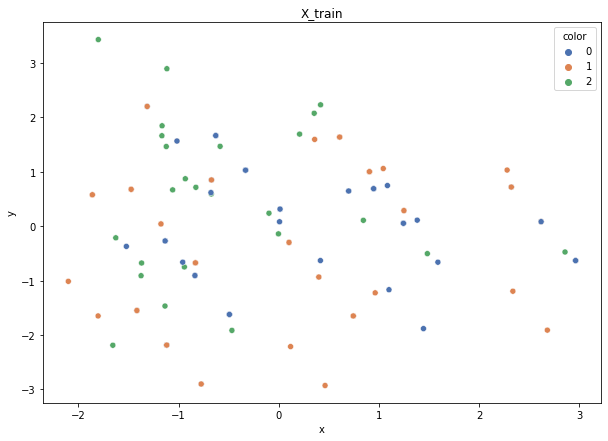

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {0: 0.243925770040176, 1: 0.24870862827625786, 2: 0.507365601683566}
Training autoencoder...


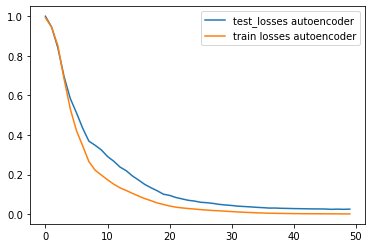

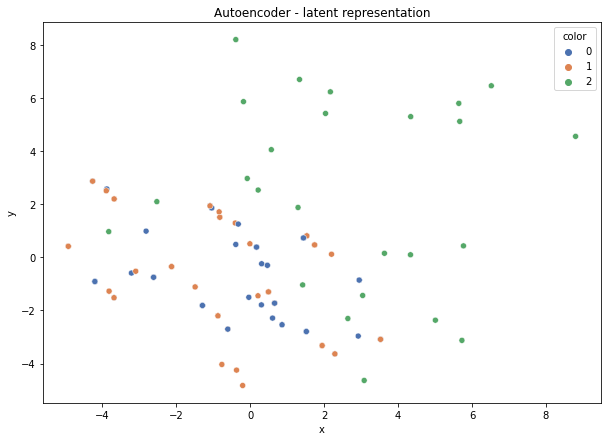

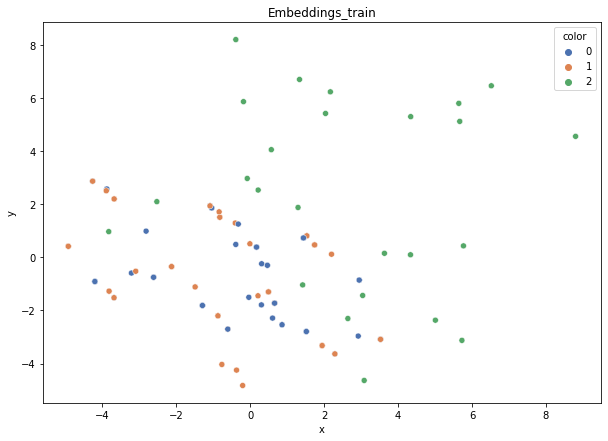

DT-f1-new-features: 0.867
DT-f1-old+new-features: 0.814
DT-f1-old-features: 0.842
DT-gmean-new-features: 0.851
DT-gmean-old+new-features: 0.792
DT-gmean-old-features: 0.828
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.806
KNN-f1-old+new-features: 0.845
KNN-f1-old-features: 0.733
KNN-gmean-new-features: 0.787
KNN-gmean-old+new-features: 0.837
KNN-gmean-old-features: 0.688
KNN-minority_gmean-new-features: 0.029
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 0.022


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


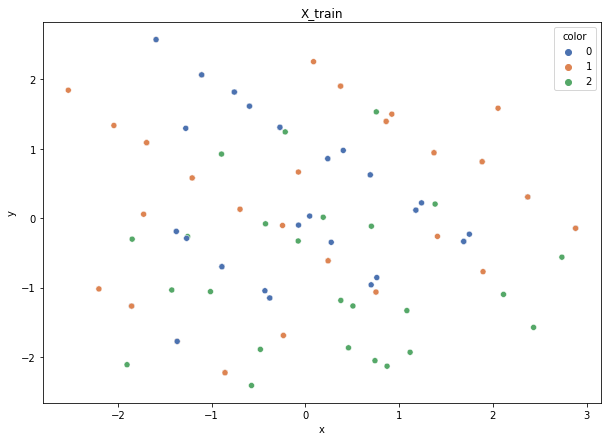

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {0: 0.243925770040176, 1: 0.24870862827625786, 2: 0.507365601683566}
Training autoencoder...


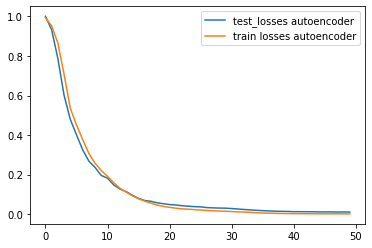

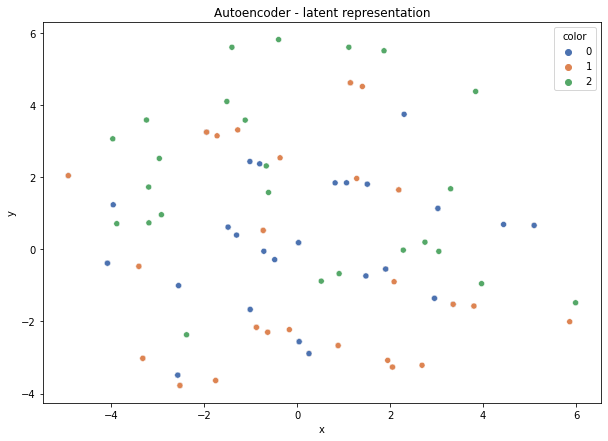

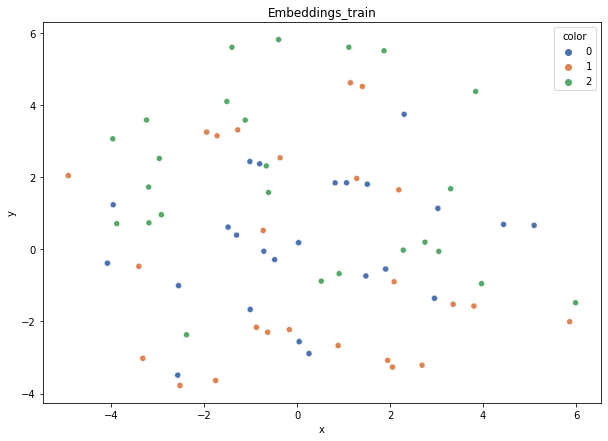

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.845
DT-f1-old+new-features: 0.872
DT-f1-old-features: 0.872
DT-gmean-new-features: 0.837
DT-gmean-old+new-features: 0.867
DT-gmean-old-features: 0.867
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.845
KNN-f1-old+new-features: 0.845
KNN-f1-old-features: 0.643
KNN-gmean-new-features: 0.837
KNN-gmean-old+new-features: 0.837
KNN-gmean-old-features: 0.619
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 0.008


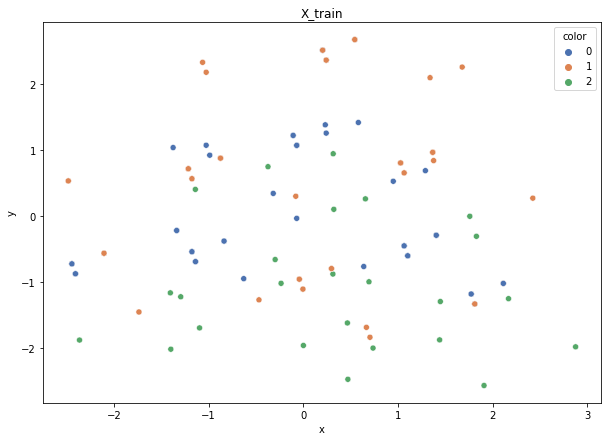

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {0: 0.243925770040176, 1: 0.24870862827625786, 2: 0.507365601683566}
Training autoencoder...


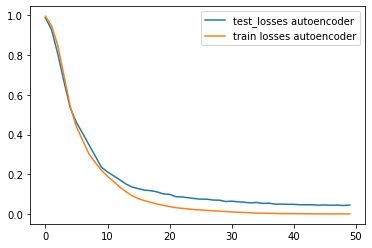

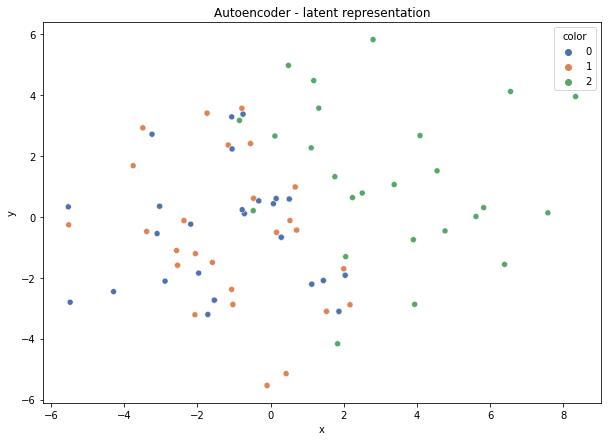

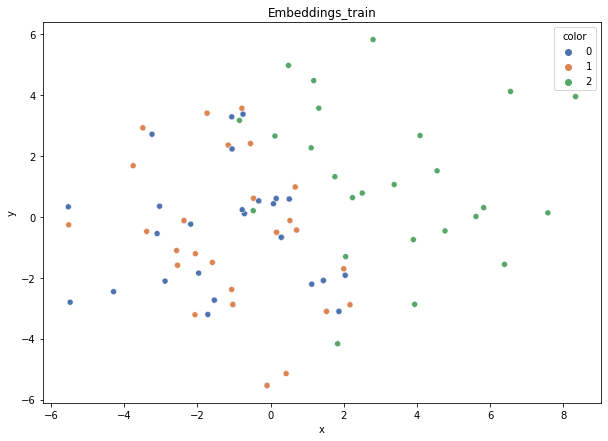

DT-f1-new-features: 0.866
DT-f1-old+new-features: 0.836
DT-f1-old-features: 0.923
DT-gmean-new-features: 0.862
DT-gmean-old+new-features: 0.805
DT-gmean-old-features: 0.921
DT-minority_gmean-new-features: 0.029
DT-minority_gmean-old+new-features: 0.026
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.872
KNN-f1-old+new-features: 0.872
KNN-f1-old-features: 0.836
KNN-gmean-new-features: 0.867
KNN-gmean-old+new-features: 0.867
KNN-gmean-old-features: 0.805
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 0.026


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


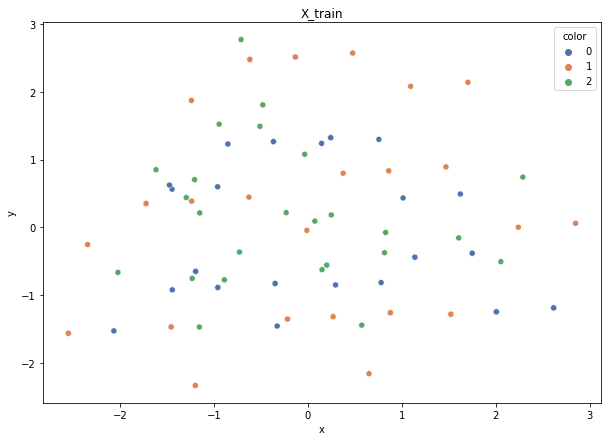

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {1: 0.24870862827625786, 2: 0.507365601683566, 0: 0.243925770040176}
Training autoencoder...


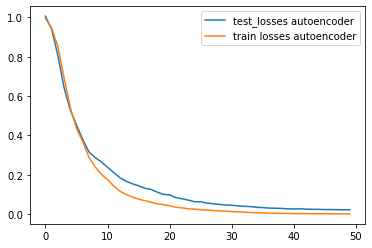

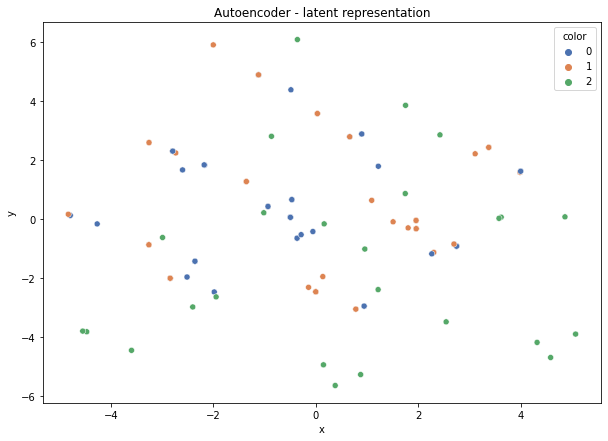

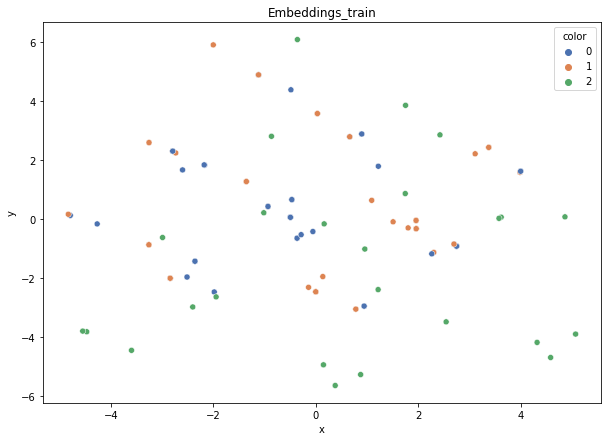

DT-f1-new-features: 0.691
DT-f1-old+new-features: 0.804
DT-f1-old-features: 0.897
DT-gmean-new-features: 0.708
DT-gmean-old+new-features: 0.811
DT-gmean-old-features: 0.892
DT-minority_gmean-new-features: 0.029
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.756
KNN-f1-old+new-features: 0.756
KNN-f1-old-features: 0.594
KNN-gmean-new-features: 0.736
KNN-gmean-old+new-features: 0.736
KNN-gmean-old-features: 0.54
KNN-minority_gmean-new-features: 0.029
KNN-minority_gmean-old+new-features: 0.029
KNN-minority_gmean-old-features: 0.007


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

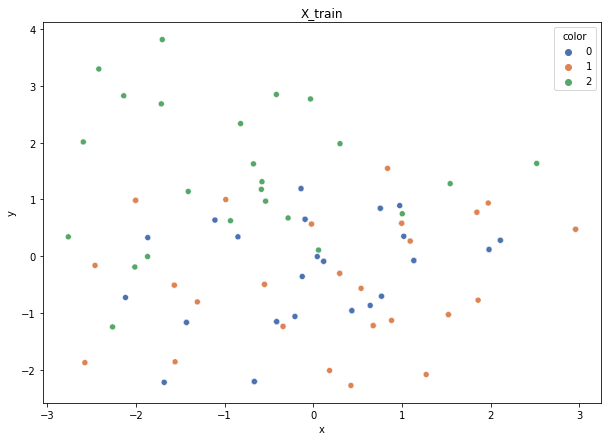

Class cardinalities: Counter({0: 52, 1: 52, 2: 24})
Weights: {0: 0.24000000000000005, 2: 0.52, 1: 0.24000000000000005}
Training autoencoder...


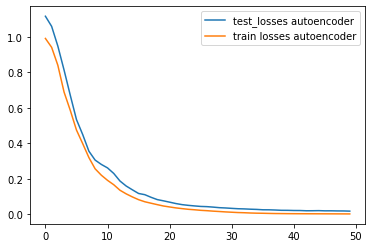

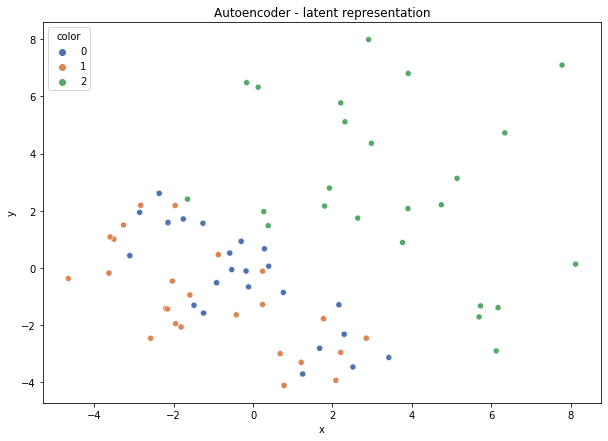

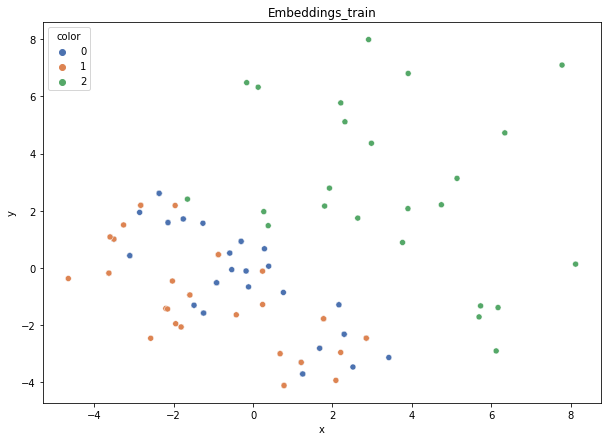

DT-f1-new-features: 0.7
DT-f1-old+new-features: 0.7
DT-f1-old-features: 0.722
DT-gmean-new-features: 0.675
DT-gmean-old+new-features: 0.675
DT-gmean-old-features: 0.684
DT-minority_gmean-new-features: 0.029
DT-minority_gmean-old+new-features: 0.029
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.758
KNN-f1-old+new-features: 0.758
KNN-f1-old-features: 0.555
KNN-gmean-new-features: 0.739
KNN-gmean-old+new-features: 0.739
KNN-gmean-old-features: 0.529
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 0.008
new_vehicle


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


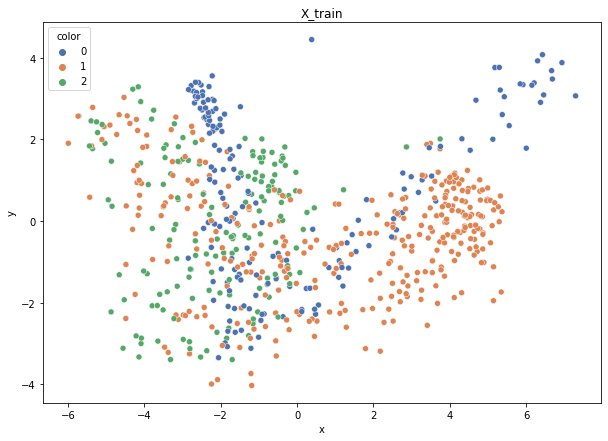

Class cardinalities: Counter({1: 343, 0: 174, 2: 159})
Weights: {2: 0.42063643091235864, 1: 0.19498889946083095, 0: 0.38437466962681044}
Training autoencoder...


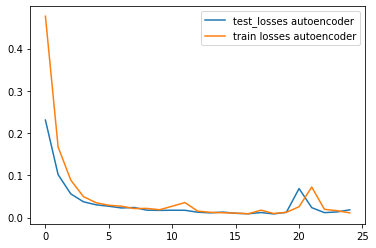

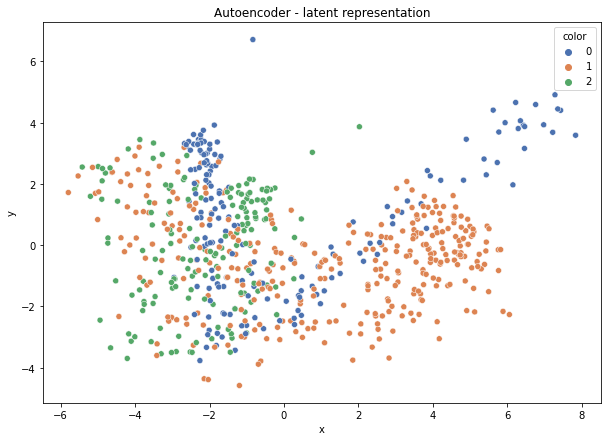

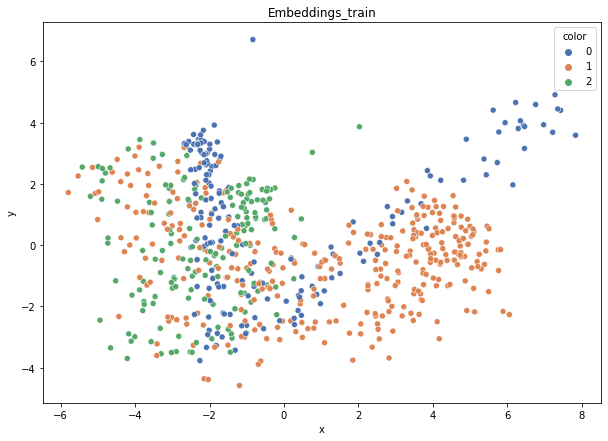

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.777
DT-f1-old+new-features: 0.844
DT-f1-old-features: 0.901
DT-gmean-new-features: 0.797
DT-gmean-old+new-features: 0.848
DT-gmean-old-features: 0.908
DT-minority_gmean-new-features: 0.088
DT-minority_gmean-old+new-features: 0.09
DT-minority_gmean-old-features: 0.094
KNN-f1-new-features: 0.867
KNN-f1-old+new-features: 0.882
KNN-f1-old-features: 0.889
KNN-gmean-new-features: 0.875
KNN-gmean-old+new-features: 0.891
KNN-gmean-old-features: 0.895
KNN-minority_gmean-new-features: 0.092
KNN-minority_gmean-old+new-features: 0.093
KNN-minority_gmean-old-features: 0.093


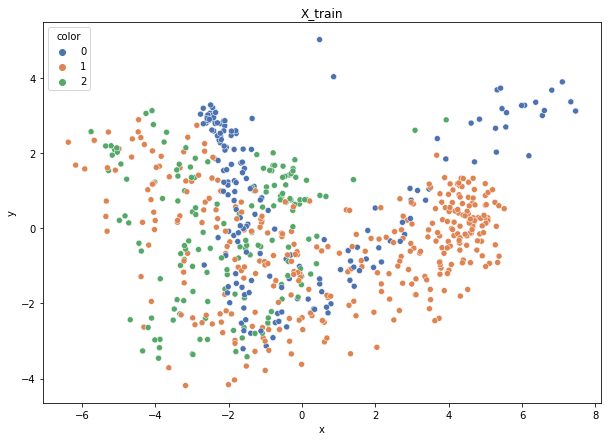

Class cardinalities: Counter({1: 343, 0: 175, 2: 159})
Weights: {2: 0.4215623617324616, 1: 0.19541812103633058, 0: 0.3830195172312079}
Training autoencoder...


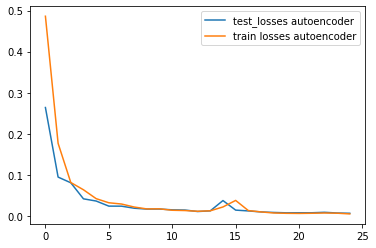

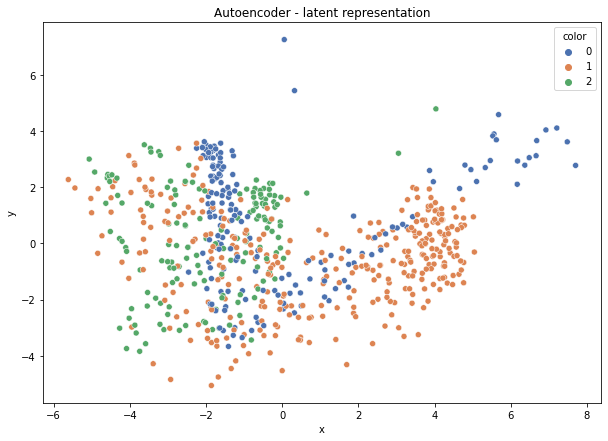

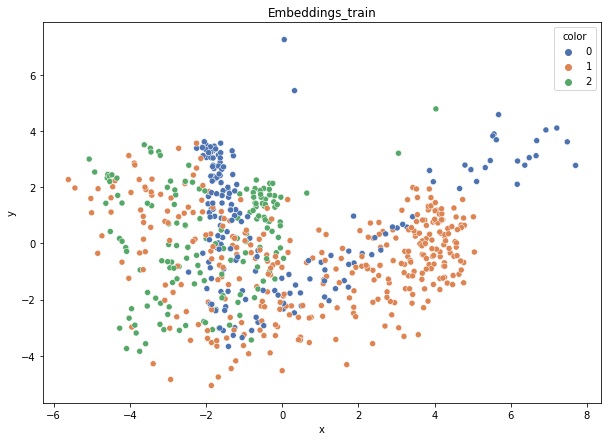

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.848
DT-f1-old+new-features: 0.858
DT-f1-old-features: 0.906
DT-gmean-new-features: 0.852
DT-gmean-old+new-features: 0.865
DT-gmean-old-features: 0.904
DT-minority_gmean-new-features: 0.089
DT-minority_gmean-old+new-features: 0.091
DT-minority_gmean-old-features: 0.093
KNN-f1-new-features: 0.958
KNN-f1-old+new-features: 0.924
KNN-f1-old-features: 0.9
KNN-gmean-new-features: 0.96
KNN-gmean-old+new-features: 0.928
KNN-gmean-old-features: 0.908
KNN-minority_gmean-new-features: 0.098
KNN-minority_gmean-old+new-features: 0.095
KNN-minority_gmean-old-features: 0.094


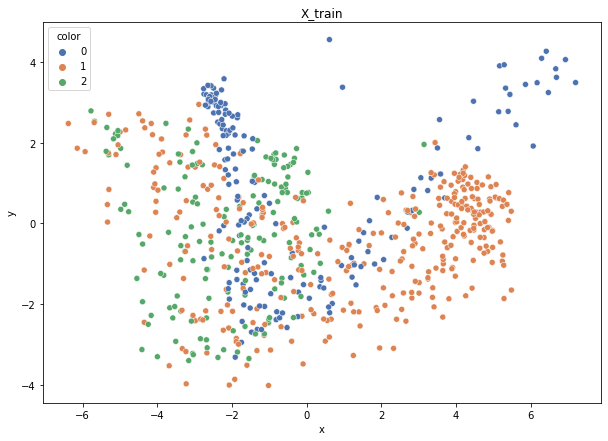

Class cardinalities: Counter({1: 343, 0: 175, 2: 159})
Weights: {2: 0.4215623617324616, 1: 0.19541812103633058, 0: 0.3830195172312079}
Training autoencoder...


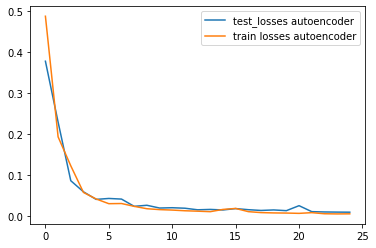

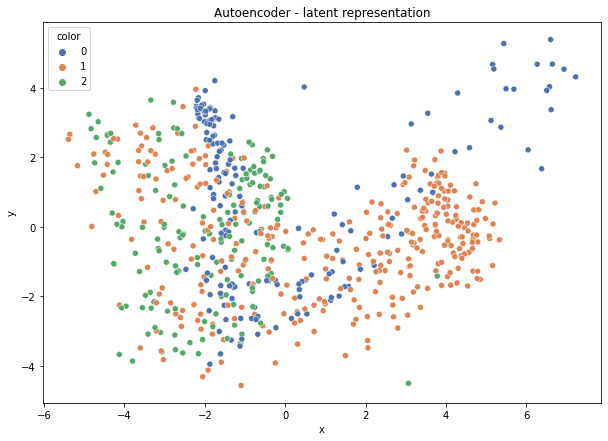

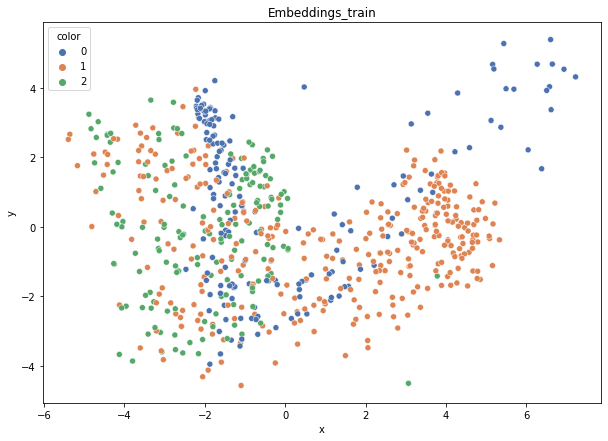

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.815
DT-f1-old+new-features: 0.769
DT-f1-old-features: 0.89
DT-gmean-new-features: 0.818
DT-gmean-old+new-features: 0.769
DT-gmean-old-features: 0.895
DT-minority_gmean-new-features: 0.086
DT-minority_gmean-old+new-features: 0.083
DT-minority_gmean-old-features: 0.093
KNN-f1-new-features: 0.904
KNN-f1-old+new-features: 0.919
KNN-f1-old-features: 0.899
KNN-gmean-new-features: 0.906
KNN-gmean-old+new-features: 0.914
KNN-gmean-old-features: 0.897
KNN-minority_gmean-new-features: 0.093
KNN-minority_gmean-old+new-features: 0.093
KNN-minority_gmean-old-features: 0.092


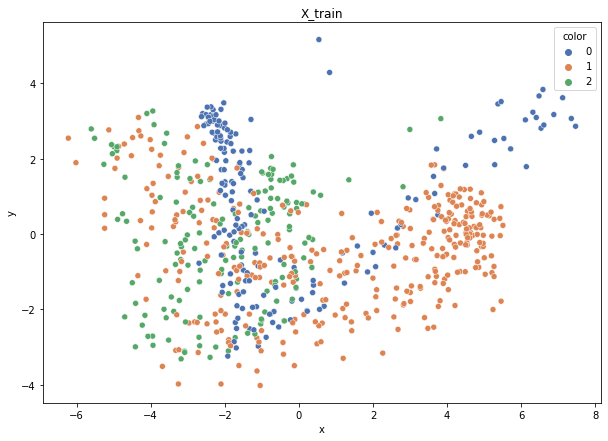

Class cardinalities: Counter({1: 344, 0: 174, 2: 159})
Weights: {2: 0.42087499472640594, 0: 0.3845926675948192, 1: 0.19453233767877484}
Training autoencoder...


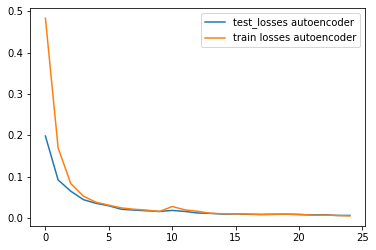

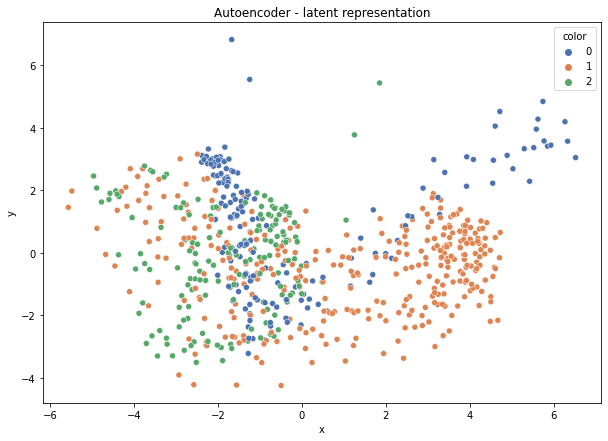

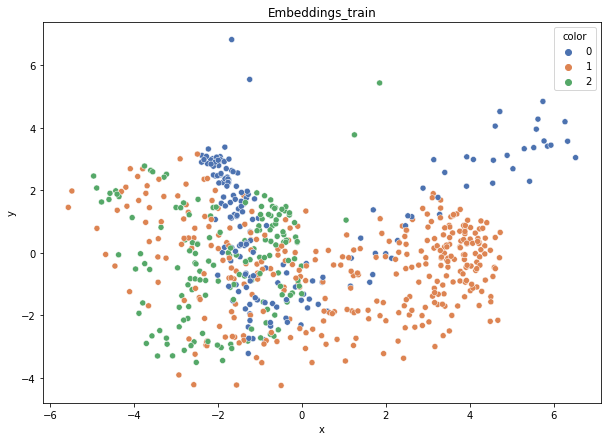

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.862
DT-f1-old+new-features: 0.885
DT-f1-old-features: 0.909
DT-gmean-new-features: 0.865
DT-gmean-old+new-features: 0.888
DT-gmean-old-features: 0.916
DT-minority_gmean-new-features: 0.09
DT-minority_gmean-old+new-features: 0.092
DT-minority_gmean-old-features: 0.095
KNN-f1-new-features: 0.928
KNN-f1-old+new-features: 0.936
KNN-f1-old-features: 0.937
KNN-gmean-new-features: 0.918
KNN-gmean-old+new-features: 0.922
KNN-gmean-old-features: 0.927
KNN-minority_gmean-new-features: 0.093
KNN-minority_gmean-old+new-features: 0.093
KNN-minority_gmean-old-features: 0.093


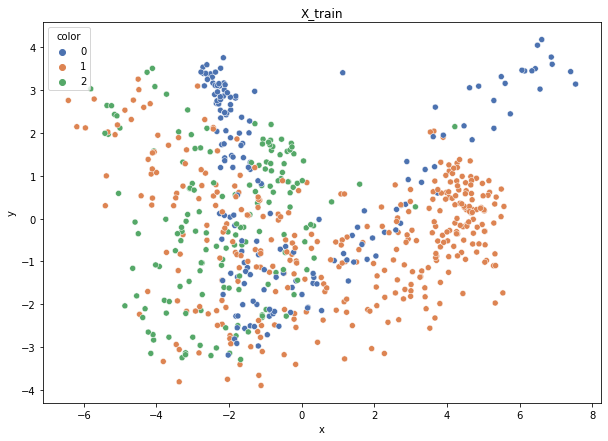

Class cardinalities: Counter({1: 343, 0: 174, 2: 160})
Weights: {2: 0.4191092821730032, 1: 0.19550287215067205, 0: 0.3853878456763248}
Training autoencoder...


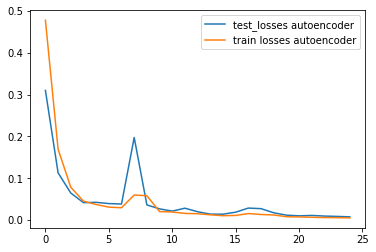

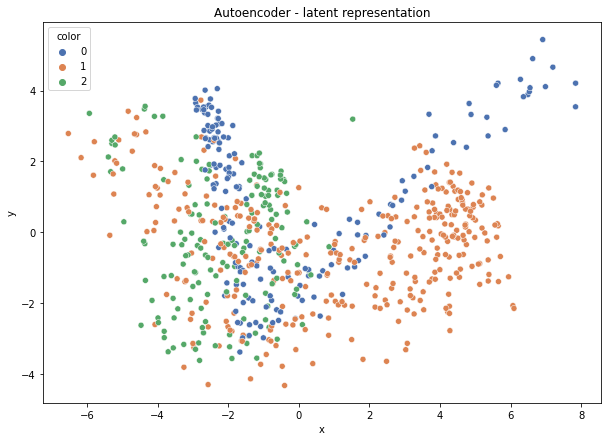

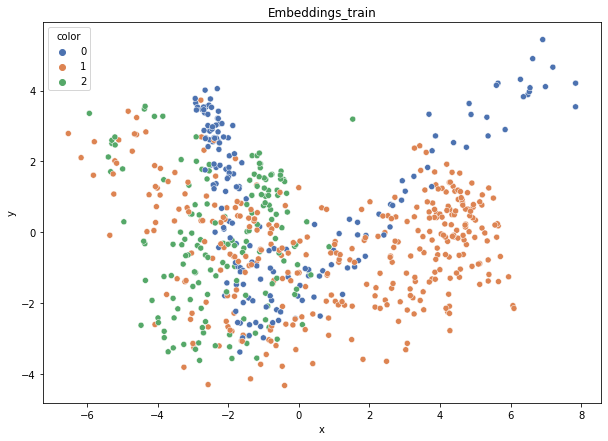

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.832
DT-f1-old+new-features: 0.896
DT-f1-old-features: 0.877
DT-gmean-new-features: 0.827
DT-gmean-old+new-features: 0.888
DT-gmean-old-features: 0.87
DT-minority_gmean-new-features: 0.085
DT-minority_gmean-old+new-features: 0.09
DT-minority_gmean-old-features: 0.09
KNN-f1-new-features: 0.935
KNN-f1-old+new-features: 0.94
KNN-f1-old-features: 0.937
KNN-gmean-new-features: 0.931
KNN-gmean-old+new-features: 0.94
KNN-gmean-old-features: 0.935
KNN-minority_gmean-new-features: 0.094
KNN-minority_gmean-old+new-features: 0.095
KNN-minority_gmean-old-features: 0.094
new_yeast


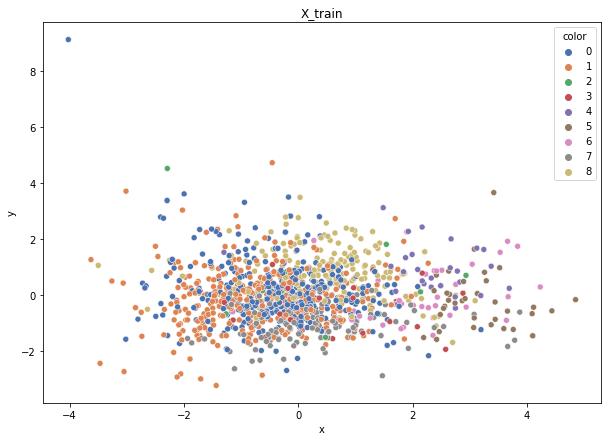

Class cardinalities: Counter({0: 370, 1: 343, 8: 195, 7: 135, 6: 40, 5: 36, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.024325906642526016, 0: 0.012820410257547495, 1: 0.013829597070823827, 5: 0.1317653276470159, 4: 0.16941256411759187, 6: 0.11858879488231433, 3: 0.19764799147052386, 7: 0.03513742070587091, 2: 0.2964719872057858}
Training autoencoder...


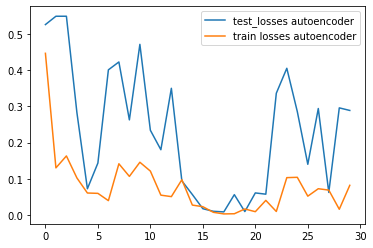

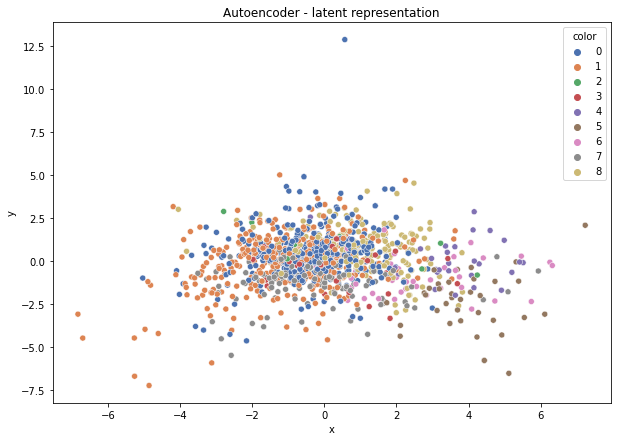

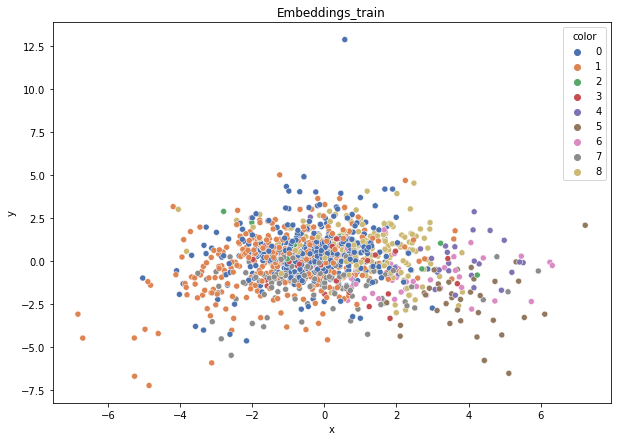

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.456
DT-f1-old+new-features: 0.442
DT-f1-old-features: 0.494
DT-gmean-new-features: 0.419
DT-gmean-old+new-features: 0.255
DT-gmean-old-features: 0.271
DT-minority_gmean-new-features: 0.027
DT-minority_gmean-old+new-features: 0.016
DT-minority_gmean-old-features: 0.016
KNN-f1-new-features: 0.534
KNN-f1-old+new-features: 0.542
KNN-f1-old-features: 0.545
KNN-gmean-new-features: 0.507
KNN-gmean-old+new-features: 0.511
KNN-gmean-old-features: 0.51
KNN-minority_gmean-new-features: 0.03
KNN-minority_gmean-old+new-features: 0.03
KNN-minority_gmean-old-features: 0.03


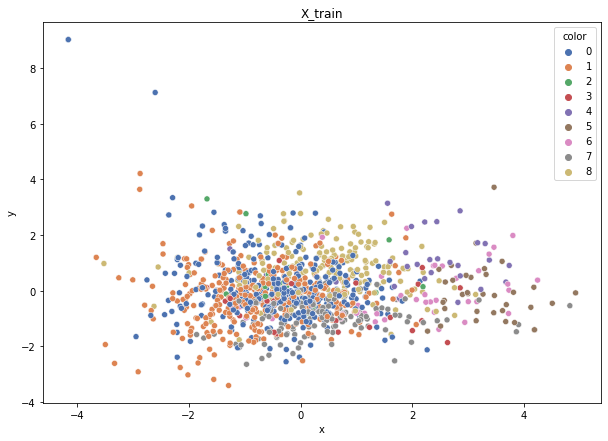

Class cardinalities: Counter({0: 371, 1: 343, 8: 195, 7: 134, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {1: 0.013814401543936261, 8: 0.02429917810035968, 0: 0.012771805200997676, 5: 0.13538113513057534, 6: 0.11556926169683263, 7: 0.035360744250523414, 3: 0.1974308220654224, 4: 0.16922641891321918, 2: 0.2961462330981336}
Training autoencoder...


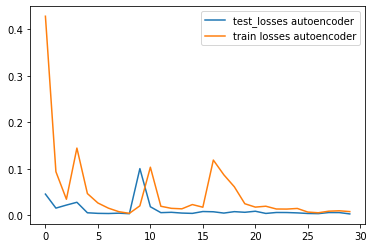

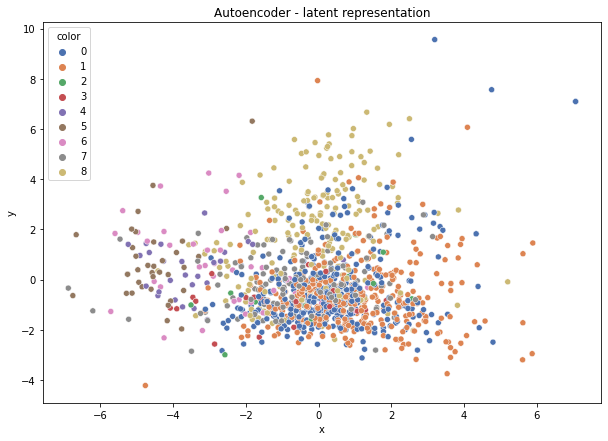

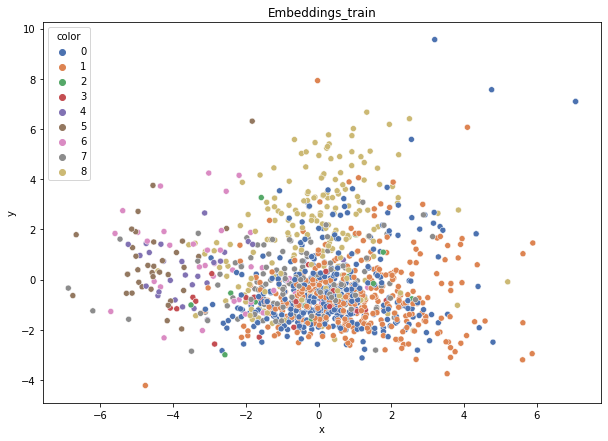

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.416
DT-f1-old+new-features: 0.467
DT-f1-old-features: 0.451
DT-gmean-new-features: 0.239
DT-gmean-old+new-features: 0.264
DT-gmean-old-features: 0.26
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.016
DT-minority_gmean-old-features: 0.016
KNN-f1-new-features: 0.504
KNN-f1-old+new-features: 0.502
KNN-f1-old-features: 0.494
KNN-gmean-new-features: 0.275
KNN-gmean-old+new-features: 0.275
KNN-gmean-old-features: 0.268
KNN-minority_gmean-new-features: 0.024
KNN-minority_gmean-old+new-features: 0.024
KNN-minority_gmean-old-features: 0.023


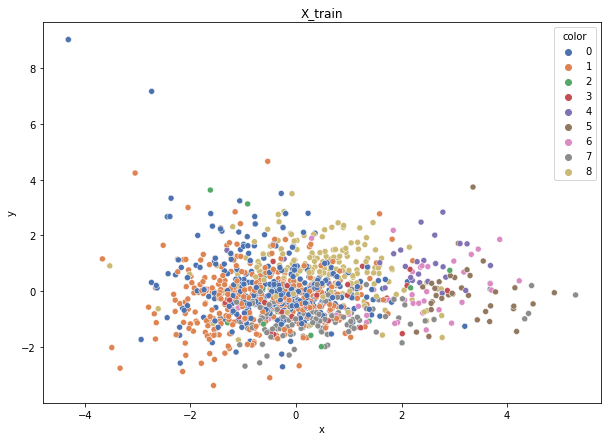

Class cardinalities: Counter({0: 371, 1: 343, 8: 195, 7: 134, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.024299178100359677, 1: 0.01381440154393626, 0: 0.012771805200997674, 5: 0.13538113513057534, 4: 0.16922641891321916, 6: 0.11556926169683261, 7: 0.03536074425052341, 3: 0.19743082206542237, 2: 0.29614623309813354}
Training autoencoder...


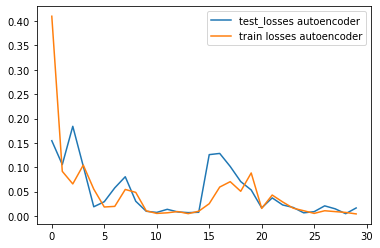

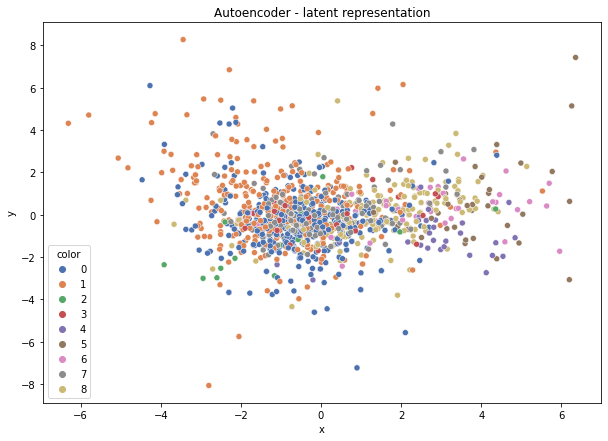

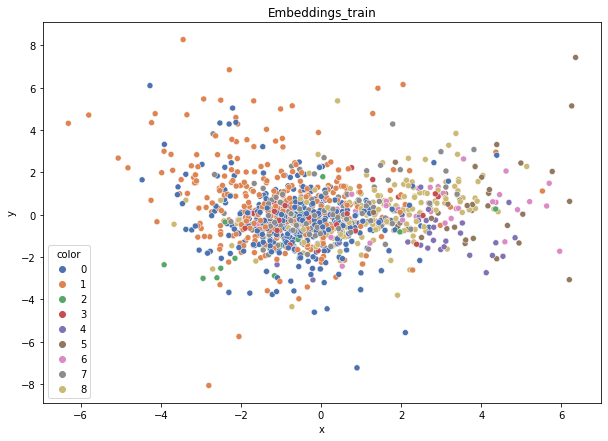

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.395
DT-f1-old+new-features: 0.425
DT-f1-old-features: 0.407
DT-gmean-new-features: 0.221
DT-gmean-old+new-features: 0.414
DT-gmean-old-features: 0.401
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.026
DT-minority_gmean-old-features: 0.026
KNN-f1-new-features: 0.441
KNN-f1-old+new-features: 0.447
KNN-f1-old-features: 0.451
KNN-gmean-new-features: 0.412
KNN-gmean-old+new-features: 0.415
KNN-gmean-old-features: 0.422
KNN-minority_gmean-new-features: 0.026
KNN-minority_gmean-old+new-features: 0.026
KNN-minority_gmean-old-features: 0.026


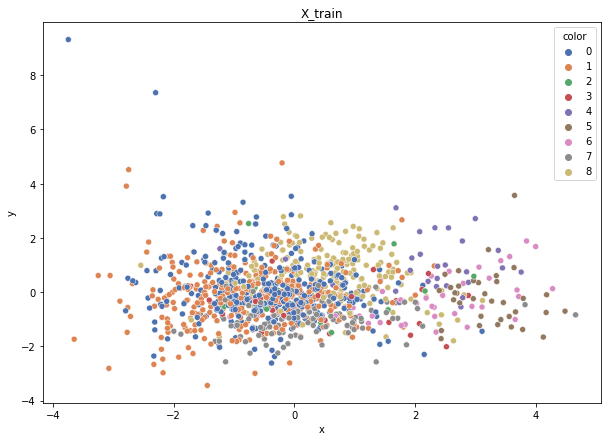

Class cardinalities: Counter({0: 370, 1: 344, 8: 195, 7: 134, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.024299315142460837, 1: 0.013774321083662392, 0: 0.012806395818323955, 5: 0.13538189865085323, 4: 0.16922737331356652, 6: 0.11556991348243568, 7: 0.03536094367746166, 3: 0.1974319355324943, 2: 0.29614790329874147}
Training autoencoder...


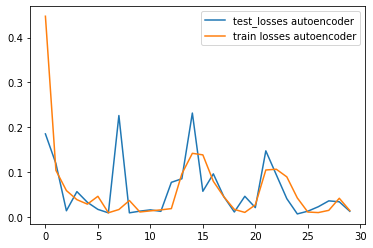

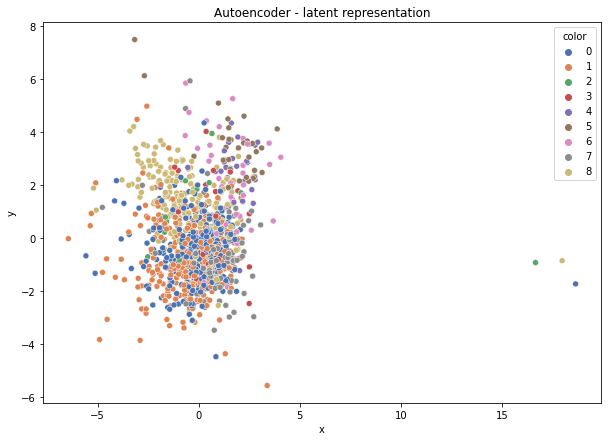

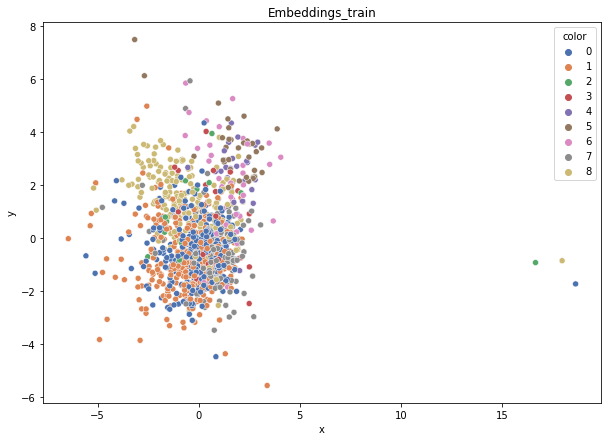

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.391
DT-f1-old+new-features: 0.388
DT-f1-old-features: 0.437
DT-gmean-new-features: 0.227
DT-gmean-old+new-features: 0.228
DT-gmean-old-features: 0.247
DT-minority_gmean-new-features: 0.015
DT-minority_gmean-old+new-features: 0.015
DT-minority_gmean-old-features: 0.016
KNN-f1-new-features: 0.51
KNN-f1-old+new-features: 0.497
KNN-f1-old-features: 0.492
KNN-gmean-new-features: 0.447
KNN-gmean-old+new-features: 0.435
KNN-gmean-old-features: 0.439
KNN-minority_gmean-new-features: 0.041
KNN-minority_gmean-old+new-features: 0.04
KNN-minority_gmean-old-features: 0.027


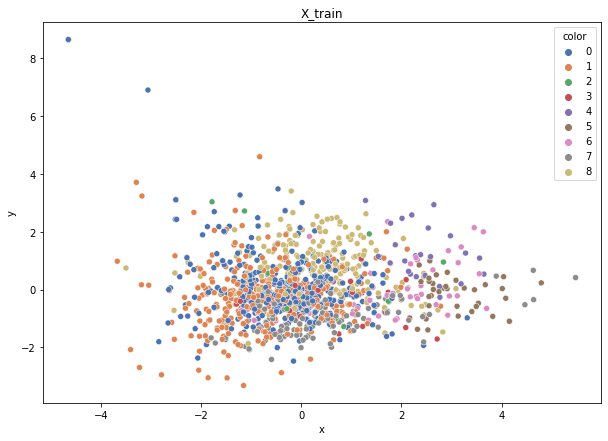

Class cardinalities: Counter({0: 370, 1: 343, 8: 196, 7: 135, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.02418370057482606, 1: 0.013819257471329179, 0: 0.012810825169367322, 5: 0.13542872321902596, 4: 0.16928590402378244, 6: 0.11560988567477826, 7: 0.035111150464191915, 3: 0.1975002213610795, 2: 0.29625033204161927}
Training autoencoder...


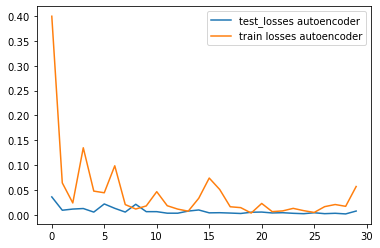

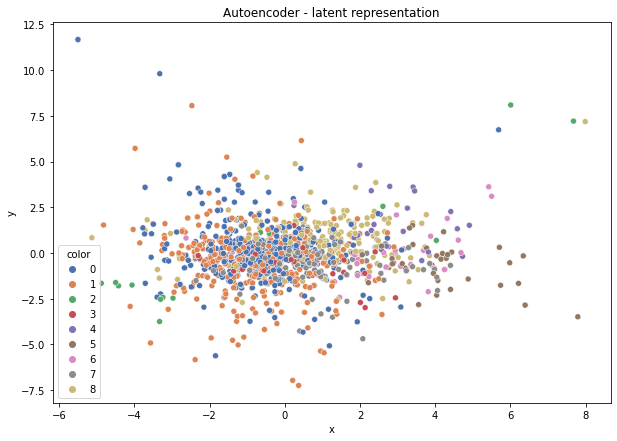

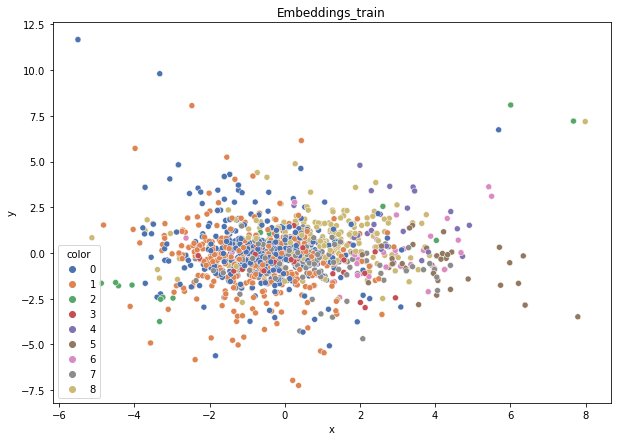

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.38
DT-f1-old+new-features: 0.393
DT-f1-old-features: 0.423
DT-gmean-new-features: 0.21
DT-gmean-old+new-features: 0.213
DT-gmean-old-features: 0.236
DT-minority_gmean-new-features: 0.013
DT-minority_gmean-old+new-features: 0.013
DT-minority_gmean-old-features: 0.014
KNN-f1-new-features: 0.452
KNN-f1-old+new-features: 0.464
KNN-f1-old-features: 0.452
KNN-gmean-new-features: 0.393
KNN-gmean-old+new-features: 0.403
KNN-gmean-old-features: 0.403
KNN-minority_gmean-new-features: 0.024
KNN-minority_gmean-old+new-features: 0.025
KNN-minority_gmean-old-features: 0.025
1czysty-cut


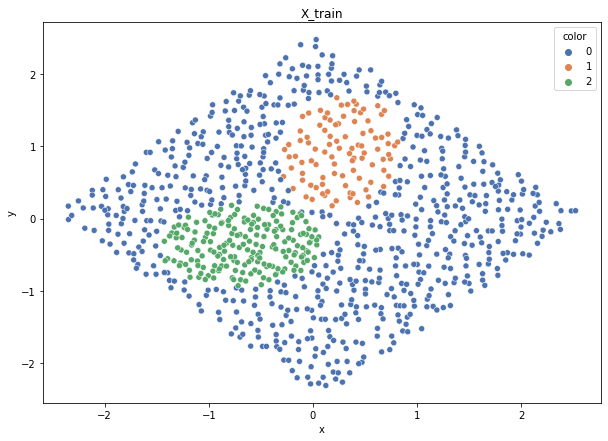

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


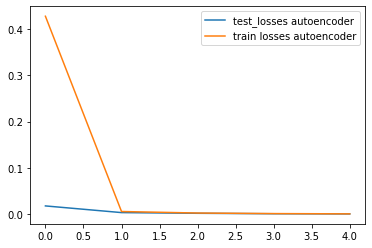

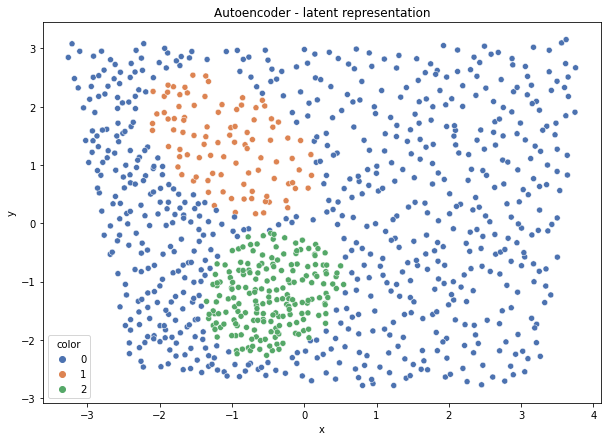

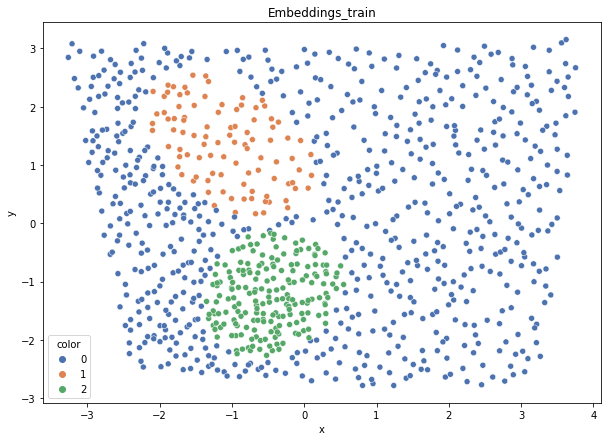

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.955
DT-f1-old+new-features: 0.955
DT-f1-old-features: 0.901
DT-gmean-new-features: 0.947
DT-gmean-old+new-features: 0.947
DT-gmean-old-features: 0.889
DT-minority_gmean-new-features: 0.095
DT-minority_gmean-old+new-features: 0.095
DT-minority_gmean-old-features: 0.09
KNN-f1-new-features: 0.93
KNN-f1-old+new-features: 0.937
KNN-f1-old-features: 0.937
KNN-gmean-new-features: 0.939
KNN-gmean-old+new-features: 0.941
KNN-gmean-old-features: 0.941
KNN-minority_gmean-new-features: 0.095
KNN-minority_gmean-old+new-features: 0.095
KNN-minority_gmean-old-features: 0.095


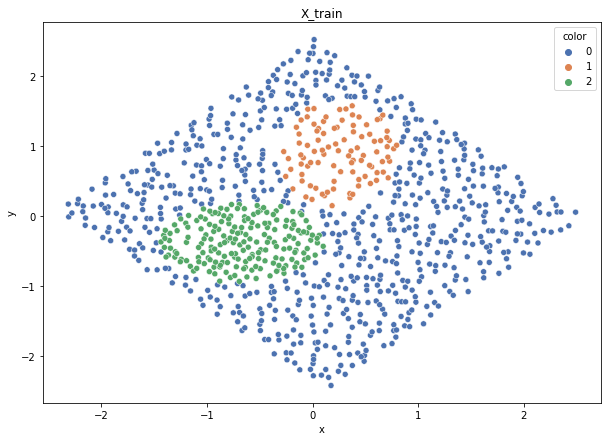

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


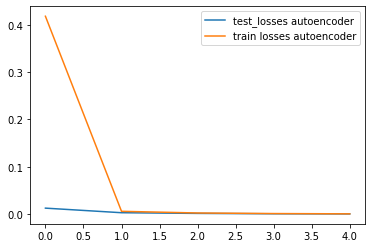

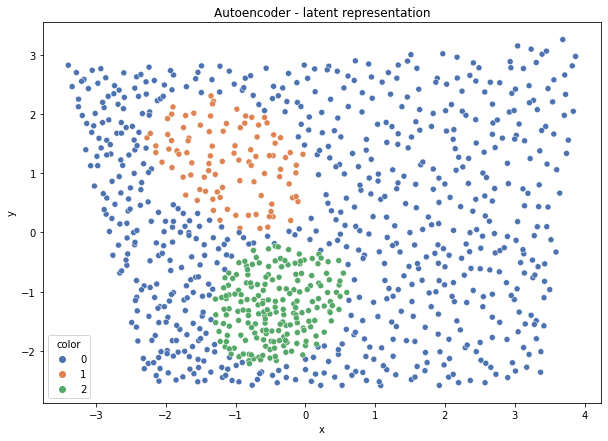

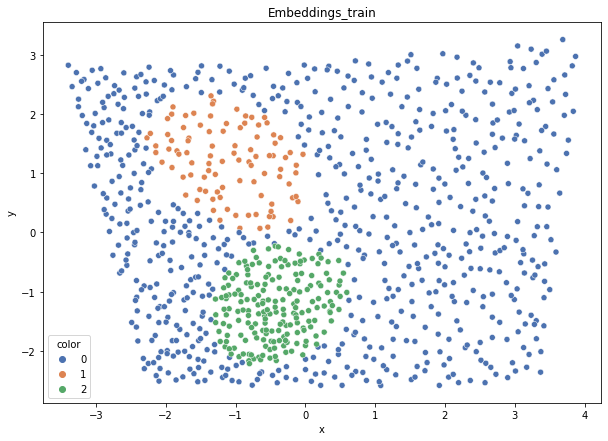

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.957
DT-f1-old+new-features: 0.962
DT-f1-old-features: 0.929
DT-gmean-new-features: 0.933
DT-gmean-old+new-features: 0.946
DT-gmean-old-features: 0.928
DT-minority_gmean-new-features: 0.093
DT-minority_gmean-old+new-features: 0.095
DT-minority_gmean-old-features: 0.094
KNN-f1-new-features: 0.945
KNN-f1-old+new-features: 0.945
KNN-f1-old-features: 0.945
KNN-gmean-new-features: 0.934
KNN-gmean-old+new-features: 0.934
KNN-gmean-old-features: 0.934
KNN-minority_gmean-new-features: 0.094
KNN-minority_gmean-old+new-features: 0.094
KNN-minority_gmean-old-features: 0.094


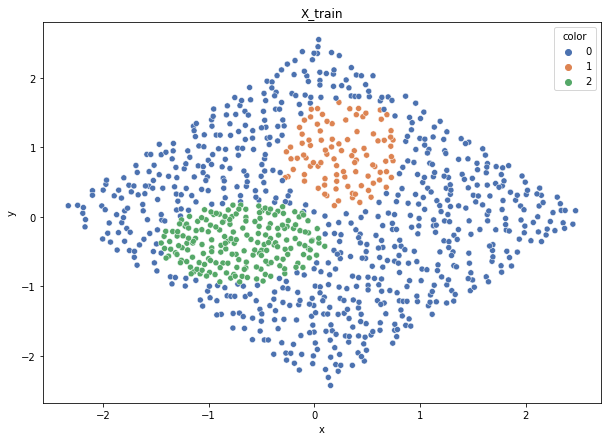

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


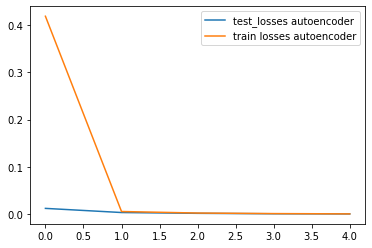

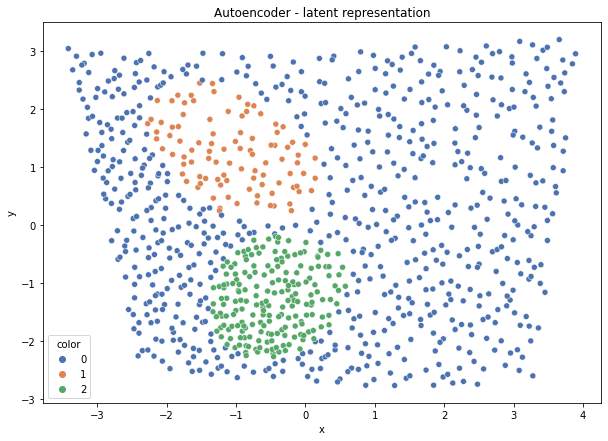

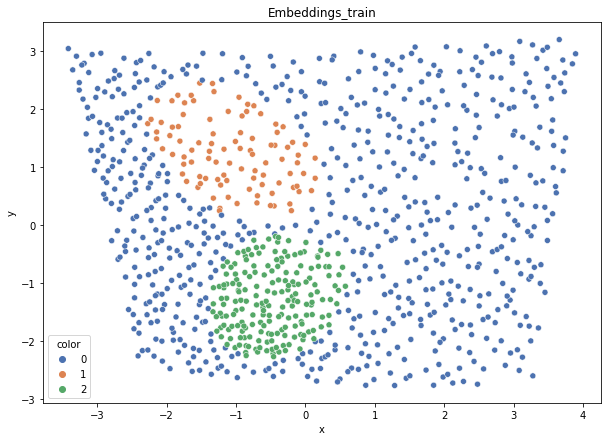

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.996
DT-f1-old+new-features: 0.996
DT-f1-old-features: 0.942
DT-gmean-new-features: 0.998
DT-gmean-old+new-features: 0.998
DT-gmean-old-features: 0.934
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 0.094
KNN-f1-new-features: 0.961
KNN-f1-old+new-features: 0.961
KNN-f1-old-features: 0.957
KNN-gmean-new-features: 0.934
KNN-gmean-old+new-features: 0.934
KNN-gmean-old-features: 0.933
KNN-minority_gmean-new-features: 0.093
KNN-minority_gmean-old+new-features: 0.093
KNN-minority_gmean-old-features: 0.093


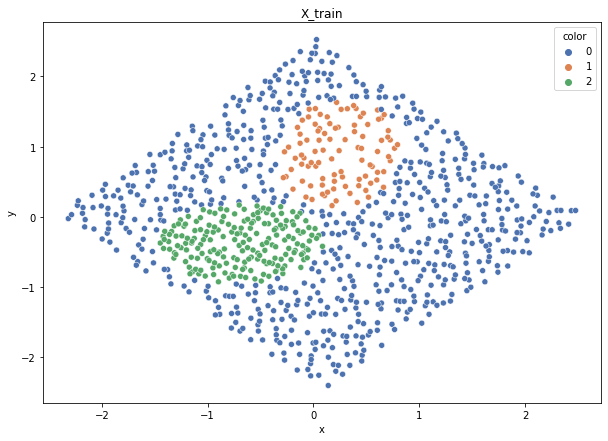

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


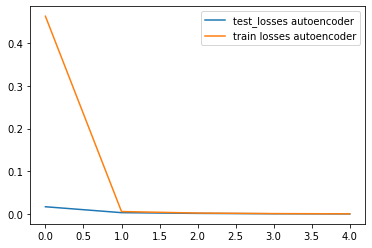

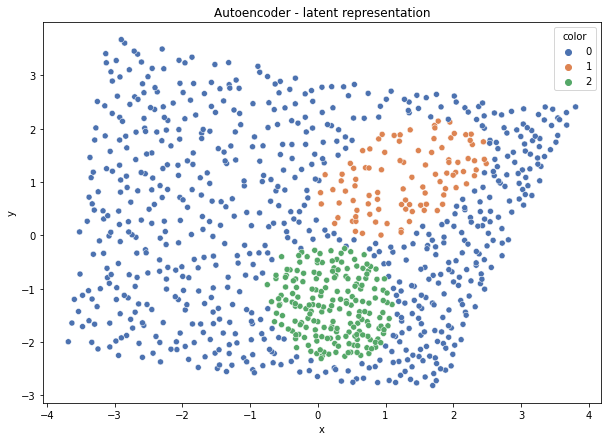

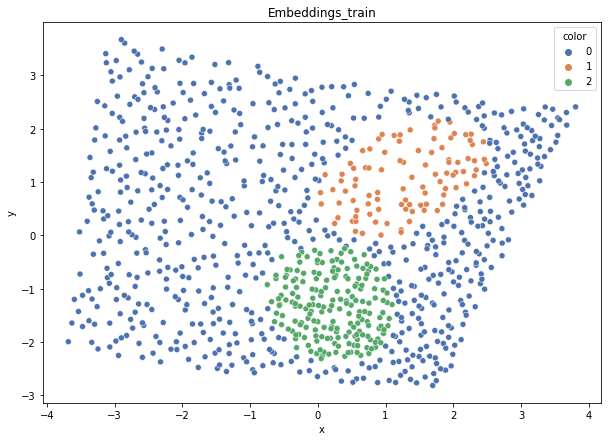

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.946
DT-f1-old+new-features: 0.946
DT-f1-old-features: 0.932
DT-gmean-new-features: 0.972
DT-gmean-old+new-features: 0.977
DT-gmean-old-features: 0.959
DT-minority_gmean-new-features: 0.099
DT-minority_gmean-old+new-features: 0.099
DT-minority_gmean-old-features: 0.098
KNN-f1-new-features: 0.939
KNN-f1-old+new-features: 0.935
KNN-f1-old-features: 0.931
KNN-gmean-new-features: 0.961
KNN-gmean-old+new-features: 0.959
KNN-gmean-old-features: 0.957
KNN-minority_gmean-new-features: 0.098
KNN-minority_gmean-old+new-features: 0.098
KNN-minority_gmean-old-features: 0.098


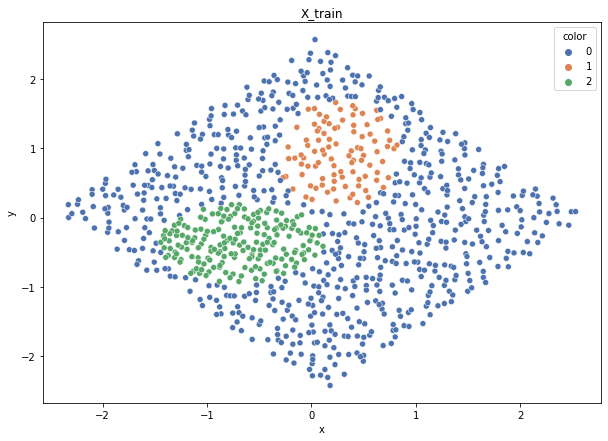

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


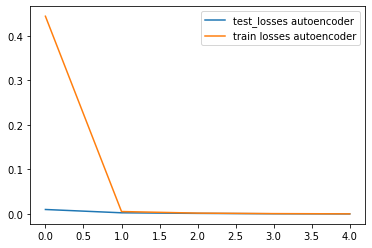

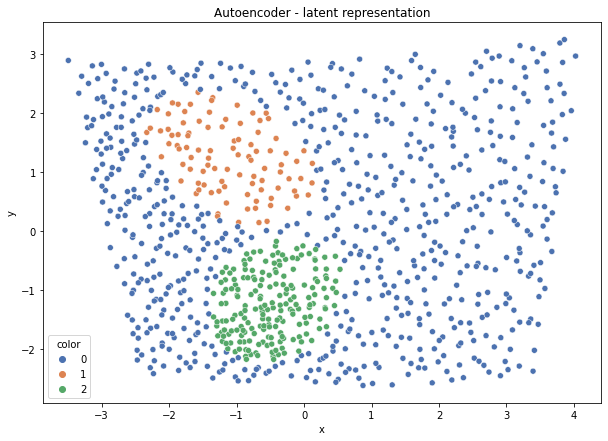

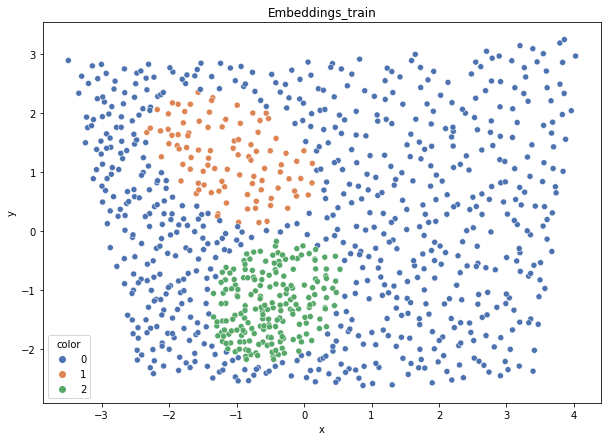

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.963
DT-f1-old+new-features: 0.953
DT-f1-old-features: 0.973
DT-gmean-new-features: 0.964
DT-gmean-old+new-features: 0.945
DT-gmean-old-features: 0.973
DT-minority_gmean-new-features: 0.097
DT-minority_gmean-old+new-features: 0.095
DT-minority_gmean-old-features: 0.098
KNN-f1-new-features: 0.949
KNN-f1-old+new-features: 0.949
KNN-f1-old-features: 0.958
KNN-gmean-new-features: 0.94
KNN-gmean-old+new-features: 0.94
KNN-gmean-old-features: 0.955
KNN-minority_gmean-new-features: 0.095
KNN-minority_gmean-old+new-features: 0.095
KNN-minority_gmean-old-features: 0.096
2delikatne-cut


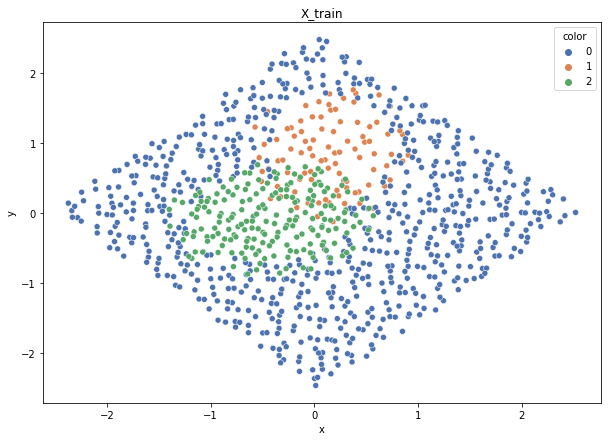

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


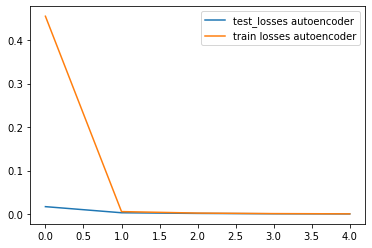

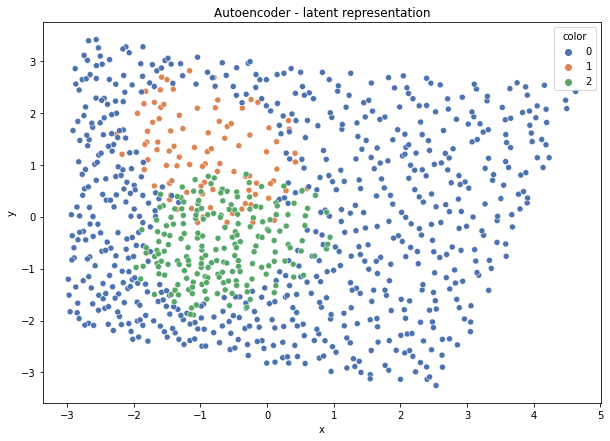

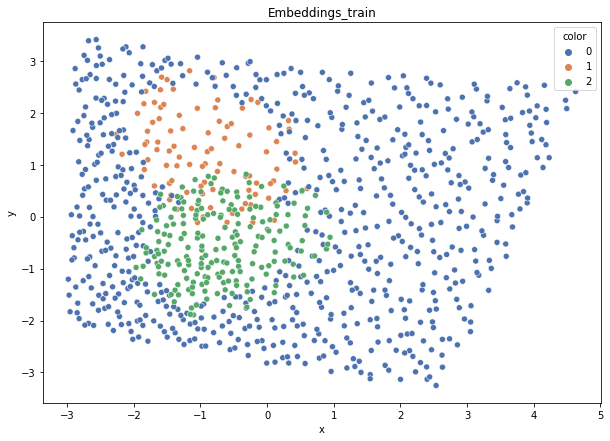

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.75
DT-f1-old+new-features: 0.785
DT-f1-old-features: 0.69
DT-gmean-new-features: 0.743
DT-gmean-old+new-features: 0.779
DT-gmean-old-features: 0.674
DT-minority_gmean-new-features: 0.077
DT-minority_gmean-old+new-features: 0.08
DT-minority_gmean-old-features: 0.07
KNN-f1-new-features: 0.671
KNN-f1-old+new-features: 0.671
KNN-f1-old-features: 0.693
KNN-gmean-new-features: 0.646
KNN-gmean-old+new-features: 0.646
KNN-gmean-old-features: 0.674
KNN-minority_gmean-new-features: 0.067
KNN-minority_gmean-old+new-features: 0.067
KNN-minority_gmean-old-features: 0.07


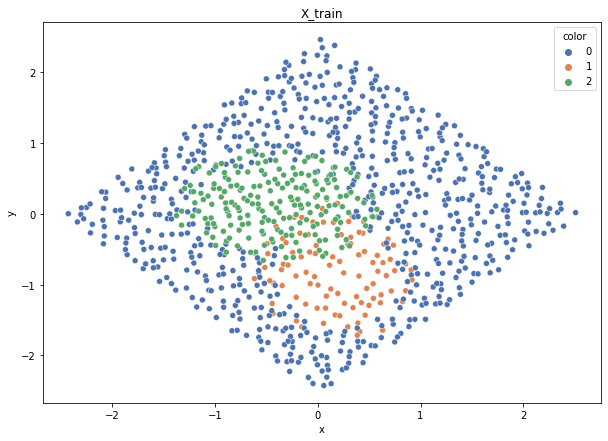

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


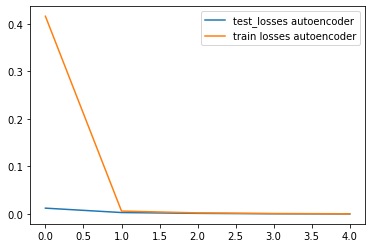

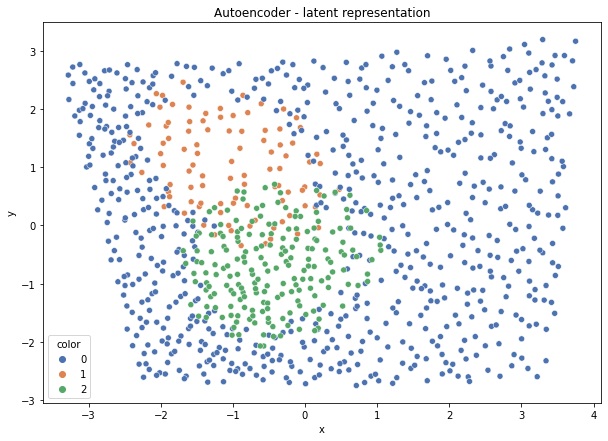

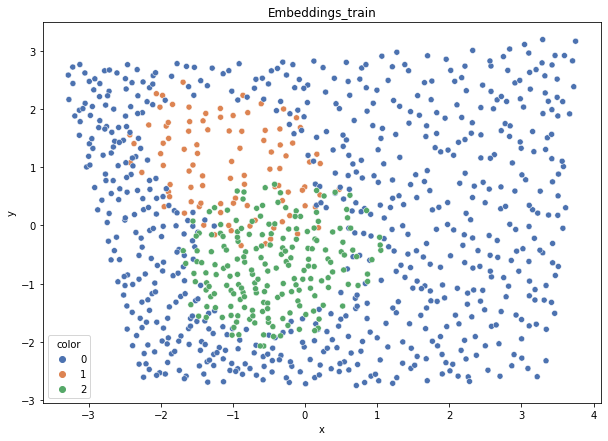

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.752
DT-f1-old+new-features: 0.77
DT-f1-old-features: 0.763
DT-gmean-new-features: 0.748
DT-gmean-old+new-features: 0.781
DT-gmean-old-features: 0.787
DT-minority_gmean-new-features: 0.077
DT-minority_gmean-old+new-features: 0.082
DT-minority_gmean-old-features: 0.082
KNN-f1-new-features: 0.73
KNN-f1-old+new-features: 0.73
KNN-f1-old-features: 0.742
KNN-gmean-new-features: 0.719
KNN-gmean-old+new-features: 0.719
KNN-gmean-old-features: 0.727
KNN-minority_gmean-new-features: 0.074
KNN-minority_gmean-old+new-features: 0.074
KNN-minority_gmean-old-features: 0.075


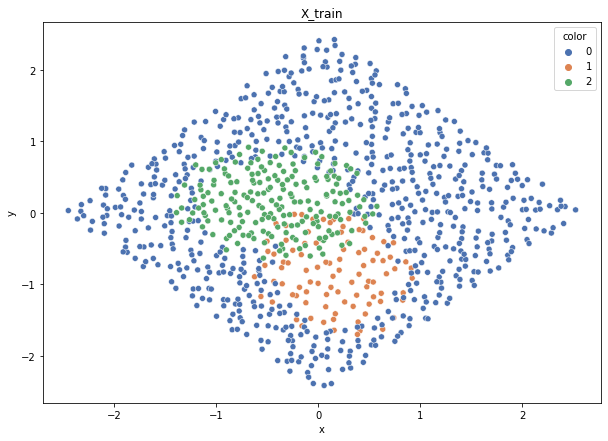

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


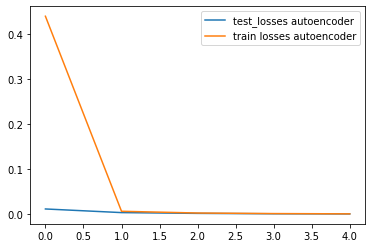

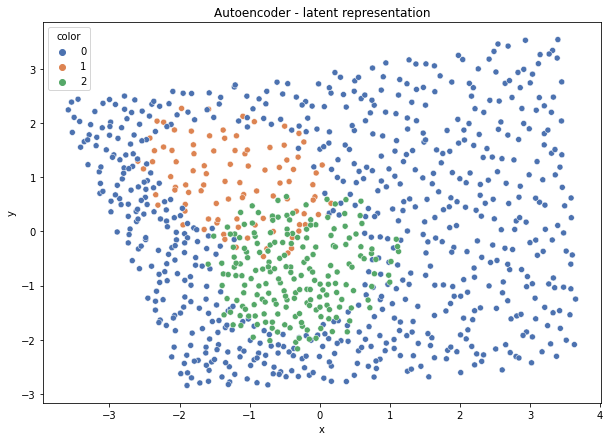

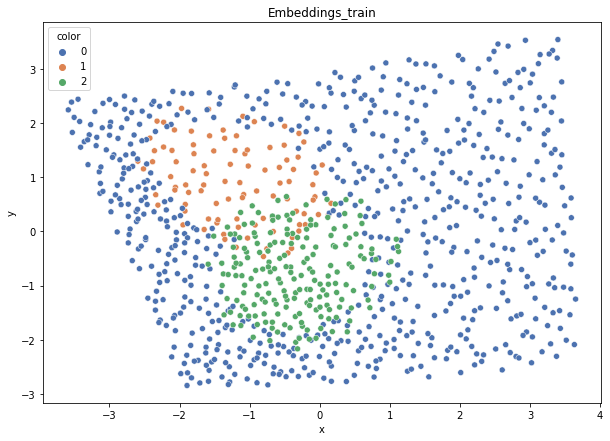

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.748
DT-f1-old+new-features: 0.762
DT-f1-old-features: 0.712
DT-gmean-new-features: 0.768
DT-gmean-old+new-features: 0.762
DT-gmean-old-features: 0.727
DT-minority_gmean-new-features: 0.08
DT-minority_gmean-old+new-features: 0.078
DT-minority_gmean-old-features: 0.076
KNN-f1-new-features: 0.676
KNN-f1-old+new-features: 0.679
KNN-f1-old-features: 0.666
KNN-gmean-new-features: 0.649
KNN-gmean-old+new-features: 0.65
KNN-gmean-old-features: 0.636
KNN-minority_gmean-new-features: 0.067
KNN-minority_gmean-old+new-features: 0.067
KNN-minority_gmean-old-features: 0.066


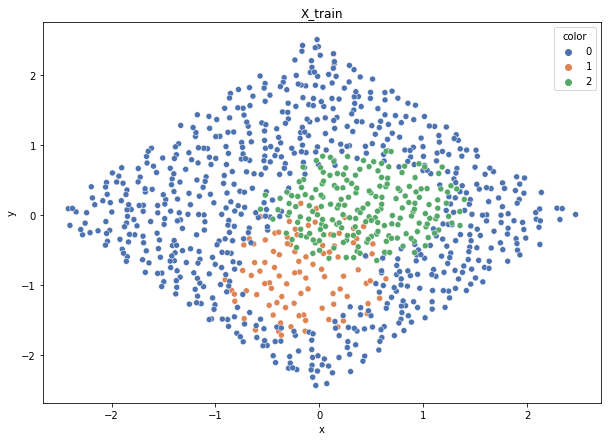

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


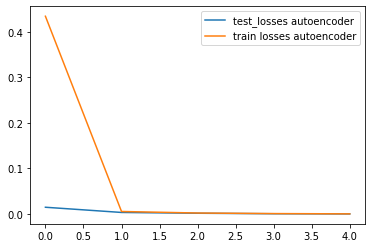

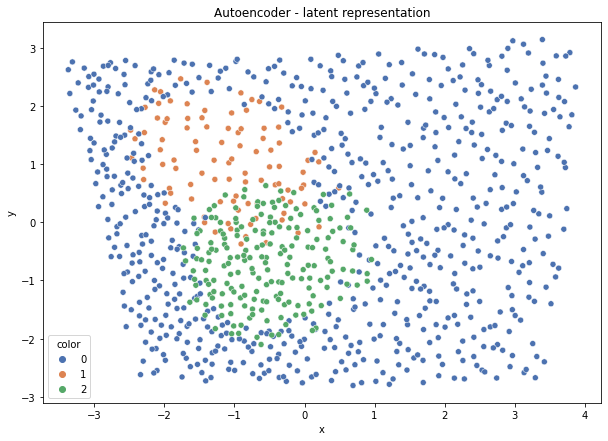

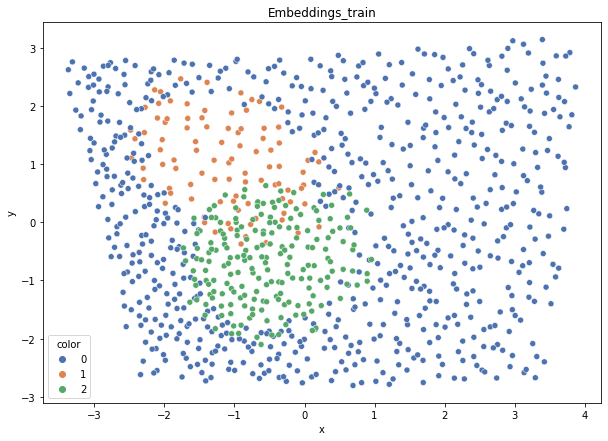

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.718
DT-f1-old+new-features: 0.736
DT-f1-old-features: 0.712
DT-gmean-new-features: 0.718
DT-gmean-old+new-features: 0.748
DT-gmean-old-features: 0.724
DT-minority_gmean-new-features: 0.075
DT-minority_gmean-old+new-features: 0.078
DT-minority_gmean-old-features: 0.076
KNN-f1-new-features: 0.705
KNN-f1-old+new-features: 0.705
KNN-f1-old-features: 0.73
KNN-gmean-new-features: 0.701
KNN-gmean-old+new-features: 0.701
KNN-gmean-old-features: 0.735
KNN-minority_gmean-new-features: 0.073
KNN-minority_gmean-old+new-features: 0.073
KNN-minority_gmean-old-features: 0.076


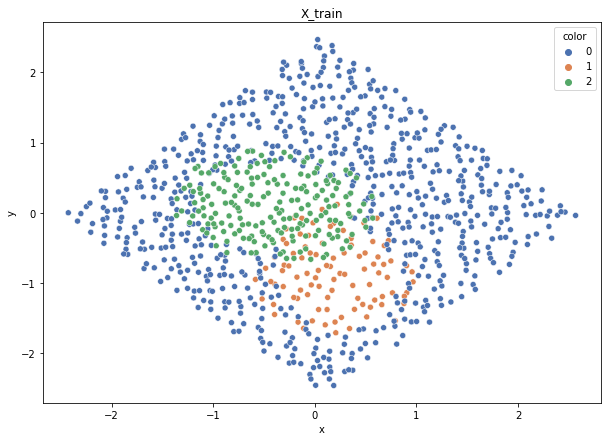

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


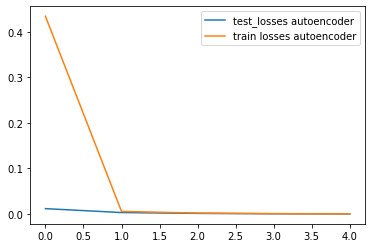

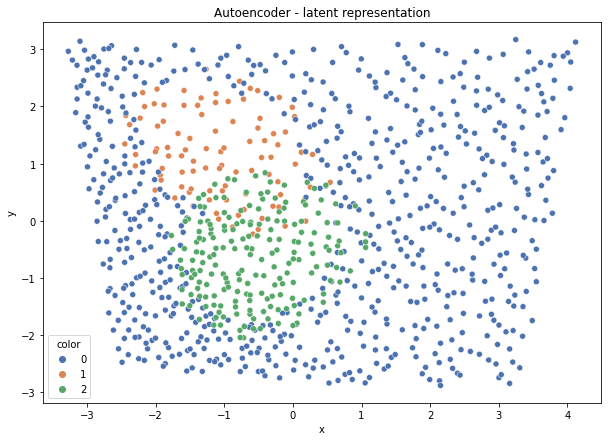

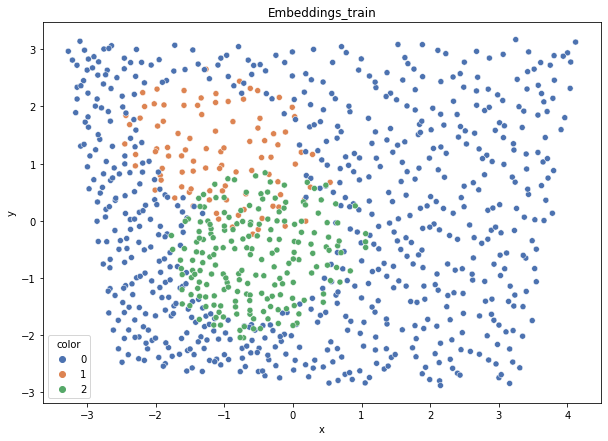

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.791
DT-f1-old+new-features: 0.765
DT-f1-old-features: 0.744
DT-gmean-new-features: 0.78
DT-gmean-old+new-features: 0.75
DT-gmean-old-features: 0.774
DT-minority_gmean-new-features: 0.08
DT-minority_gmean-old+new-features: 0.077
DT-minority_gmean-old-features: 0.082
KNN-f1-new-features: 0.689
KNN-f1-old+new-features: 0.673
KNN-f1-old-features: 0.669
KNN-gmean-new-features: 0.665
KNN-gmean-old+new-features: 0.639
KNN-gmean-old-features: 0.62
KNN-minority_gmean-new-features: 0.069
KNN-minority_gmean-old+new-features: 0.066
KNN-minority_gmean-old-features: 0.064
3mocniej-cut


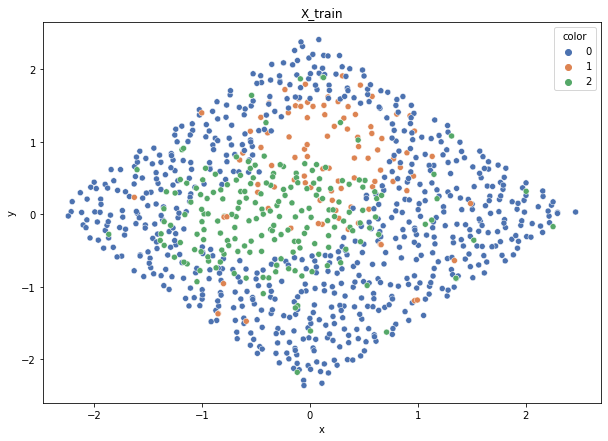

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


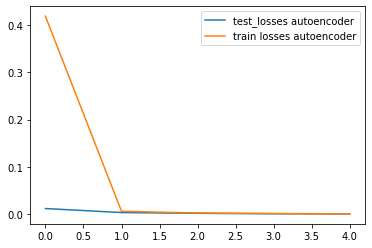

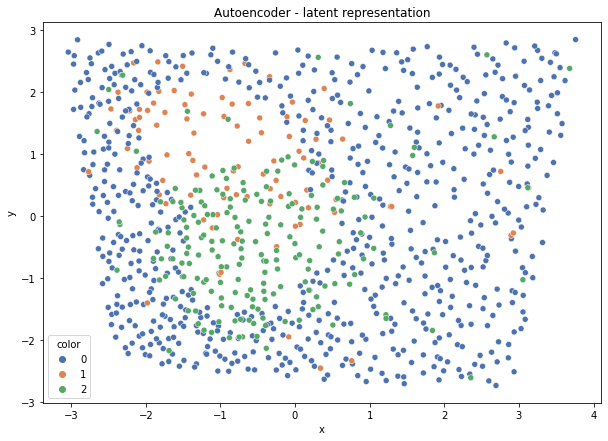

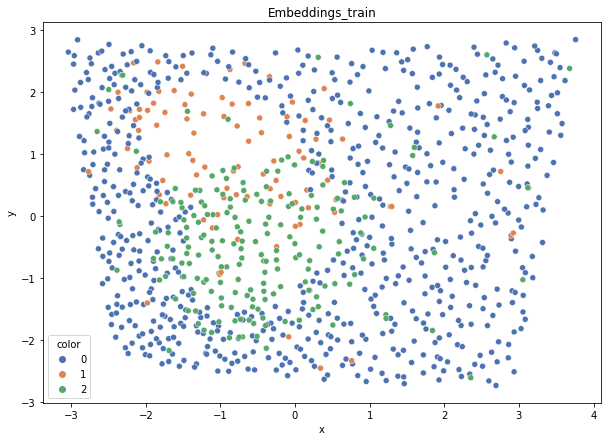

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.501
DT-f1-old+new-features: 0.517
DT-f1-old-features: 0.522
DT-gmean-new-features: 0.496
DT-gmean-old+new-features: 0.522
DT-gmean-old-features: 0.524
DT-minority_gmean-new-features: 0.055
DT-minority_gmean-old+new-features: 0.058
DT-minority_gmean-old-features: 0.059
KNN-f1-new-features: 0.555
KNN-f1-old+new-features: 0.559
KNN-f1-old-features: 0.537
KNN-gmean-new-features: 0.522
KNN-gmean-old+new-features: 0.524
KNN-gmean-old-features: 0.502
KNN-minority_gmean-new-features: 0.056
KNN-minority_gmean-old+new-features: 0.056
KNN-minority_gmean-old-features: 0.053


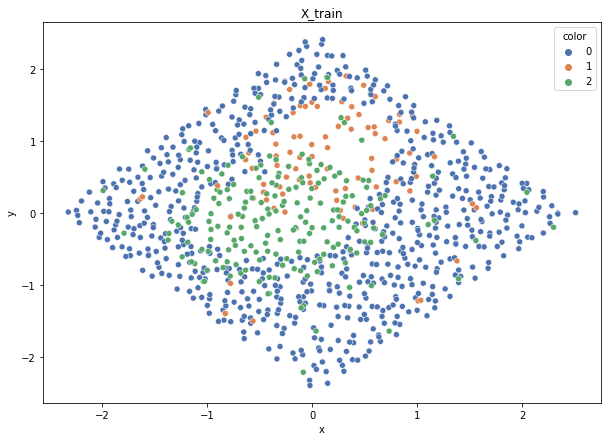

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


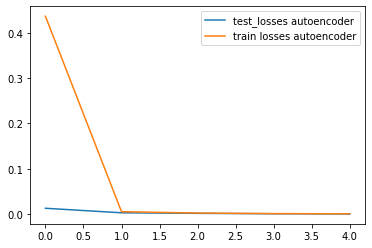

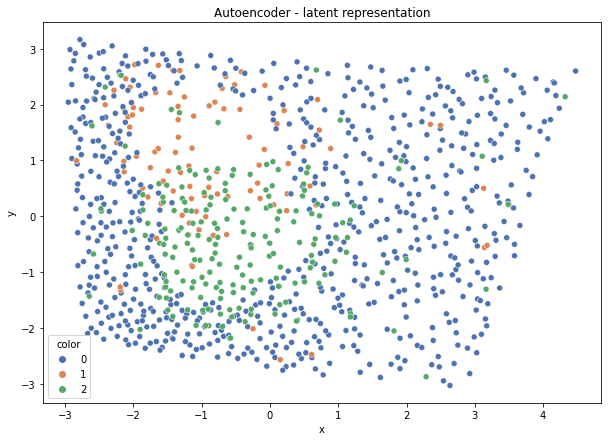

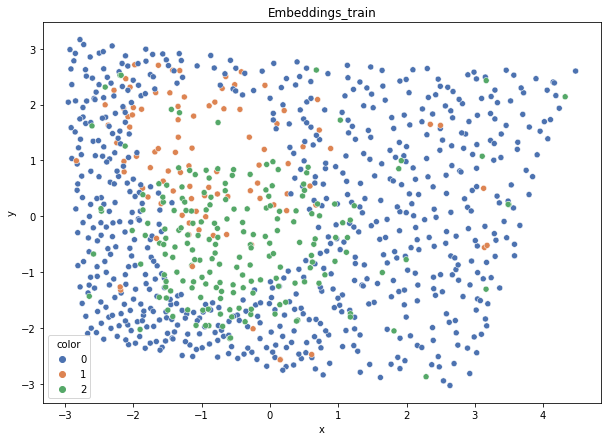

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.582
DT-f1-old+new-features: 0.573
DT-f1-old-features: 0.531
DT-gmean-new-features: 0.564
DT-gmean-old+new-features: 0.57
DT-gmean-old-features: 0.547
DT-minority_gmean-new-features: 0.06
DT-minority_gmean-old+new-features: 0.061
DT-minority_gmean-old-features: 0.06
KNN-f1-new-features: 0.546
KNN-f1-old+new-features: 0.546
KNN-f1-old-features: 0.536
KNN-gmean-new-features: 0.5
KNN-gmean-old+new-features: 0.5
KNN-gmean-old-features: 0.479
KNN-minority_gmean-new-features: 0.053
KNN-minority_gmean-old+new-features: 0.053
KNN-minority_gmean-old-features: 0.05


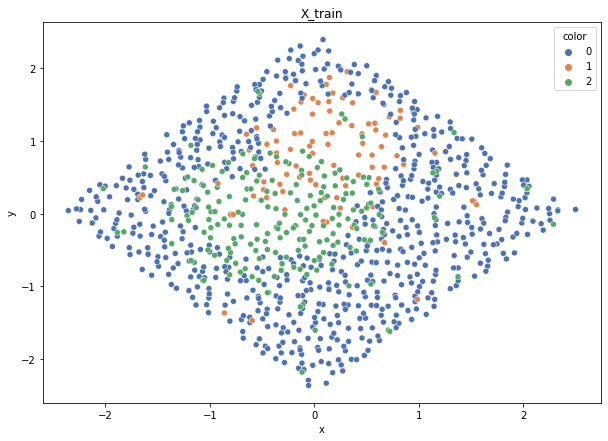

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


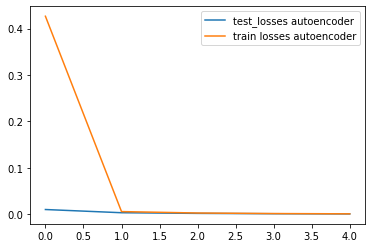

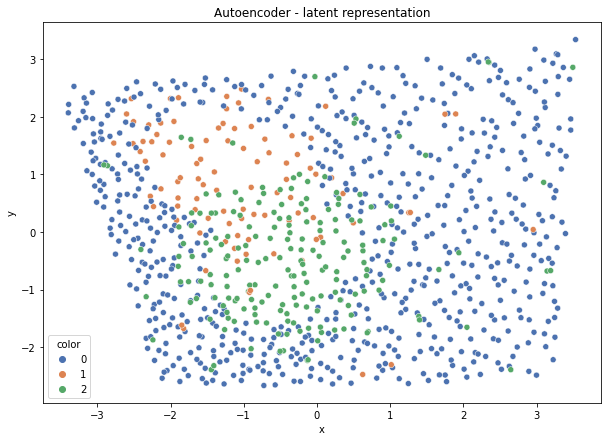

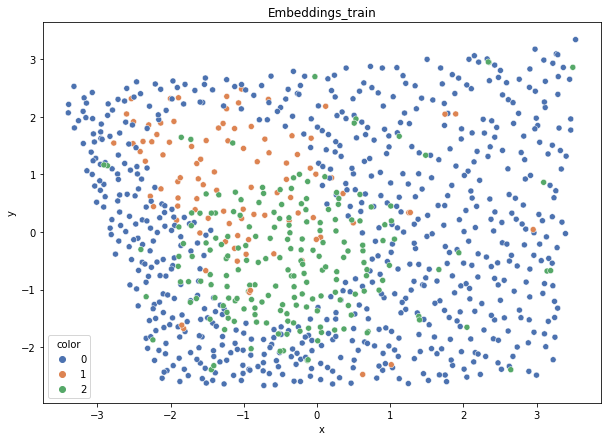

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.456
DT-f1-old+new-features: 0.462
DT-f1-old-features: 0.442
DT-gmean-new-features: 0.422
DT-gmean-old+new-features: 0.417
DT-gmean-old-features: 0.43
DT-minority_gmean-new-features: 0.046
DT-minority_gmean-old+new-features: 0.045
DT-minority_gmean-old-features: 0.049
KNN-f1-new-features: 0.46
KNN-f1-old+new-features: 0.452
KNN-f1-old-features: 0.438
KNN-gmean-new-features: 0.396
KNN-gmean-old+new-features: 0.389
KNN-gmean-old-features: 0.373
KNN-minority_gmean-new-features: 0.043
KNN-minority_gmean-old+new-features: 0.042
KNN-minority_gmean-old-features: 0.04


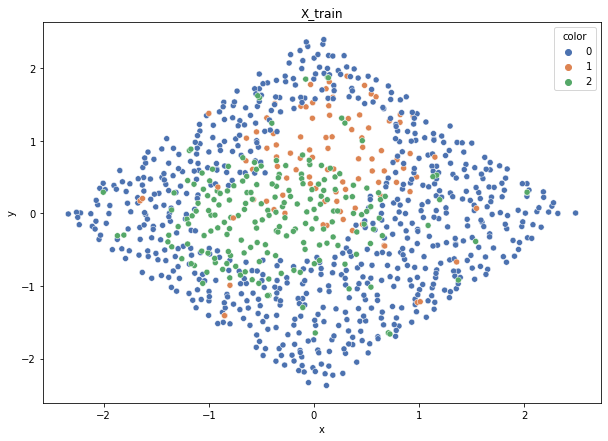

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


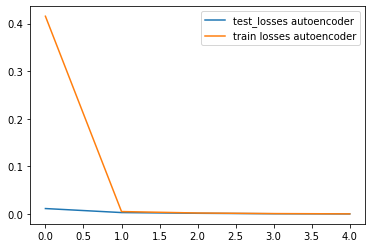

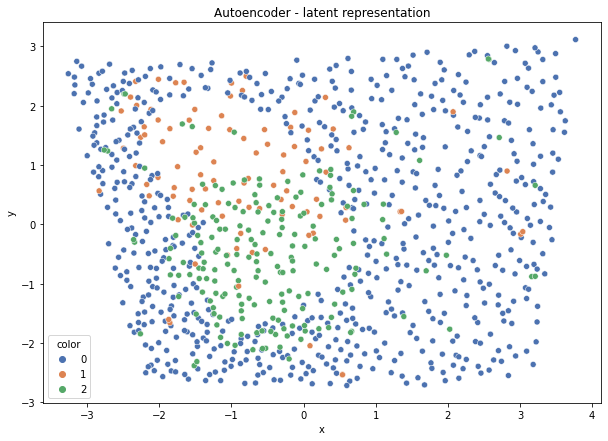

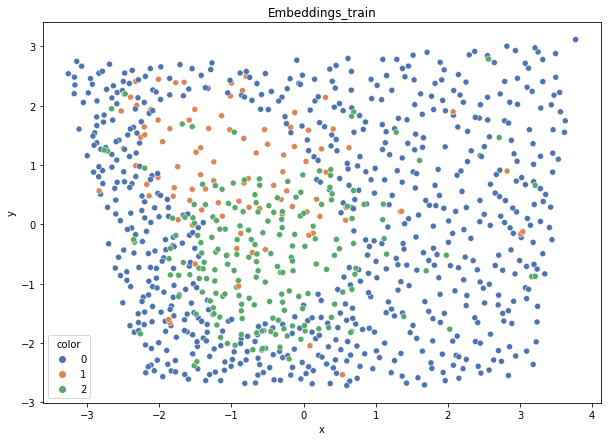

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.5
DT-f1-old+new-features: 0.511
DT-f1-old-features: 0.477
DT-gmean-new-features: 0.471
DT-gmean-old+new-features: 0.491
DT-gmean-old-features: 0.473
DT-minority_gmean-new-features: 0.051
DT-minority_gmean-old+new-features: 0.053
DT-minority_gmean-old-features: 0.053
KNN-f1-new-features: 0.519
KNN-f1-old+new-features: 0.502
KNN-f1-old-features: 0.51
KNN-gmean-new-features: 0.475
KNN-gmean-old+new-features: 0.442
KNN-gmean-old-features: 0.464
KNN-minority_gmean-new-features: 0.051
KNN-minority_gmean-old+new-features: 0.048
KNN-minority_gmean-old-features: 0.05


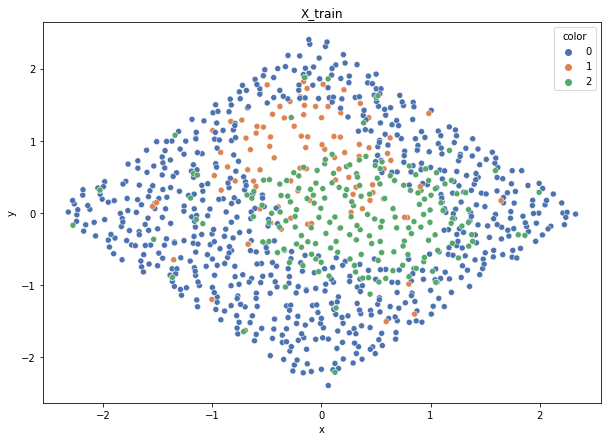

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


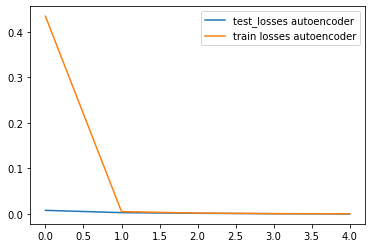

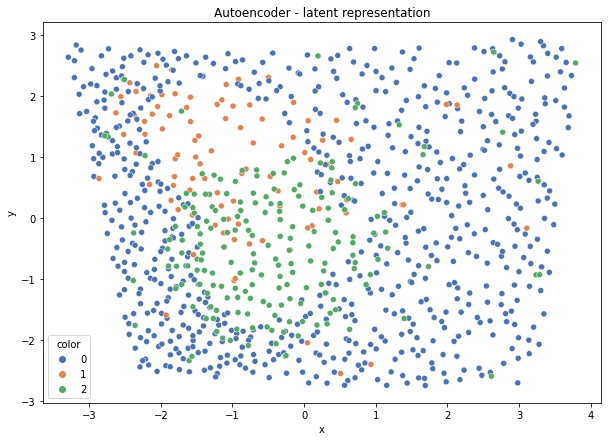

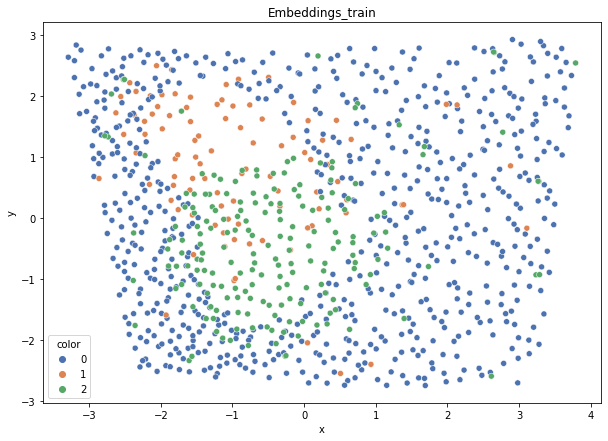

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.546
DT-f1-old+new-features: 0.529
DT-f1-old-features: 0.552
DT-gmean-new-features: 0.524
DT-gmean-old+new-features: 0.499
DT-gmean-old-features: 0.536
DT-minority_gmean-new-features: 0.057
DT-minority_gmean-old+new-features: 0.054
DT-minority_gmean-old-features: 0.058
KNN-f1-new-features: 0.527
KNN-f1-old+new-features: 0.529
KNN-f1-old-features: 0.522
KNN-gmean-new-features: 0.476
KNN-gmean-old+new-features: 0.477
KNN-gmean-old-features: 0.471
KNN-minority_gmean-new-features: 0.051
KNN-minority_gmean-old+new-features: 0.051
KNN-minority_gmean-old-features: 0.05
4delikatne-bezover-cut


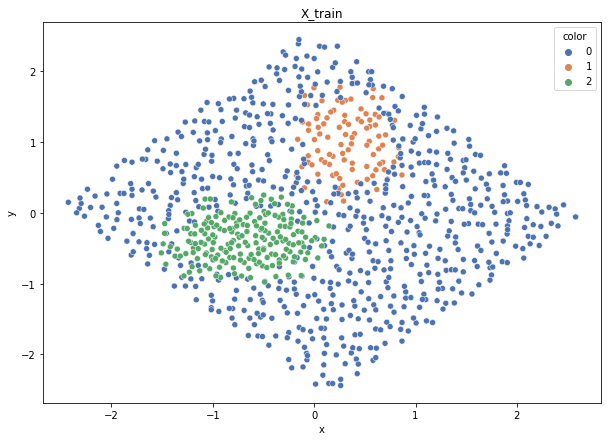

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


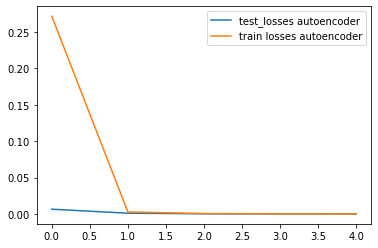

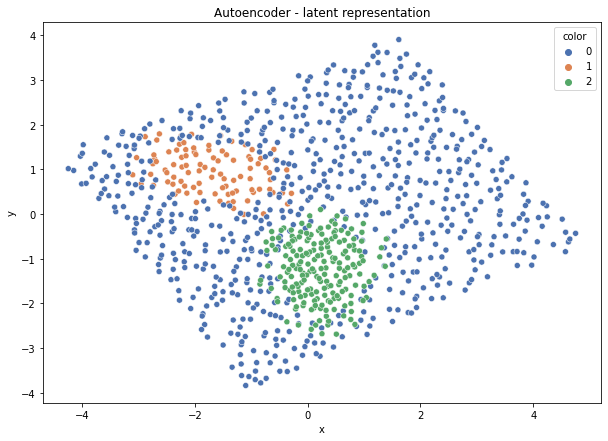

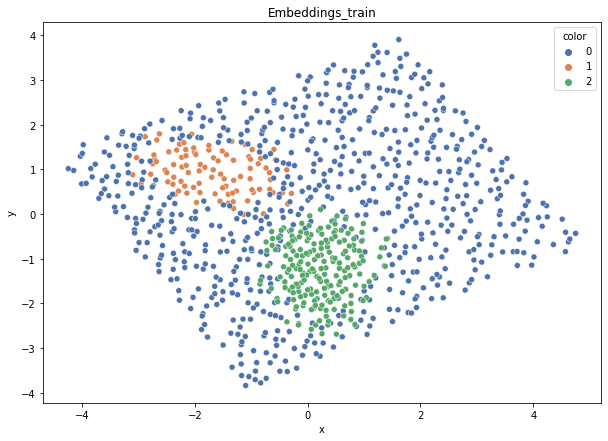

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.774
DT-f1-old+new-features: 0.796
DT-f1-old-features: 0.809
DT-gmean-new-features: 0.763
DT-gmean-old+new-features: 0.789
DT-gmean-old-features: 0.814
DT-minority_gmean-new-features: 0.08
DT-minority_gmean-old+new-features: 0.082
DT-minority_gmean-old-features: 0.085
KNN-f1-new-features: 0.76
KNN-f1-old+new-features: 0.76
KNN-f1-old-features: 0.772
KNN-gmean-new-features: 0.738
KNN-gmean-old+new-features: 0.738
KNN-gmean-old-features: 0.746
KNN-minority_gmean-new-features: 0.077
KNN-minority_gmean-old+new-features: 0.077
KNN-minority_gmean-old-features: 0.078


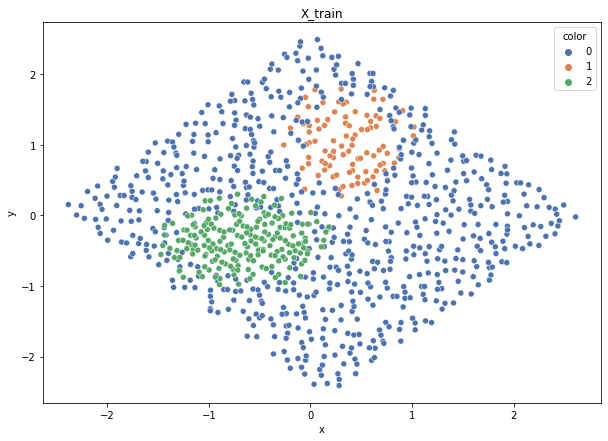

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


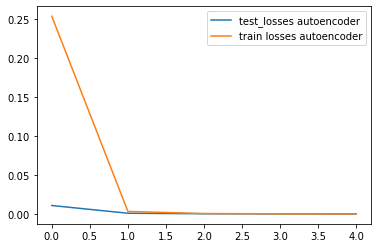

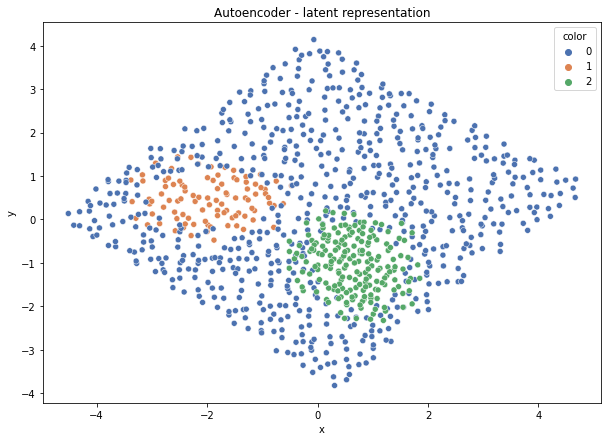

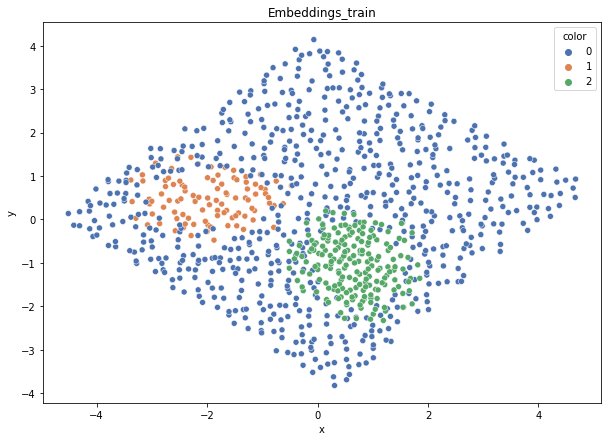

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.773
DT-f1-old+new-features: 0.814
DT-f1-old-features: 0.761
DT-gmean-new-features: 0.771
DT-gmean-old+new-features: 0.813
DT-gmean-old-features: 0.769
DT-minority_gmean-new-features: 0.08
DT-minority_gmean-old+new-features: 0.084
DT-minority_gmean-old-features: 0.08
KNN-f1-new-features: 0.757
KNN-f1-old+new-features: 0.752
KNN-f1-old-features: 0.767
KNN-gmean-new-features: 0.767
KNN-gmean-old+new-features: 0.765
KNN-gmean-old-features: 0.776
KNN-minority_gmean-new-features: 0.08
KNN-minority_gmean-old+new-features: 0.08
KNN-minority_gmean-old-features: 0.081


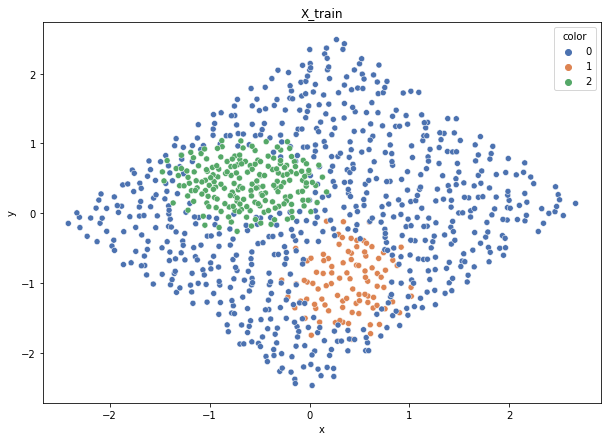

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


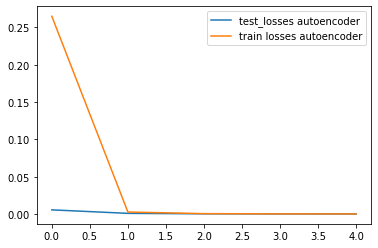

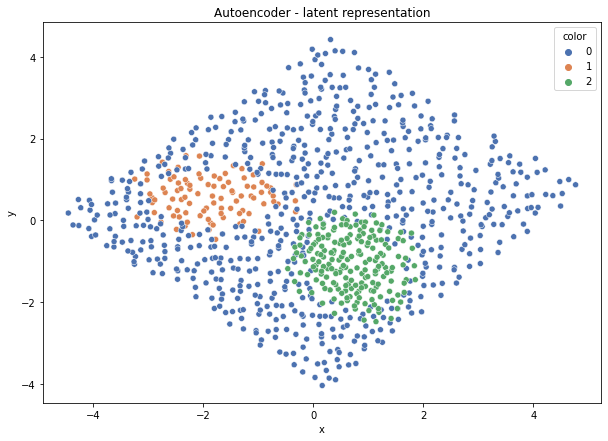

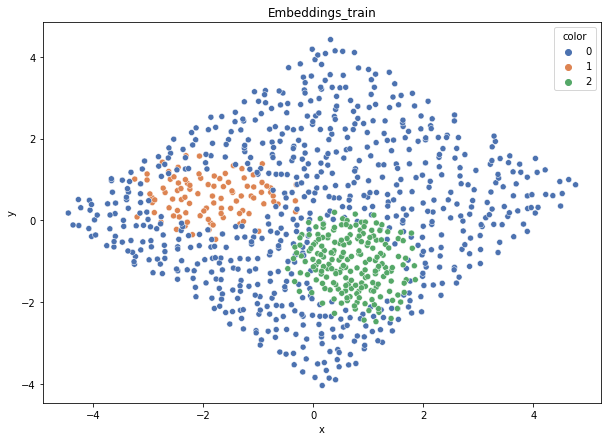

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.833
DT-f1-old+new-features: 0.81
DT-f1-old-features: 0.785
DT-gmean-new-features: 0.855
DT-gmean-old+new-features: 0.818
DT-gmean-old-features: 0.785
DT-minority_gmean-new-features: 0.089
DT-minority_gmean-old+new-features: 0.085
DT-minority_gmean-old-features: 0.082
KNN-f1-new-features: 0.772
KNN-f1-old+new-features: 0.777
KNN-f1-old-features: 0.766
KNN-gmean-new-features: 0.76
KNN-gmean-old+new-features: 0.762
KNN-gmean-old-features: 0.744
KNN-minority_gmean-new-features: 0.079
KNN-minority_gmean-old+new-features: 0.079
KNN-minority_gmean-old-features: 0.077


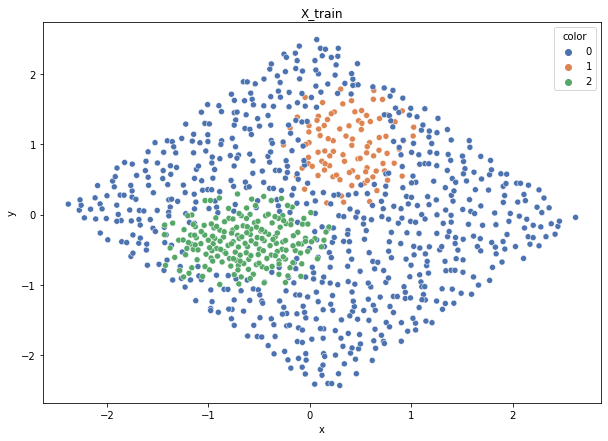

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


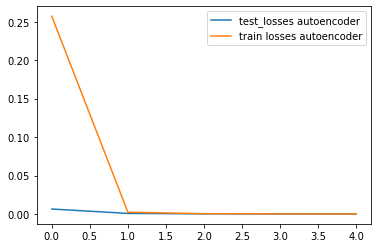

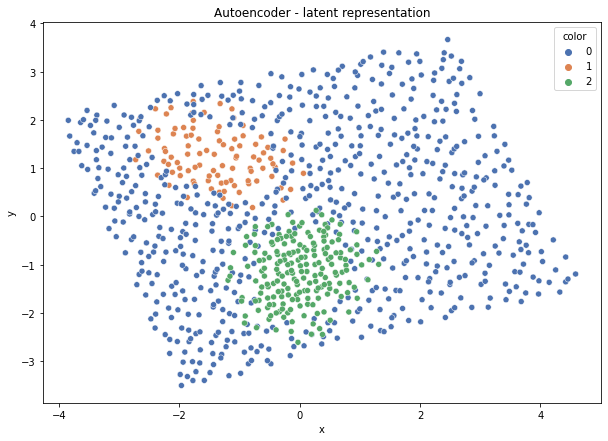

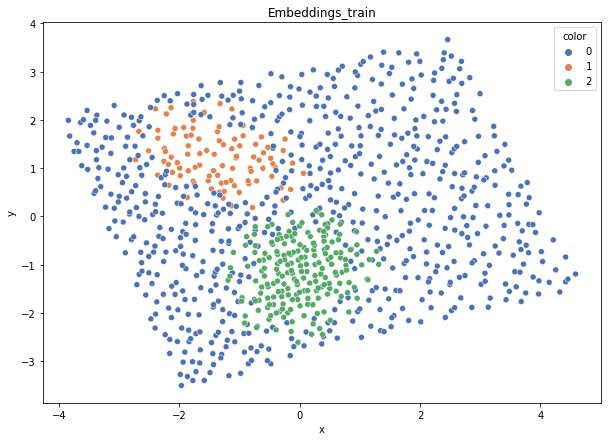

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.825
DT-f1-old+new-features: 0.831
DT-f1-old-features: 0.805
DT-gmean-new-features: 0.84
DT-gmean-old+new-features: 0.842
DT-gmean-old-features: 0.831
DT-minority_gmean-new-features: 0.087
DT-minority_gmean-old+new-features: 0.087
DT-minority_gmean-old-features: 0.087
KNN-f1-new-features: 0.752
KNN-f1-old+new-features: 0.758
KNN-f1-old-features: 0.747
KNN-gmean-new-features: 0.757
KNN-gmean-old+new-features: 0.758
KNN-gmean-old-features: 0.749
KNN-minority_gmean-new-features: 0.079
KNN-minority_gmean-old+new-features: 0.079
KNN-minority_gmean-old-features: 0.079


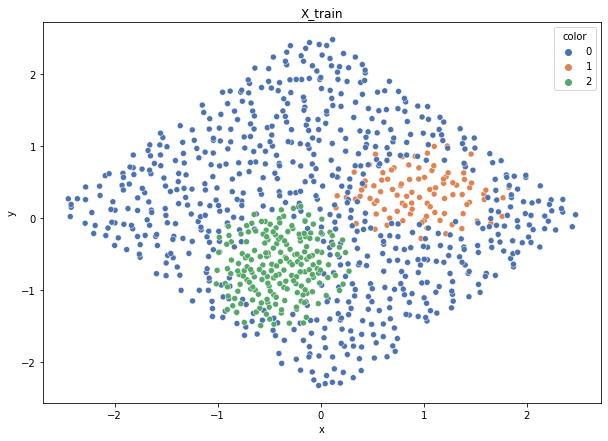

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


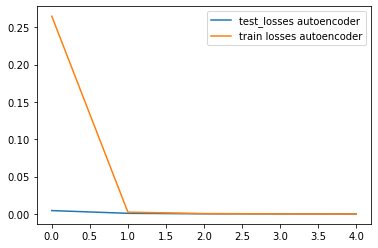

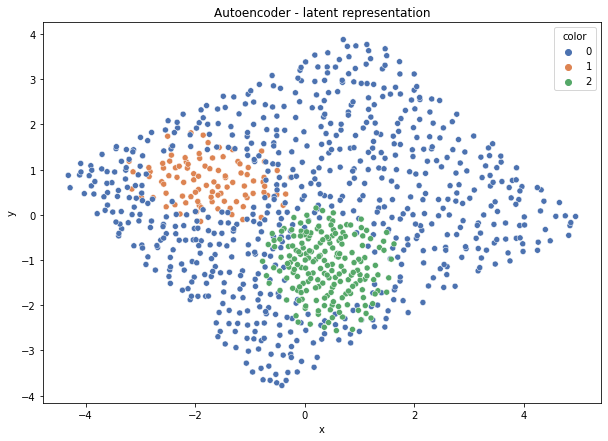

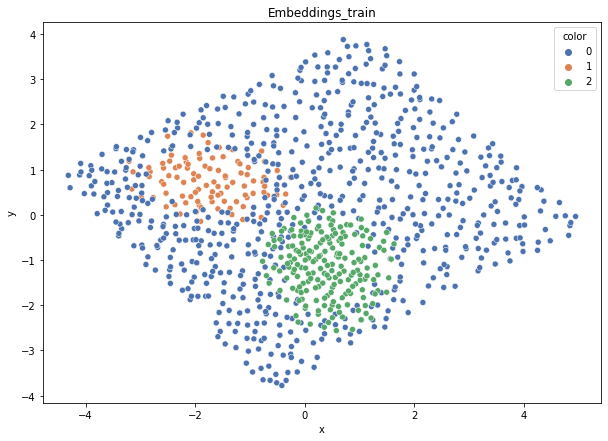

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.826
DT-f1-old+new-features: 0.814
DT-f1-old-features: 0.821
DT-gmean-new-features: 0.831
DT-gmean-old+new-features: 0.826
DT-gmean-old-features: 0.866
DT-minority_gmean-new-features: 0.086
DT-minority_gmean-old+new-features: 0.086
DT-minority_gmean-old-features: 0.091
KNN-f1-new-features: 0.792
KNN-f1-old+new-features: 0.792
KNN-f1-old-features: 0.786
KNN-gmean-new-features: 0.799
KNN-gmean-old+new-features: 0.799
KNN-gmean-old-features: 0.788
KNN-minority_gmean-new-features: 0.084
KNN-minority_gmean-old+new-features: 0.084
KNN-minority_gmean-old-features: 0.082
balance-scale


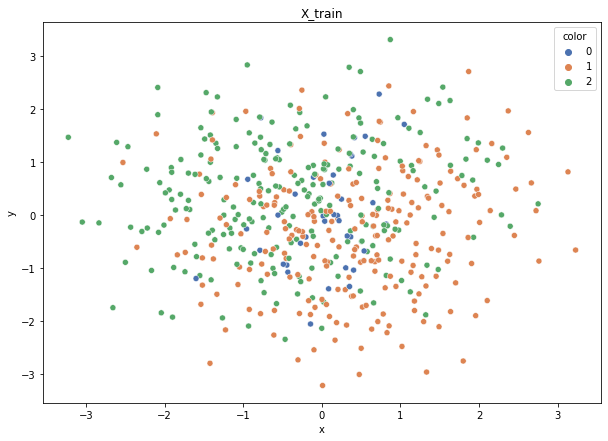

Class cardinalities: Counter({1: 231, 2: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.1266928236932034, 1: 0.12614436991098174}
Training autoencoder...


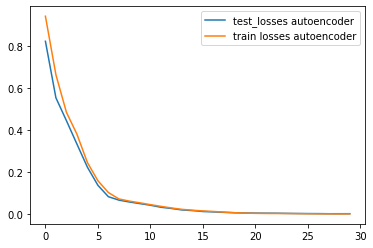

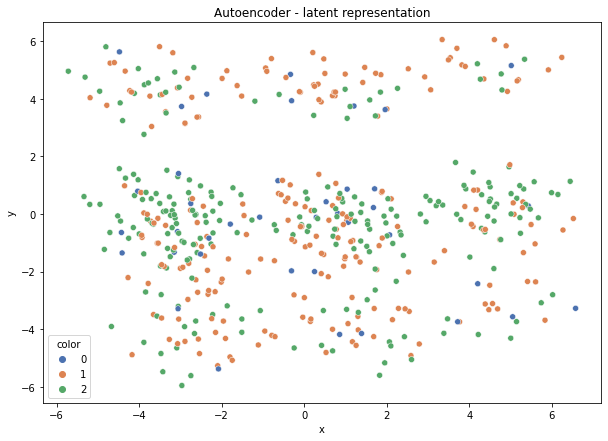

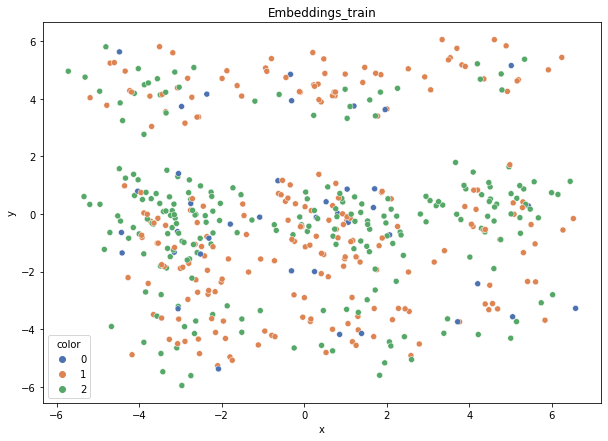

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.416
DT-f1-old+new-features: 0.513
DT-f1-old-features: 0.568
DT-gmean-new-features: 0.319
DT-gmean-old+new-features: 0.083
DT-gmean-old-features: 0.088
DT-minority_gmean-new-features: 0.01
DT-minority_gmean-old+new-features: 0.001
DT-minority_gmean-old-features: 0.001
KNN-f1-new-features: 0.373
KNN-f1-old+new-features: 0.461
KNN-f1-old-features: 0.568
KNN-gmean-new-features: 0.066
KNN-gmean-old+new-features: 0.077
KNN-gmean-old-features: 0.09
KNN-minority_gmean-new-features: 0.001
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001


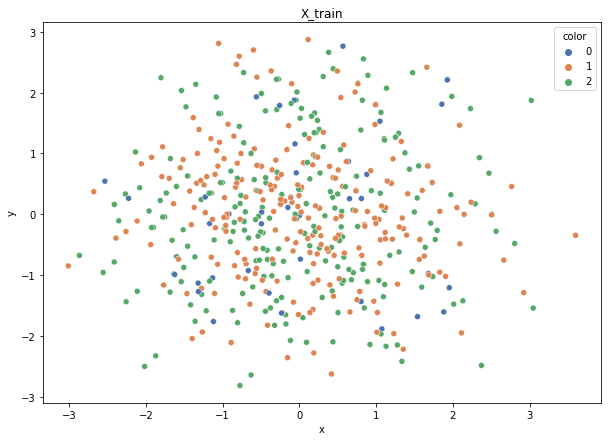

Class cardinalities: Counter({1: 231, 2: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.1266928236932034, 1: 0.12614436991098174}
Training autoencoder...


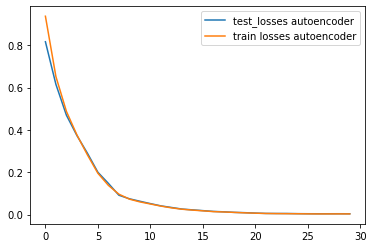

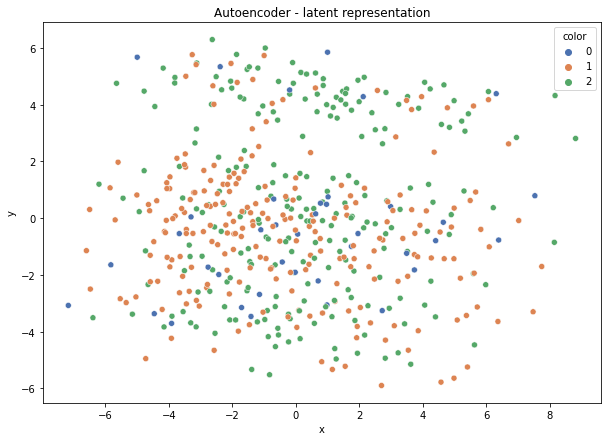

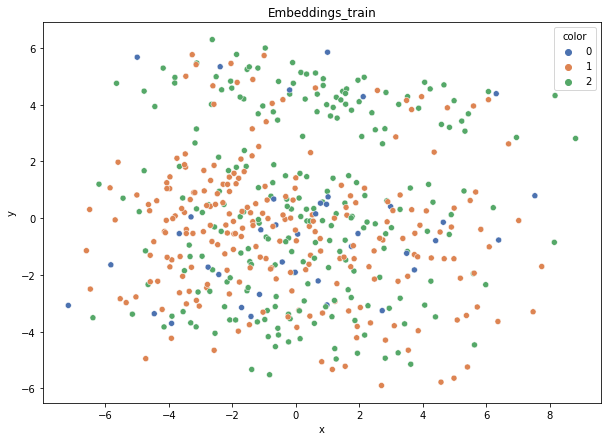

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.377
DT-f1-old+new-features: 0.644
DT-f1-old-features: 0.638
DT-gmean-new-features: 0.294
DT-gmean-old+new-features: 0.584
DT-gmean-old-features: 0.585
DT-minority_gmean-new-features: 0.005
DT-minority_gmean-old+new-features: 0.007
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.493
KNN-f1-old+new-features: 0.526
KNN-f1-old-features: 0.545
KNN-gmean-new-features: 0.084
KNN-gmean-old+new-features: 0.087
KNN-gmean-old-features: 0.088
KNN-minority_gmean-new-features: 0.001
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001


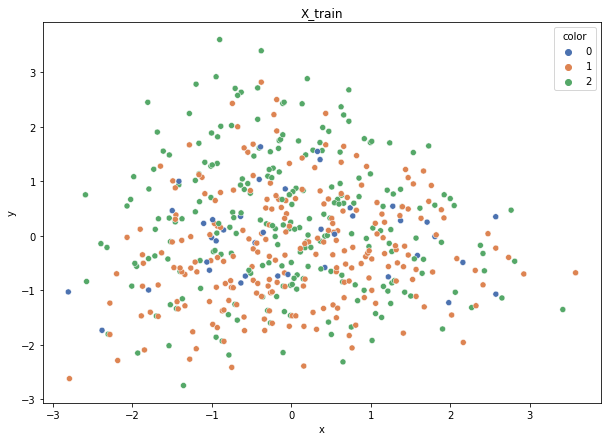

Class cardinalities: Counter({2: 231, 1: 230, 0: 39})
Weights: {2: 0.12614436991098174, 1: 0.1266928236932034, 0: 0.7471628063958148}
Training autoencoder...


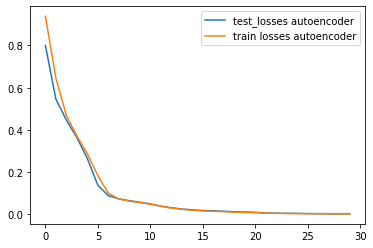

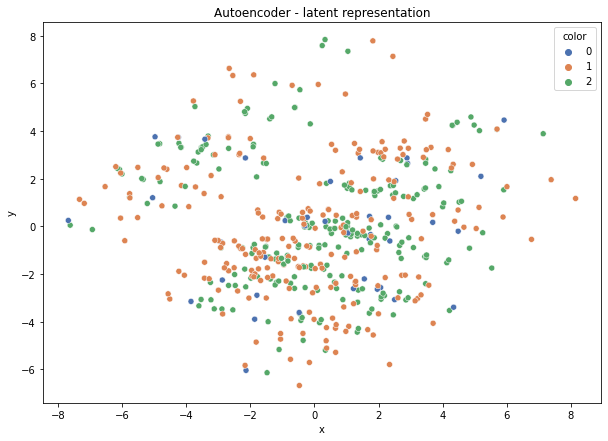

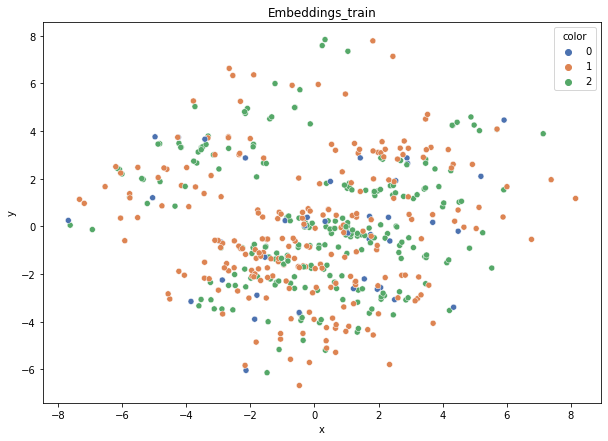

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.423
DT-f1-old+new-features: 0.582
DT-f1-old-features: 0.655
DT-gmean-new-features: 0.387
DT-gmean-old+new-features: 0.493
DT-gmean-old-features: 0.597
DT-minority_gmean-new-features: 0.006
DT-minority_gmean-old+new-features: 0.006
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.374
KNN-f1-old+new-features: 0.467
KNN-f1-old-features: 0.566
KNN-gmean-new-features: 0.067
KNN-gmean-old+new-features: 0.079
KNN-gmean-old-features: 0.09
KNN-minority_gmean-new-features: 0.001
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001


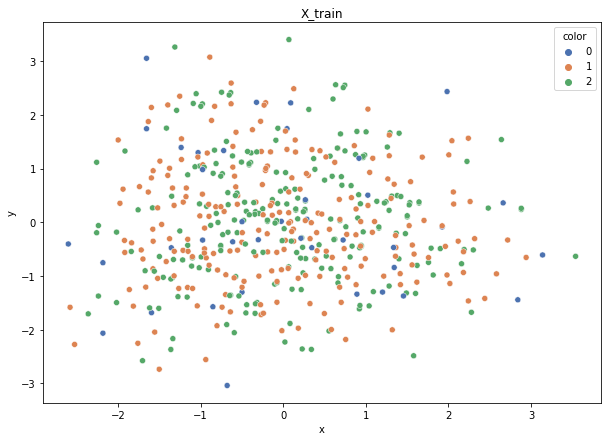

Class cardinalities: Counter({2: 231, 1: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.12614436991098174, 1: 0.1266928236932034}
Training autoencoder...


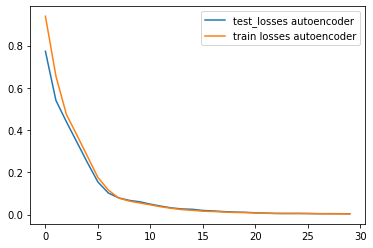

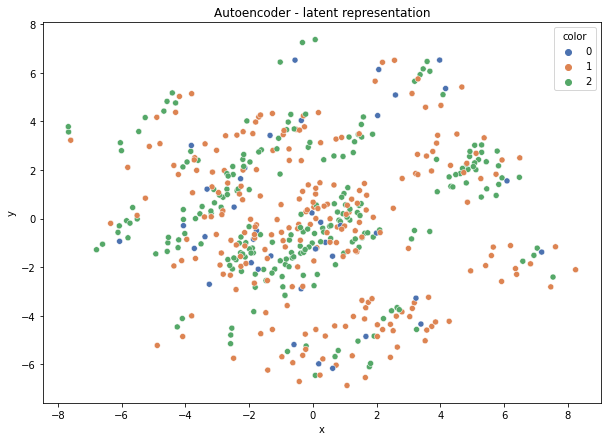

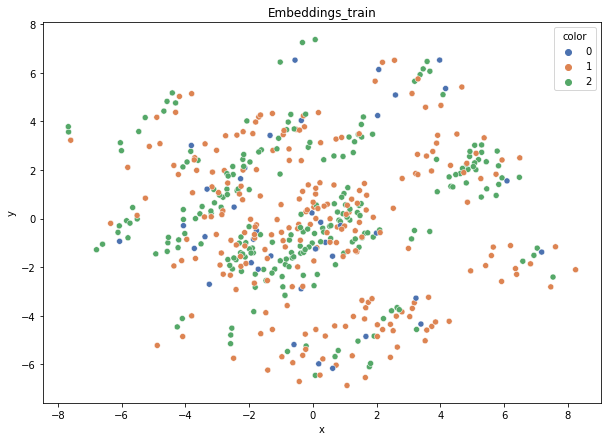

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.382
DT-f1-old+new-features: 0.532
DT-f1-old-features: 0.582
DT-gmean-new-features: 0.07
DT-gmean-old+new-features: 0.382
DT-gmean-old-features: 0.397
DT-minority_gmean-new-features: 0.001
DT-minority_gmean-old+new-features: 0.005
DT-minority_gmean-old-features: 0.005
KNN-f1-new-features: 0.342
KNN-f1-old+new-features: 0.446
KNN-f1-old-features: 0.562
KNN-gmean-new-features: 0.065
KNN-gmean-old+new-features: 0.077
KNN-gmean-old-features: 0.089
KNN-minority_gmean-new-features: 0.001
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001


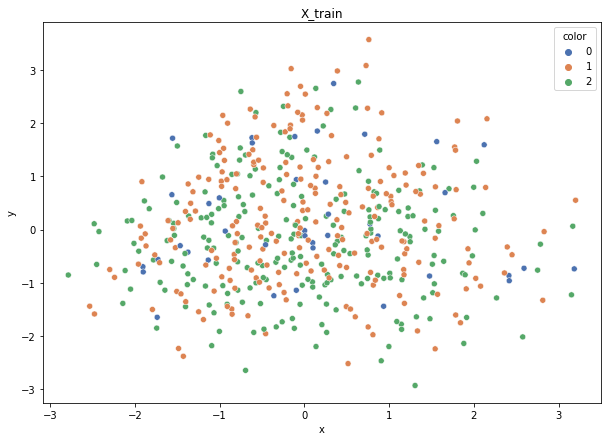

Class cardinalities: Counter({2: 230, 1: 230, 0: 40})
Weights: {0: 0.7419354838709677, 2: 0.12903225806451613, 1: 0.12903225806451613}
Training autoencoder...


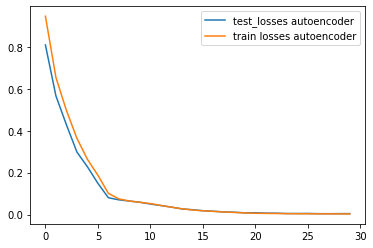

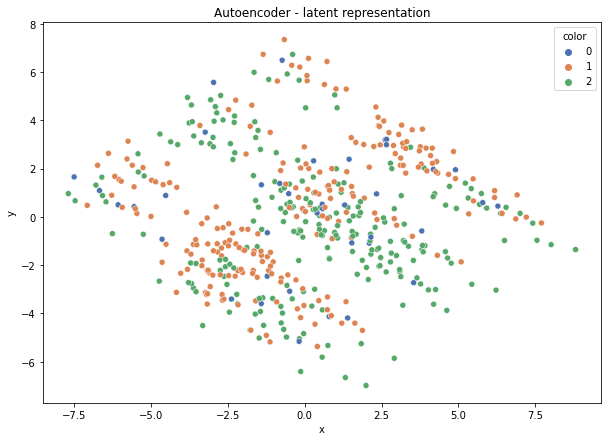

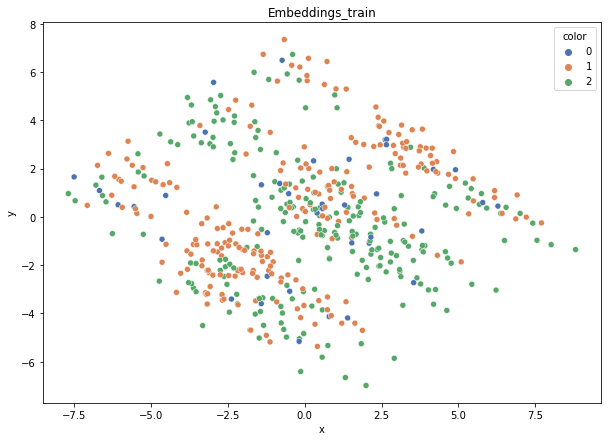

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.388
DT-f1-old+new-features: 0.603
DT-f1-old-features: 0.582
DT-gmean-new-features: 0.069
DT-gmean-old+new-features: 0.52
DT-gmean-old-features: 0.415
DT-minority_gmean-new-features: 0.001
DT-minority_gmean-old+new-features: 0.006
DT-minority_gmean-old-features: 0.005
KNN-f1-new-features: 0.425
KNN-f1-old+new-features: 0.472
KNN-f1-old-features: 0.563
KNN-gmean-new-features: 0.075
KNN-gmean-old+new-features: 0.08
KNN-gmean-old-features: 0.089
KNN-minority_gmean-new-features: 0.001
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001
cleveland


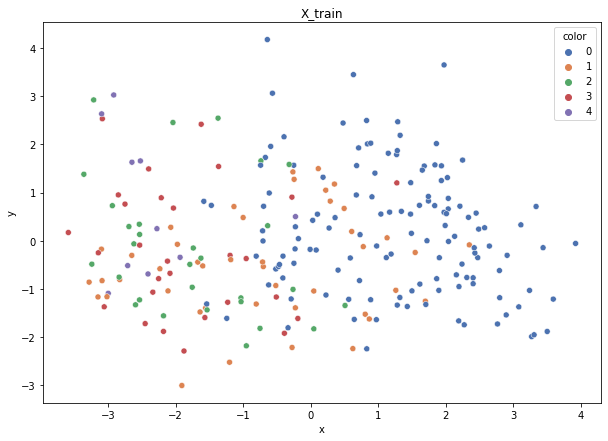

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 10})
Weights: {0: 0.03806176471590889, 2: 0.1719341785442781, 1: 0.11332025404054694, 3: 0.17807468492085946, 4: 0.4986091177784065}
Training autoencoder...


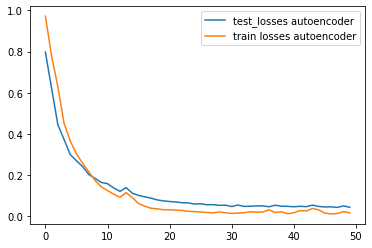

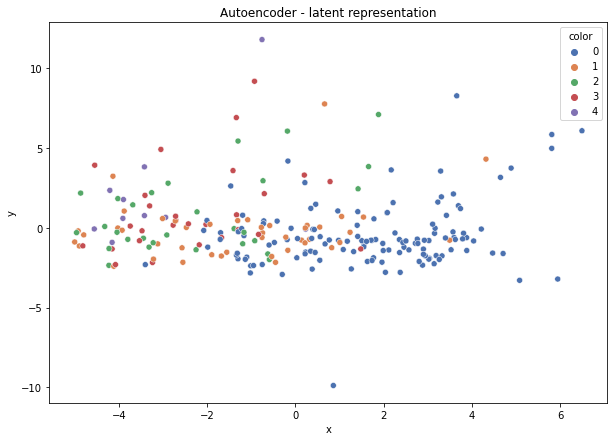

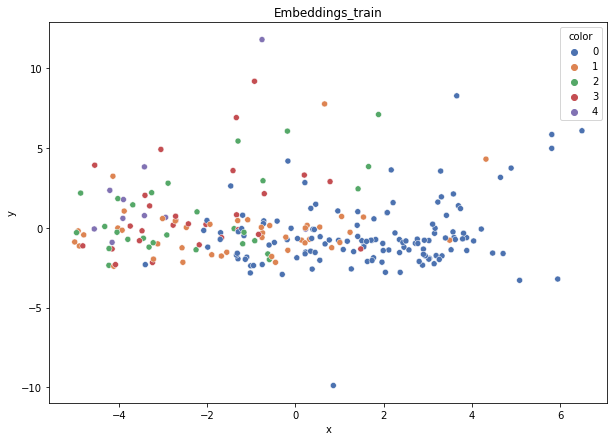

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.216
DT-f1-old+new-features: 0.272
DT-f1-old-features: 0.266
DT-gmean-new-features: 0.027
DT-gmean-old+new-features: 0.036
DT-gmean-old-features: 0.098
DT-minority_gmean-new-features: 0.007
DT-minority_gmean-old+new-features: 0.01
DT-minority_gmean-old-features: 0.026
KNN-f1-new-features: 0.312
KNN-f1-old+new-features: 0.279
KNN-f1-old-features: 0.275
KNN-gmean-new-features: 0.099
KNN-gmean-old+new-features: 0.085
KNN-gmean-old-features: 0.089
KNN-minority_gmean-new-features: 0.026
KNN-minority_gmean-old+new-features: 0.022
KNN-minority_gmean-old-features: 0.024


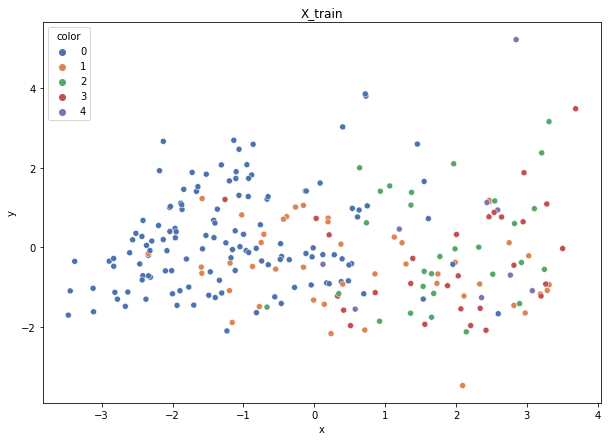

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 10})
Weights: {0: 0.03806176471590889, 2: 0.1719341785442781, 1: 0.11332025404054694, 3: 0.17807468492085946, 4: 0.4986091177784065}
Training autoencoder...


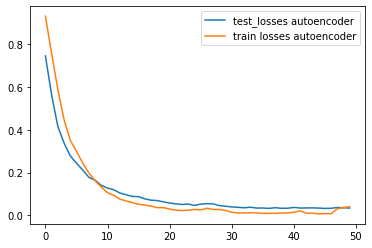

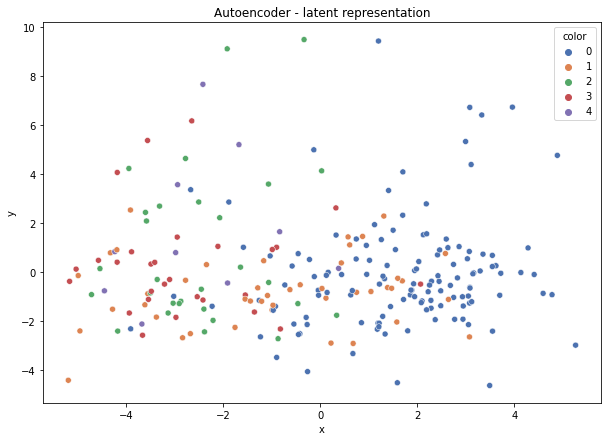

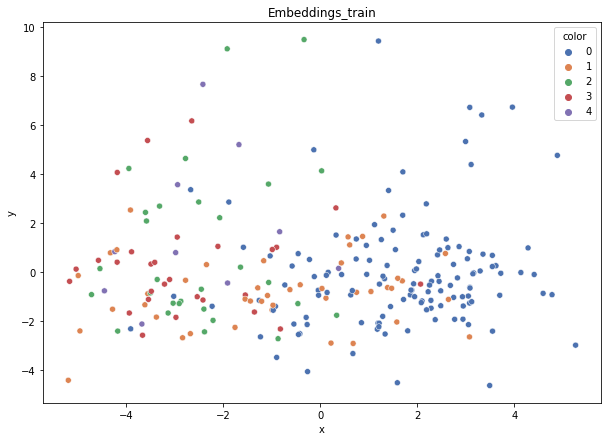

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.28
DT-f1-old+new-features: 0.298
DT-f1-old-features: 0.281
DT-gmean-new-features: 0.09
DT-gmean-old+new-features: 0.102
DT-gmean-old-features: 0.101
DT-minority_gmean-new-features: 0.024
DT-minority_gmean-old+new-features: 0.027
DT-minority_gmean-old-features: 0.027
KNN-f1-new-features: 0.342
KNN-f1-old+new-features: 0.342
KNN-f1-old-features: 0.356
KNN-gmean-new-features: 0.114
KNN-gmean-old+new-features: 0.114
KNN-gmean-old-features: 0.122
KNN-minority_gmean-new-features: 0.029
KNN-minority_gmean-old+new-features: 0.029
KNN-minority_gmean-old-features: 0.033


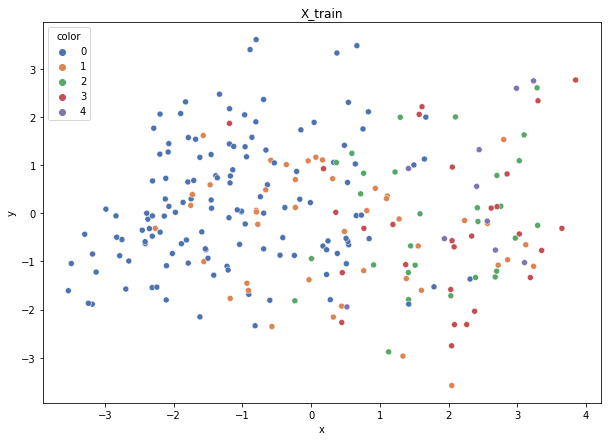

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 10})
Weights: {0: 0.03806176471590889, 3: 0.17807468492085946, 1: 0.11332025404054694, 2: 0.1719341785442781, 4: 0.4986091177784065}
Training autoencoder...


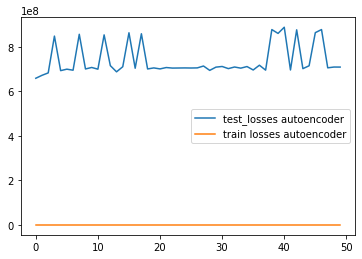

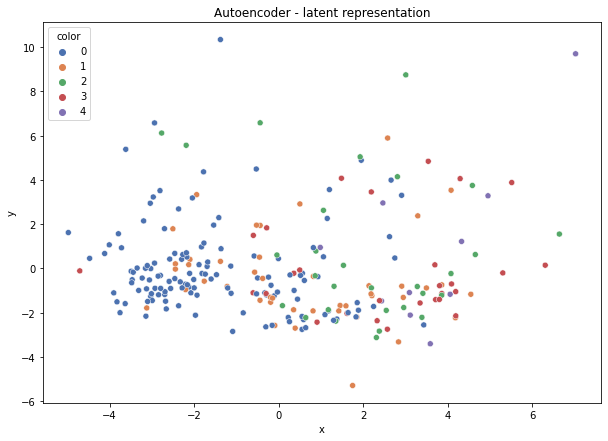

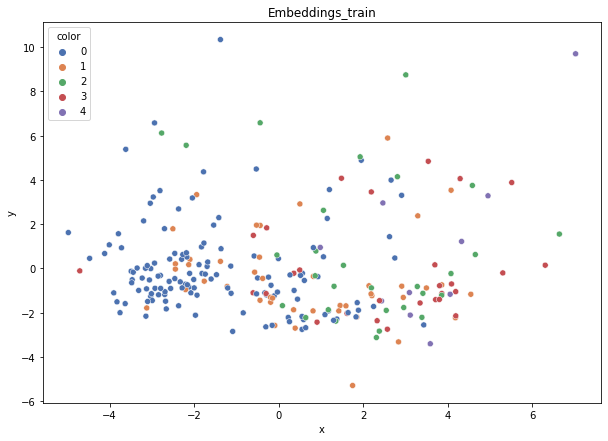

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.291
DT-f1-old+new-features: 0.361
DT-f1-old-features: 0.368
DT-gmean-new-features: 0.101
DT-gmean-old+new-features: 0.128
DT-gmean-old-features: 0.128
DT-minority_gmean-new-features: 0.027
DT-minority_gmean-old+new-features: 0.034
DT-minority_gmean-old-features: 0.034
KNN-f1-new-features: 0.424
KNN-f1-old+new-features: 0.369
KNN-f1-old-features: 0.325
KNN-gmean-new-features: 0.36
KNN-gmean-old+new-features: 0.306
KNN-gmean-old-features: 0.109
KNN-minority_gmean-new-features: 0.094
KNN-minority_gmean-old+new-features: 0.082
KNN-minority_gmean-old-features: 0.029


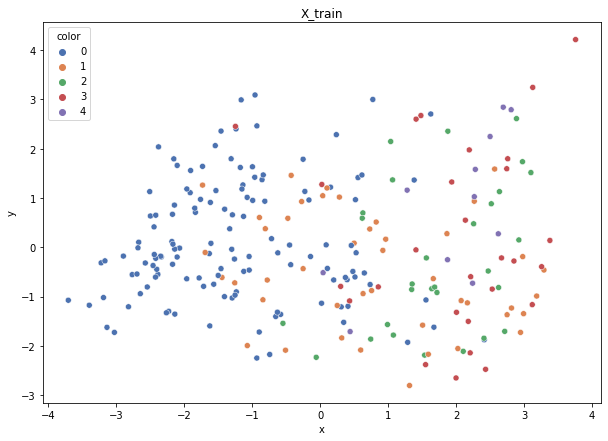

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 11})
Weights: {0: 0.03986894846317969, 2: 0.18009766374746689, 1: 0.11870073292446681, 3: 0.18652972316701927, 4: 0.47480293169786725}
Training autoencoder...


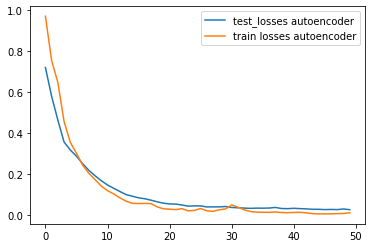

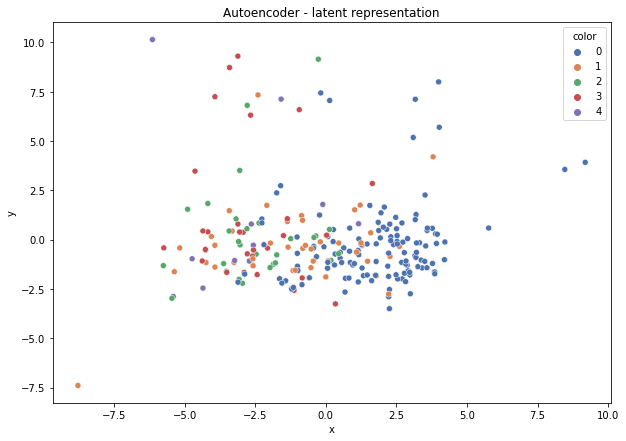

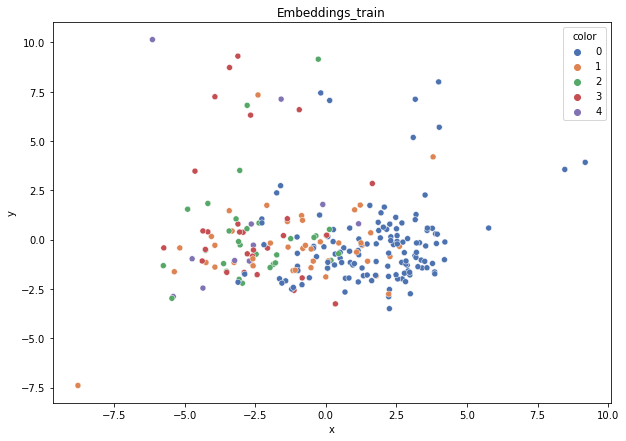

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.248
DT-f1-old+new-features: 0.271
DT-f1-old-features: 0.305
DT-gmean-new-features: 0.036
DT-gmean-old+new-features: 0.097
DT-gmean-old-features: 0.112
DT-minority_gmean-new-features: 0.01
DT-minority_gmean-old+new-features: 0.027
DT-minority_gmean-old-features: 0.031
KNN-f1-new-features: 0.269
KNN-f1-old+new-features: 0.253
KNN-f1-old-features: 0.254
KNN-gmean-new-features: 0.038
KNN-gmean-old+new-features: 0.036
KNN-gmean-old-features: 0.036
KNN-minority_gmean-new-features: 0.01
KNN-minority_gmean-old+new-features: 0.01
KNN-minority_gmean-old-features: 0.01


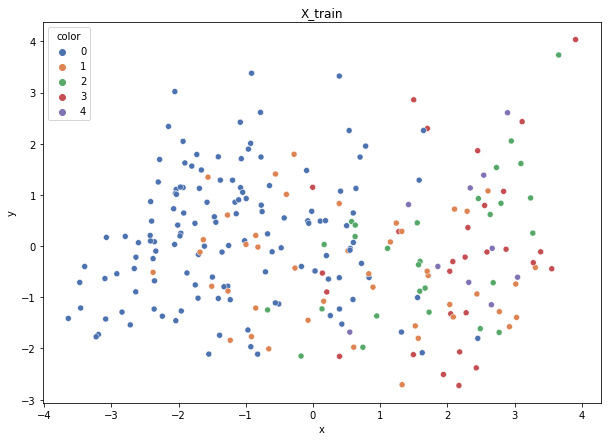

Class cardinalities: Counter({0: 132, 1: 44, 2: 28, 3: 28, 4: 11})
Weights: {2: 0.18539325842696627, 1: 0.11797752808988764, 0: 0.03932584269662921, 3: 0.18539325842696627, 4: 0.47191011235955055}
Training autoencoder...


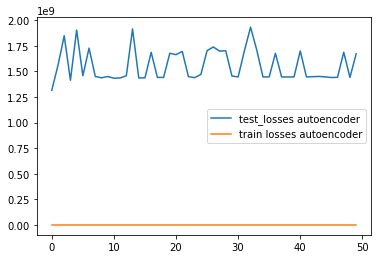

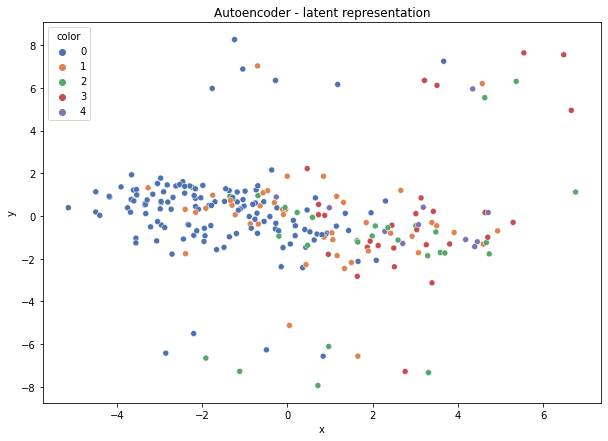

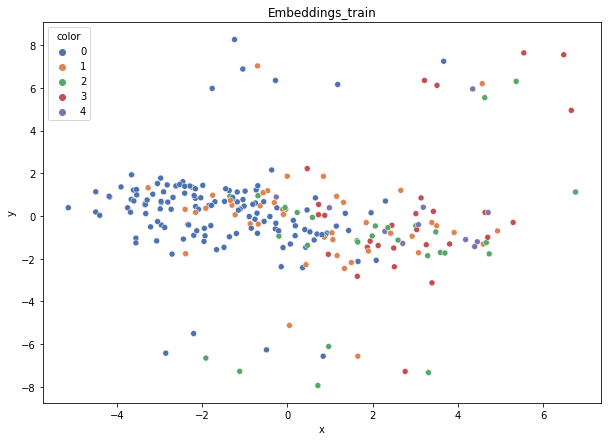

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.291
DT-f1-old+new-features: 0.272
DT-f1-old-features: 0.227
DT-gmean-new-features: 0.095
DT-gmean-old+new-features: 0.091
DT-gmean-old-features: 0.03
DT-minority_gmean-new-features: 0.025
DT-minority_gmean-old+new-features: 0.025
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.256
KNN-f1-old+new-features: 0.263
KNN-f1-old-features: 0.275
KNN-gmean-new-features: 0.033
KNN-gmean-old+new-features: 0.033
KNN-gmean-old-features: 0.035
KNN-minority_gmean-new-features: 0.009
KNN-minority_gmean-old+new-features: 0.009
KNN-minority_gmean-old-features: 0.009
cleveland_v2


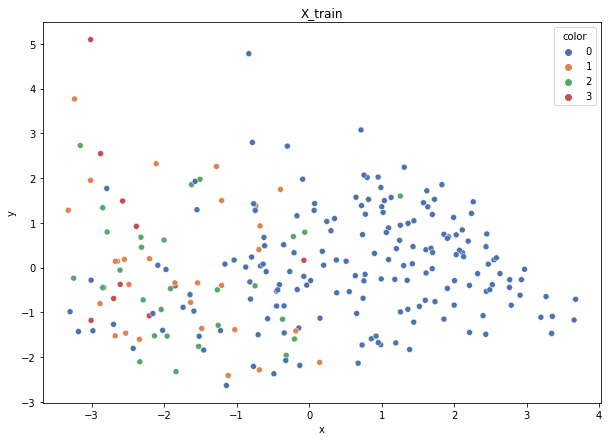

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 10})
Weights: {0: 0.032483898067768135, 1: 0.19602352282273874, 2: 0.20302436292355083, 3: 0.5684682161859423}
Training autoencoder...


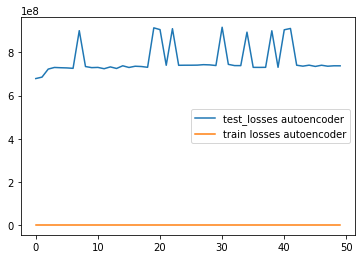

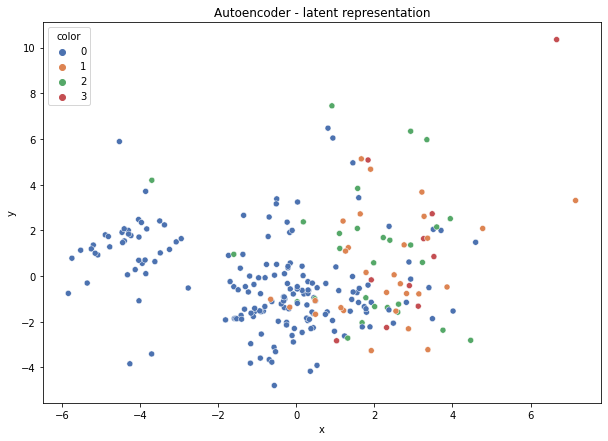

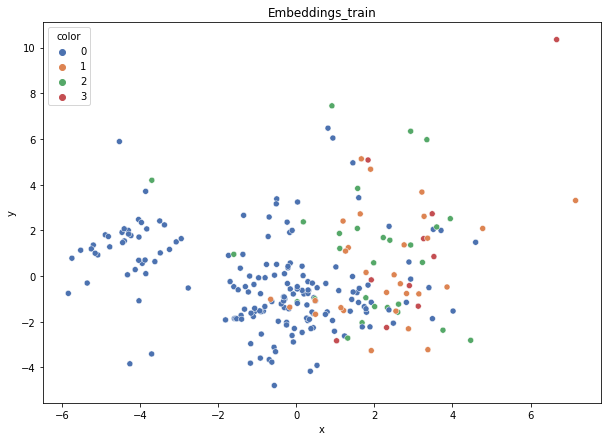

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.334
DT-f1-old+new-features: 0.308
DT-f1-old-features: 0.358
DT-gmean-new-features: 0.083
DT-gmean-old+new-features: 0.075
DT-gmean-old-features: 0.099
DT-minority_gmean-new-features: 0.016
DT-minority_gmean-old+new-features: 0.014
DT-minority_gmean-old-features: 0.019
KNN-f1-new-features: 0.245
KNN-f1-old+new-features: 0.245
KNN-f1-old-features: 0.238
KNN-gmean-new-features: 0.019
KNN-gmean-old+new-features: 0.019
KNN-gmean-old-features: 0.018
KNN-minority_gmean-new-features: 0.003
KNN-minority_gmean-old+new-features: 0.003
KNN-minority_gmean-old-features: 0.003


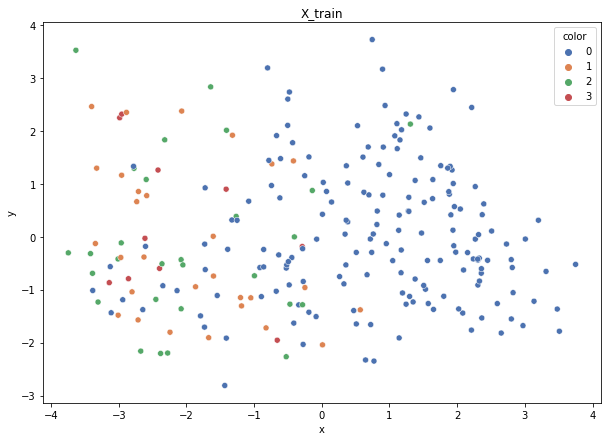

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 10})
Weights: {0: 0.032483898067768135, 1: 0.19602352282273874, 2: 0.20302436292355083, 3: 0.5684682161859423}
Training autoencoder...


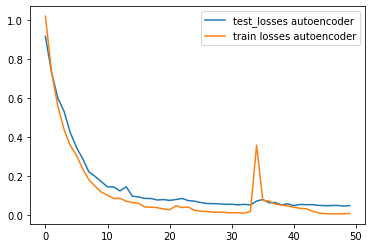

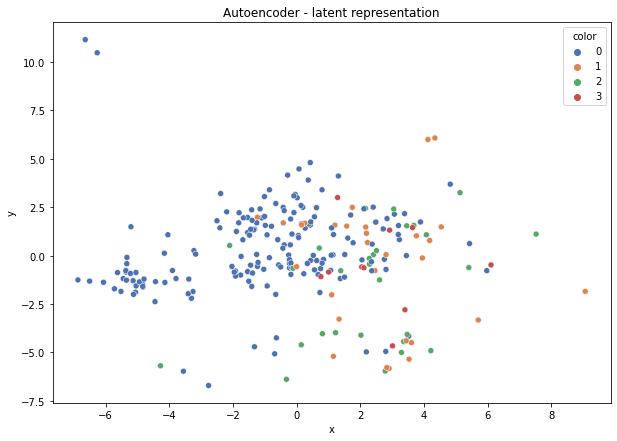

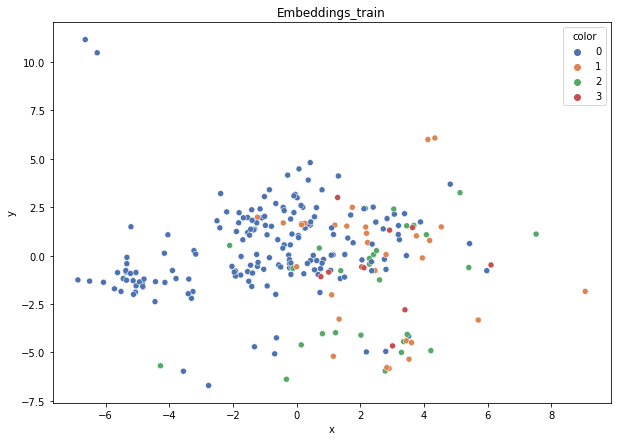

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.298
DT-f1-old+new-features: 0.336
DT-f1-old-features: 0.484
DT-gmean-new-features: 0.075
DT-gmean-old+new-features: 0.089
DT-gmean-old-features: 0.546
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.017
DT-minority_gmean-old-features: 0.105
KNN-f1-new-features: 0.363
KNN-f1-old+new-features: 0.363
KNN-f1-old-features: 0.39
KNN-gmean-new-features: 0.099
KNN-gmean-old+new-features: 0.099
KNN-gmean-old-features: 0.11
KNN-minority_gmean-new-features: 0.019
KNN-minority_gmean-old+new-features: 0.019
KNN-minority_gmean-old-features: 0.021


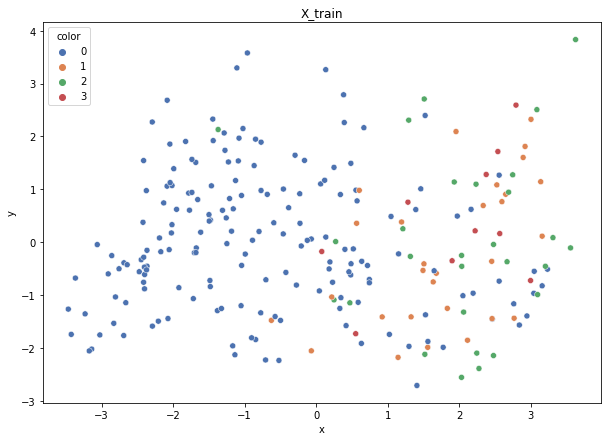

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 10})
Weights: {0: 0.032483898067768135, 1: 0.19602352282273874, 2: 0.20302436292355083, 3: 0.5684682161859423}
Training autoencoder...


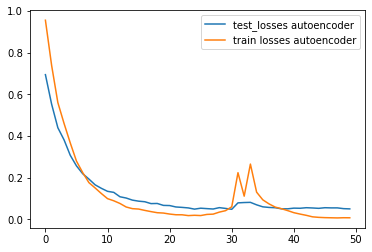

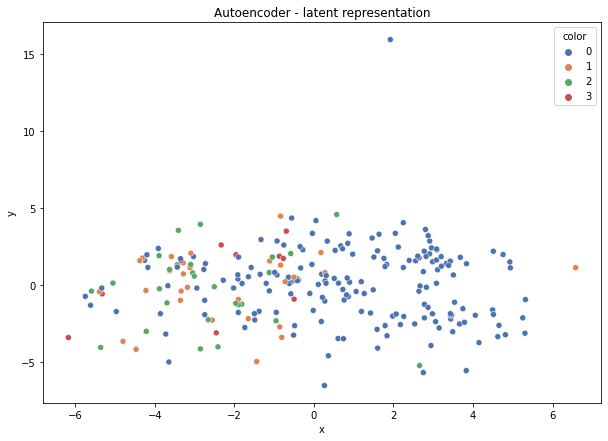

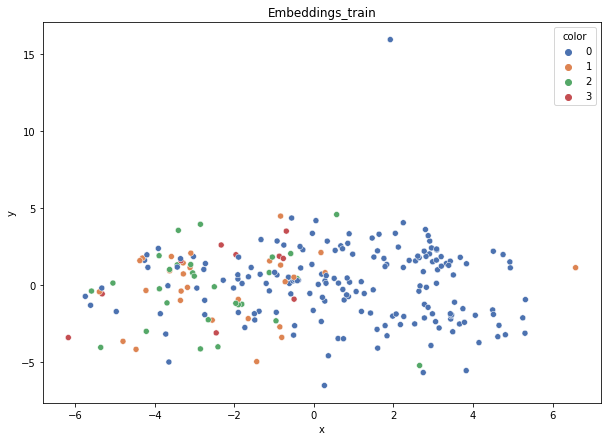

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.252
DT-f1-old+new-features: 0.258
DT-f1-old-features: 0.295
DT-gmean-new-features: 0.019
DT-gmean-old+new-features: 0.019
DT-gmean-old-features: 0.075
DT-minority_gmean-new-features: 0.003
DT-minority_gmean-old+new-features: 0.003
DT-minority_gmean-old-features: 0.014
KNN-f1-new-features: 0.293
KNN-f1-old+new-features: 0.295
KNN-f1-old-features: 0.356
KNN-gmean-new-features: 0.023
KNN-gmean-old+new-features: 0.023
KNN-gmean-old-features: 0.079
KNN-minority_gmean-new-features: 0.004
KNN-minority_gmean-old+new-features: 0.004
KNN-minority_gmean-old-features: 0.014


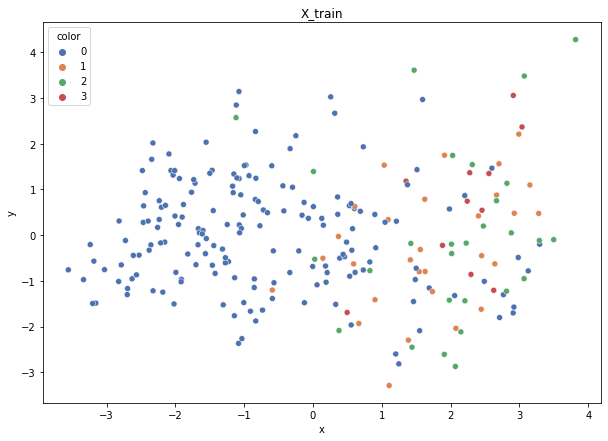

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 11})
Weights: {1: 0.20670586024536255, 0: 0.03425411398351722, 2: 0.21408821239698264, 3: 0.5449518133741377}
Training autoencoder...


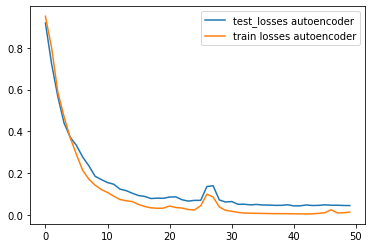

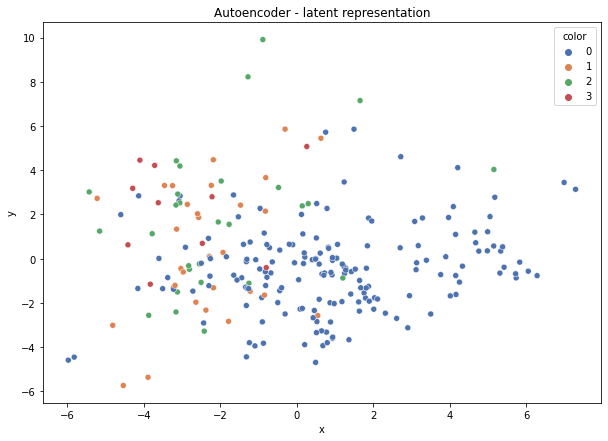

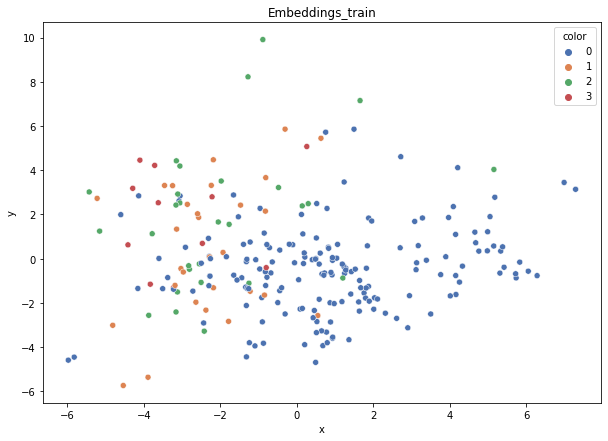

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.334
DT-f1-old+new-features: 0.336
DT-f1-old-features: 0.238
DT-gmean-new-features: 0.078
DT-gmean-old+new-features: 0.09
DT-gmean-old-features: 0.018
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.017
DT-minority_gmean-old-features: 0.003
KNN-f1-new-features: 0.314
KNN-f1-old+new-features: 0.305
KNN-f1-old-features: 0.283
KNN-gmean-new-features: 0.025
KNN-gmean-old+new-features: 0.025
KNN-gmean-old-features: 0.022
KNN-minority_gmean-new-features: 0.005
KNN-minority_gmean-old+new-features: 0.005
KNN-minority_gmean-old-features: 0.004


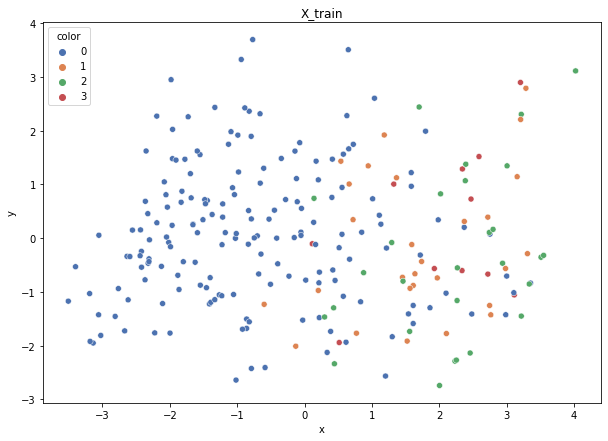

Class cardinalities: Counter({0: 176, 1: 28, 2: 28, 3: 11})
Weights: {0: 0.03381642512077295, 1: 0.21256038647342995, 2: 0.21256038647342995, 3: 0.5410628019323672}
Training autoencoder...


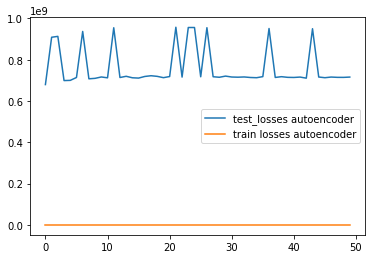

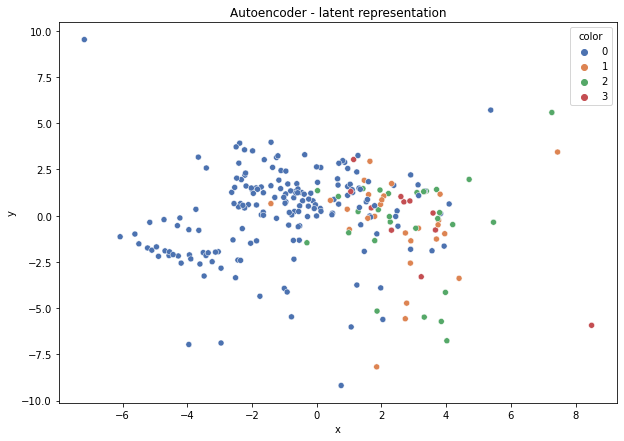

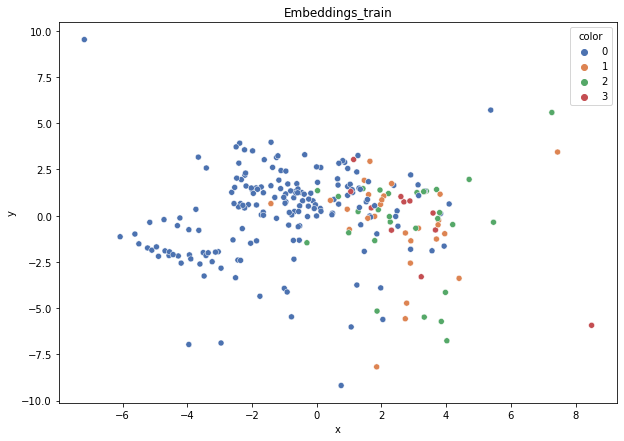

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.227
DT-f1-old+new-features: 0.457
DT-f1-old-features: 0.335
DT-gmean-new-features: 0.017
DT-gmean-old+new-features: 0.46
DT-gmean-old-features: 0.092
DT-minority_gmean-new-features: 0.003
DT-minority_gmean-old+new-features: 0.086
DT-minority_gmean-old-features: 0.018
KNN-f1-new-features: 0.337
KNN-f1-old+new-features: 0.328
KNN-f1-old-features: 0.37
KNN-gmean-new-features: 0.081
KNN-gmean-old+new-features: 0.08
KNN-gmean-old-features: 0.096
KNN-minority_gmean-new-features: 0.015
KNN-minority_gmean-old+new-features: 0.015
KNN-minority_gmean-old-features: 0.018
glass


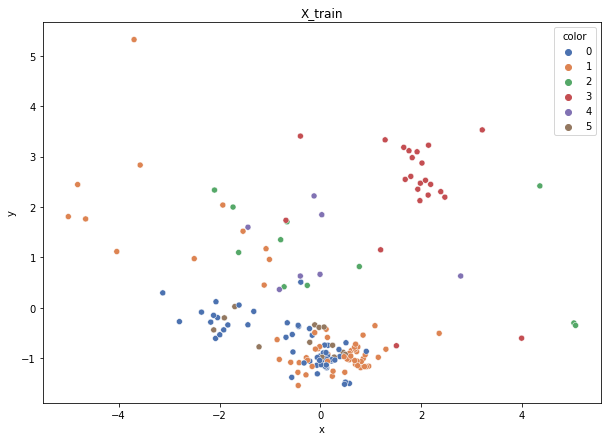

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 13, 2: 11, 4: 7})
Weights: {0: 0.04597401674853029, 1: 0.042205654719962245, 3: 0.1119367364312042, 5: 0.1980419183013613, 2: 0.2340495398106997, 4: 0.36779213398824234}
Training autoencoder...


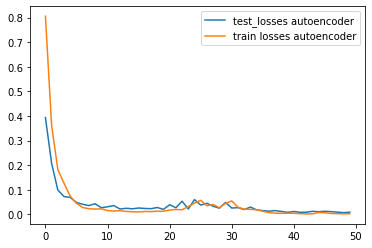

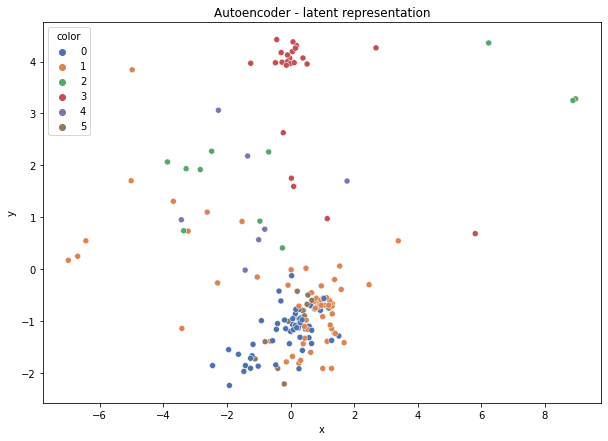

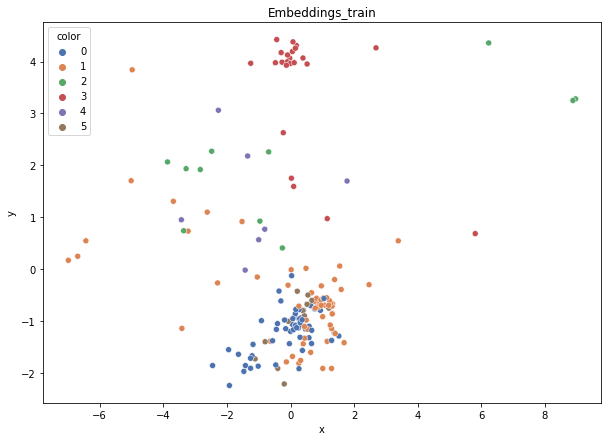

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.616
DT-f1-old+new-features: 0.543
DT-f1-old-features: 0.711
DT-gmean-new-features: 0.229
DT-gmean-old+new-features: 0.196
DT-gmean-old-features: 0.742
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.012
DT-minority_gmean-old-features: 0.165
KNN-f1-new-features: 0.737
KNN-f1-old+new-features: 0.737
KNN-f1-old-features: 0.747
KNN-gmean-new-features: 0.691
KNN-gmean-old+new-features: 0.691
KNN-gmean-old-features: 0.701
KNN-minority_gmean-new-features: 0.048
KNN-minority_gmean-old+new-features: 0.048
KNN-minority_gmean-old-features: 0.048


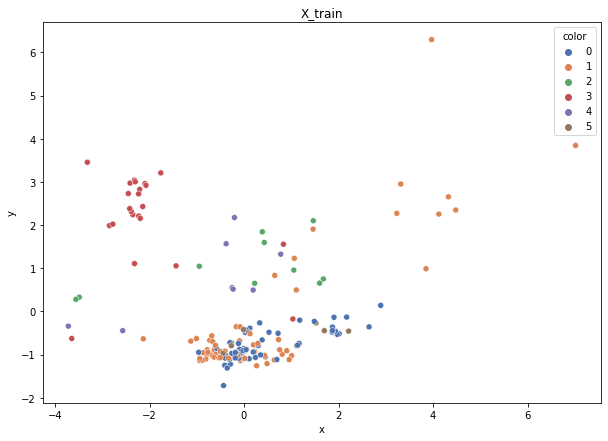

Class cardinalities: Counter({1: 60, 0: 56, 3: 24, 5: 13, 2: 10, 4: 8})
Weights: {5: 0.2034390893678857, 4: 0.33058852022281426, 1: 0.0440784693630419, 0: 0.047226931460402036, 3: 0.11019617340760475, 2: 0.2644708161782514}
Training autoencoder...


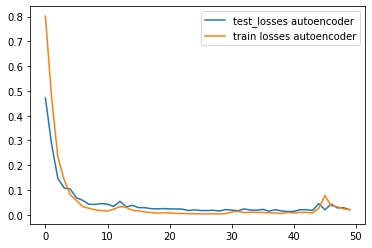

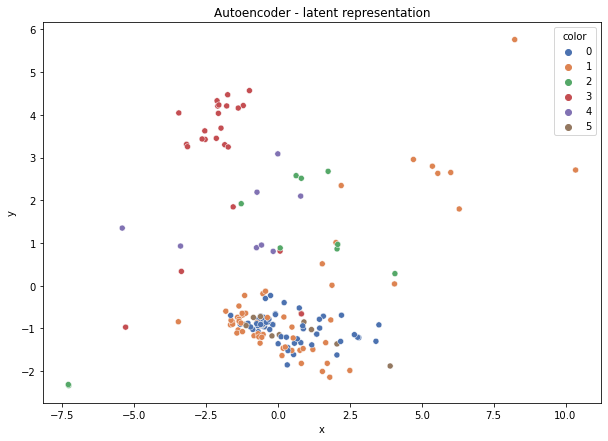

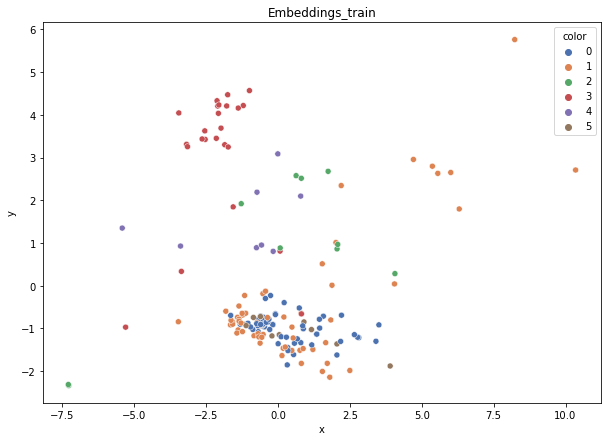

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.412
DT-f1-old+new-features: 0.665
DT-f1-old-features: 0.53
DT-gmean-new-features: 0.081
DT-gmean-old+new-features: 0.671
DT-gmean-old-features: 0.232
DT-minority_gmean-new-features: 0.003
DT-minority_gmean-old+new-features: 0.023
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.478
KNN-f1-old+new-features: 0.47
KNN-f1-old-features: 0.568
KNN-gmean-new-features: 0.179
KNN-gmean-old+new-features: 0.179
KNN-gmean-old-features: 0.557
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.021


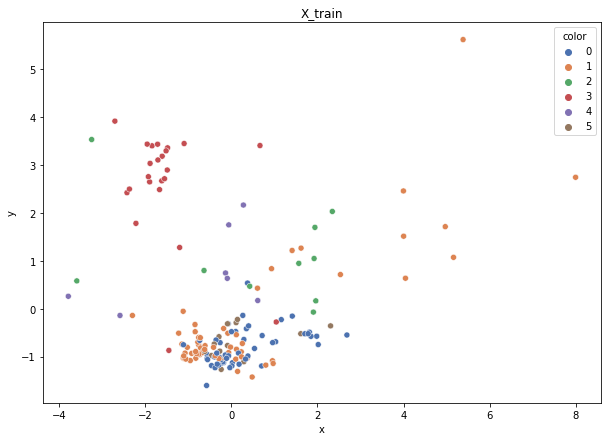

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 14, 2: 10, 4: 7})
Weights: {0: 0.04555224384573926, 5: 0.18220897538295705, 4: 0.3644179507659141, 1: 0.04181845336658031, 3: 0.11090981110266952, 2: 0.2550925655361399}
Training autoencoder...


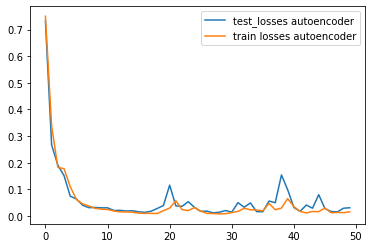

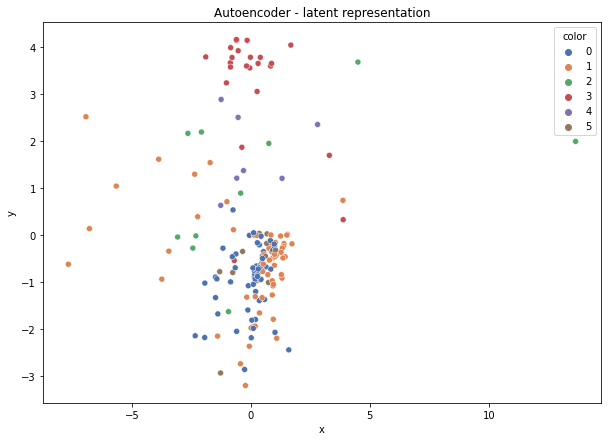

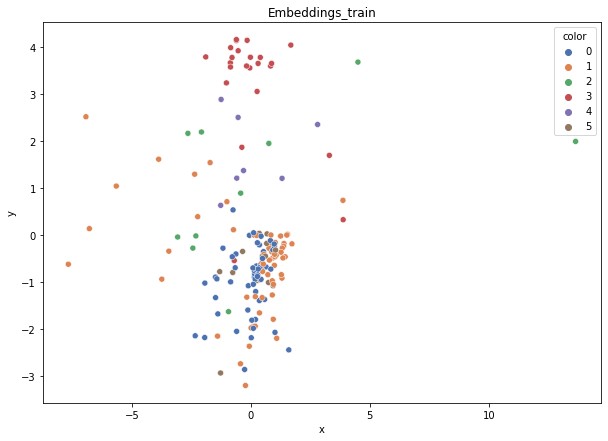

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.778
DT-f1-old+new-features: 0.783
DT-f1-old-features: 0.607
DT-gmean-new-features: 0.772
DT-gmean-old+new-features: 0.806
DT-gmean-old-features: 0.25
DT-minority_gmean-new-features: 0.161
DT-minority_gmean-old+new-features: 0.161
DT-minority_gmean-old-features: 0.032
KNN-f1-new-features: 0.598
KNN-f1-old+new-features: 0.661
KNN-f1-old-features: 0.661
KNN-gmean-new-features: 0.23
KNN-gmean-old+new-features: 0.246
KNN-gmean-old-features: 0.246
KNN-minority_gmean-new-features: 0.013
KNN-minority_gmean-old+new-features: 0.014
KNN-minority_gmean-old-features: 0.014


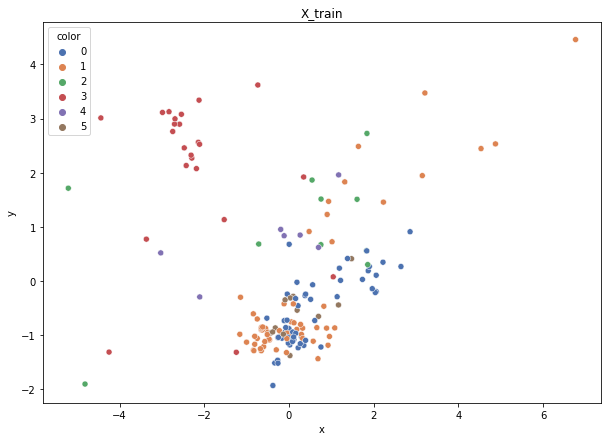

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 14, 2: 10, 4: 7})
Weights: {0: 0.04555224384573926, 5: 0.18220897538295705, 4: 0.3644179507659141, 1: 0.04181845336658031, 3: 0.11090981110266952, 2: 0.2550925655361399}
Training autoencoder...


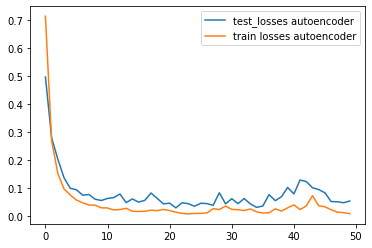

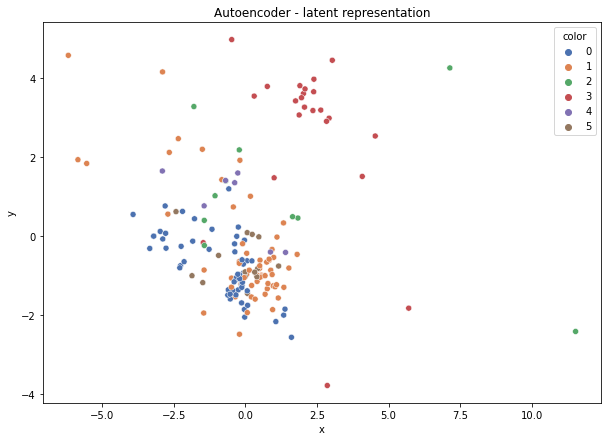

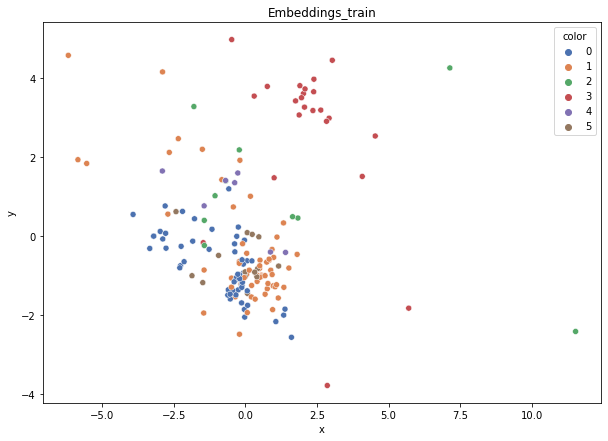

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.645
DT-f1-old+new-features: 0.675
DT-f1-old-features: 0.646
DT-gmean-new-features: 0.651
DT-gmean-old+new-features: 0.663
DT-gmean-old-features: 0.681
DT-minority_gmean-new-features: 0.122
DT-minority_gmean-old+new-features: 0.047
DT-minority_gmean-old-features: 0.161
KNN-f1-new-features: 0.704
KNN-f1-old+new-features: 0.669
KNN-f1-old-features: 0.641
KNN-gmean-new-features: 0.651
KNN-gmean-old+new-features: 0.609
KNN-gmean-old-features: 0.587
KNN-minority_gmean-new-features: 0.044
KNN-minority_gmean-old+new-features: 0.041
KNN-minority_gmean-old-features: 0.041


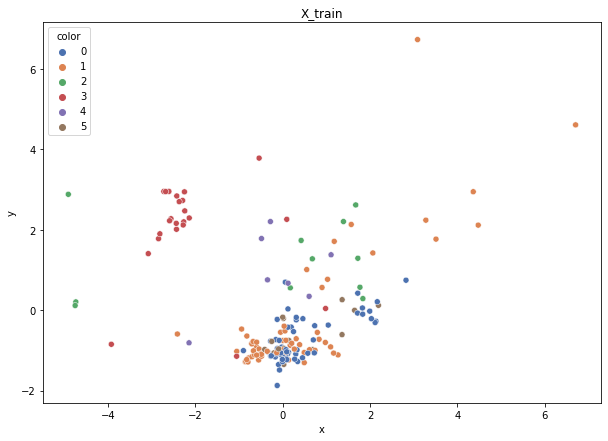

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 14, 2: 11, 4: 7})
Weights: {0: 0.04663368999308034, 5: 0.18653475997232136, 4: 0.3730695199446427, 1: 0.04281125638709015, 3: 0.11354289737445648, 2: 0.237407876328409}
Training autoencoder...


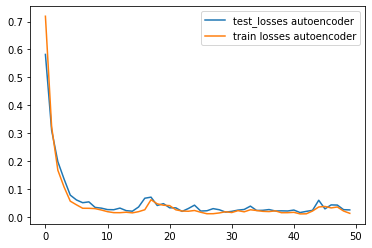

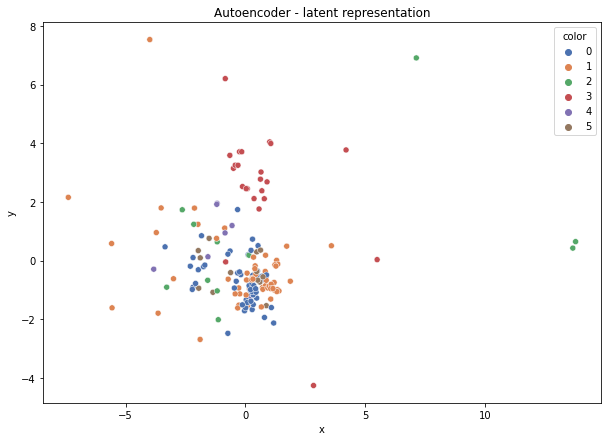

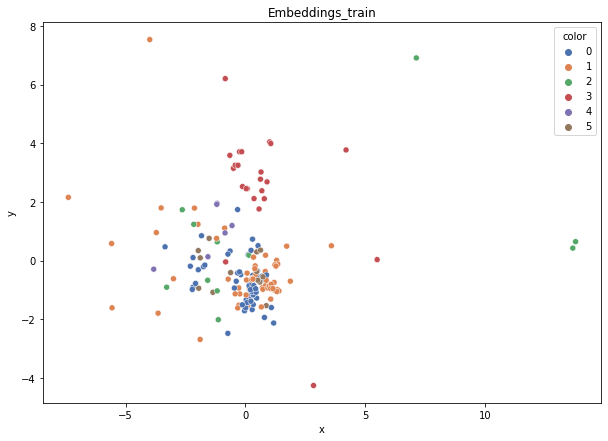

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.519
DT-f1-old+new-features: 0.689
DT-f1-old-features: 0.73
DT-gmean-new-features: 0.536
DT-gmean-old+new-features: 0.632
DT-gmean-old-features: 0.737
DT-minority_gmean-new-features: 0.021
DT-minority_gmean-old+new-features: 0.044
DT-minority_gmean-old-features: 0.051
KNN-f1-new-features: 0.691
KNN-f1-old+new-features: 0.703
KNN-f1-old-features: 0.678
KNN-gmean-new-features: 0.697
KNN-gmean-old+new-features: 0.709
KNN-gmean-old-features: 0.681
KNN-minority_gmean-new-features: 0.051
KNN-minority_gmean-old+new-features: 0.051
KNN-minority_gmean-old-features: 0.051
new_ecoli


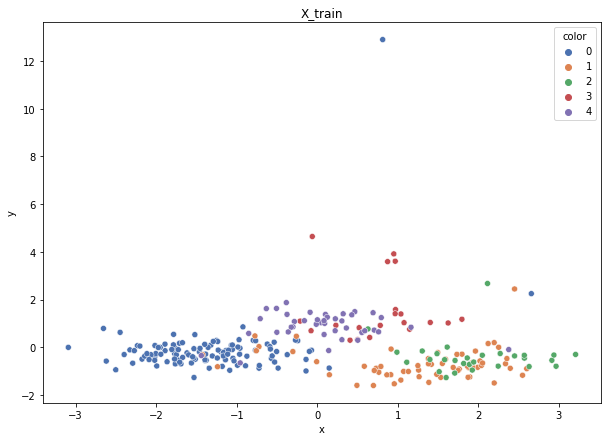

Class cardinalities: Counter({0: 116, 1: 61, 4: 41, 2: 30, 3: 20})
Weights: {0: 0.0649452946471851, 1: 0.1235025275257946, 2: 0.2511218059691157, 3: 0.37668270895367356, 4: 0.183747662904231}
Training autoencoder...


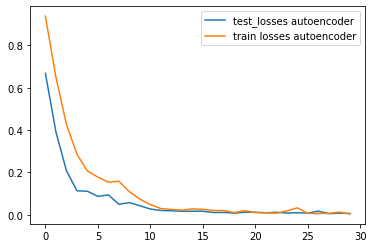

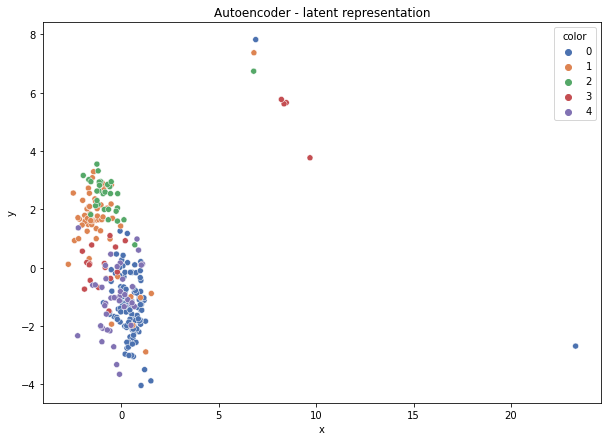

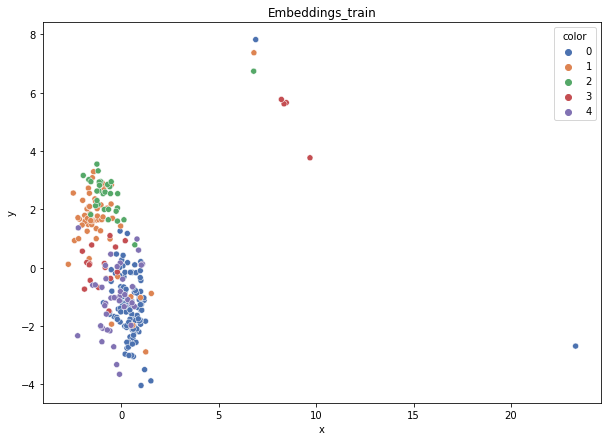

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.714
DT-f1-old+new-features: 0.761
DT-f1-old-features: 0.634
DT-gmean-new-features: 0.749
DT-gmean-old+new-features: 0.802
DT-gmean-old-features: 0.537
DT-minority_gmean-new-features: 0.746
DT-minority_gmean-old+new-features: 0.057
DT-minority_gmean-old-features: 0.04
KNN-f1-new-features: 0.746
KNN-f1-old+new-features: 0.773
KNN-f1-old-features: 0.749
KNN-gmean-new-features: 0.685
KNN-gmean-old+new-features: 0.743
KNN-gmean-old-features: 0.719
KNN-minority_gmean-new-features: 0.048
KNN-minority_gmean-old+new-features: 0.052
KNN-minority_gmean-old-features: 0.05


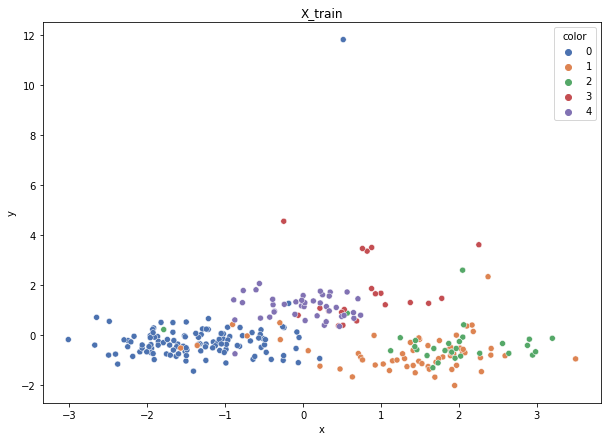

Class cardinalities: Counter({0: 116, 1: 61, 4: 42, 2: 30, 3: 20})
Weights: {0: 0.06523067522150933, 1: 0.12404521845401774, 2: 0.25222527752316937, 3: 0.3783379162847541, 4: 0.18016091251654956}
Training autoencoder...


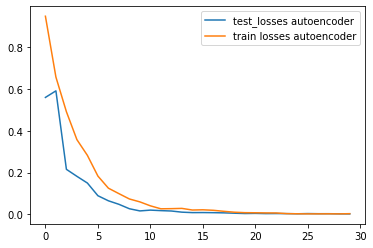

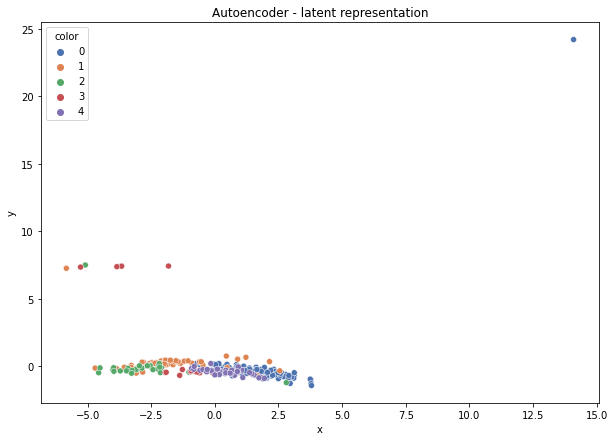

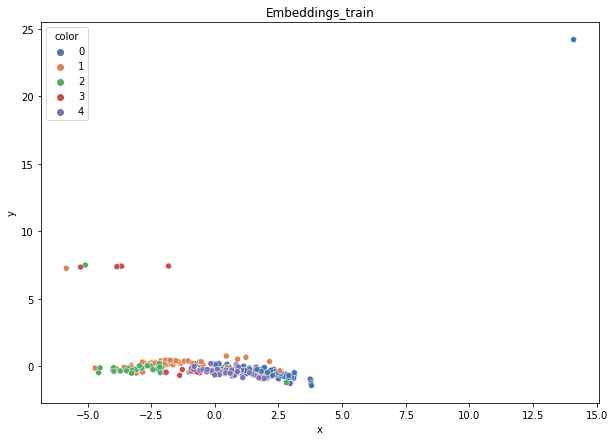

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.761
DT-f1-old+new-features: 0.724
DT-f1-old-features: 0.707
DT-gmean-new-features: 0.725
DT-gmean-old+new-features: 0.699
DT-gmean-old-features: 0.688
DT-minority_gmean-new-features: 0.049
DT-minority_gmean-old+new-features: 0.047
DT-minority_gmean-old-features: 0.049
KNN-f1-new-features: 0.725
KNN-f1-old+new-features: 0.721
KNN-f1-old-features: 0.728
KNN-gmean-new-features: 0.701
KNN-gmean-old+new-features: 0.693
KNN-gmean-old-features: 0.709
KNN-minority_gmean-new-features: 0.049
KNN-minority_gmean-old+new-features: 0.049
KNN-minority_gmean-old-features: 0.051


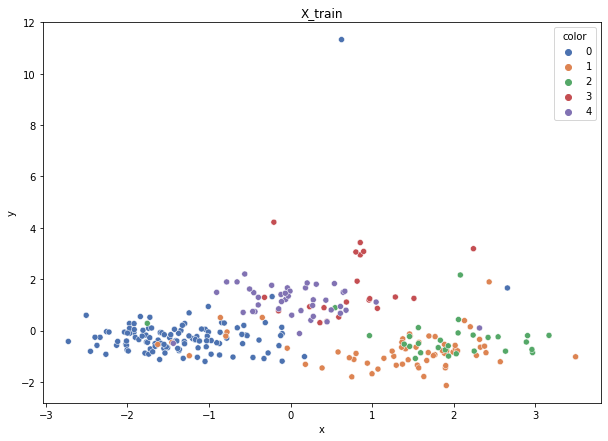

Class cardinalities: Counter({0: 116, 1: 62, 4: 42, 2: 29, 3: 20})
Weights: {0: 0.06479675120436358, 1: 0.12123263128558347, 2: 0.2591870048174543, 3: 0.37582115698530877, 4: 0.17896245570728986}
Training autoencoder...


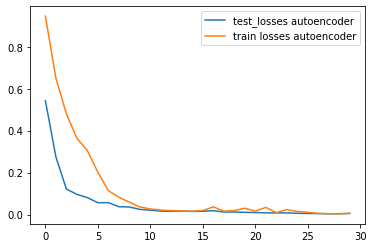

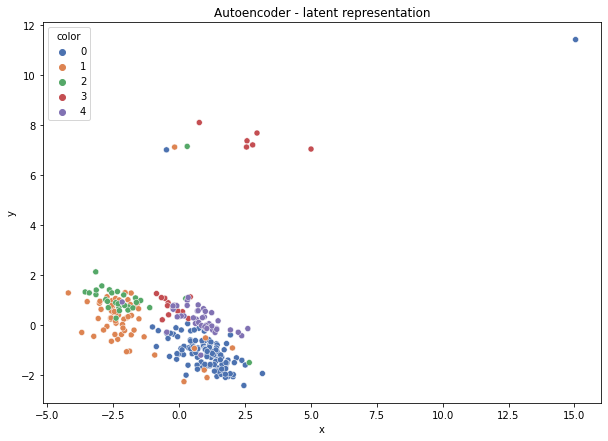

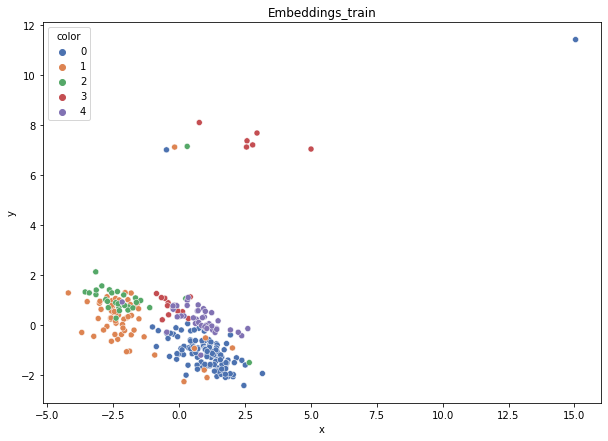

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.679
DT-f1-old+new-features: 0.773
DT-f1-old-features: 0.722
DT-gmean-new-features: 0.564
DT-gmean-old+new-features: 0.779
DT-gmean-old-features: 0.69
DT-minority_gmean-new-features: 0.039
DT-minority_gmean-old+new-features: 0.053
DT-minority_gmean-old-features: 0.046
KNN-f1-new-features: 0.862
KNN-f1-old+new-features: 0.862
KNN-f1-old-features: 0.862
KNN-gmean-new-features: 0.815
KNN-gmean-old+new-features: 0.815
KNN-gmean-old-features: 0.815
KNN-minority_gmean-new-features: 0.053
KNN-minority_gmean-old+new-features: 0.053
KNN-minority_gmean-old-features: 0.053


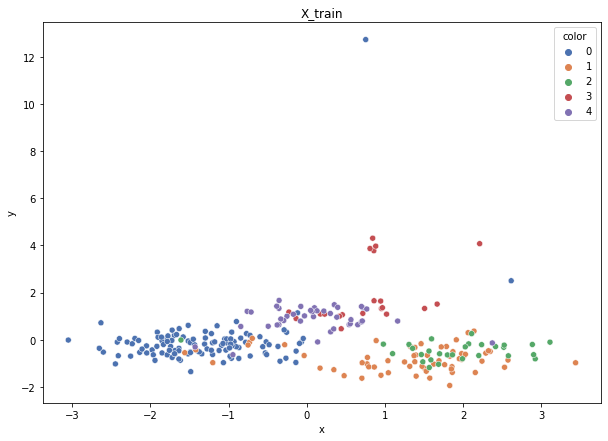

Class cardinalities: Counter({0: 116, 1: 62, 4: 42, 2: 29, 3: 20})
Weights: {0: 0.06479675120436358, 1: 0.12123263128558347, 2: 0.2591870048174543, 3: 0.37582115698530877, 4: 0.17896245570728986}
Training autoencoder...


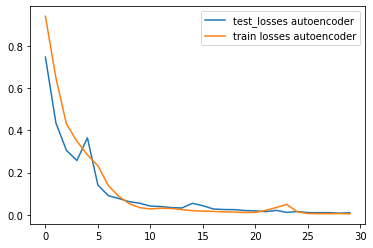

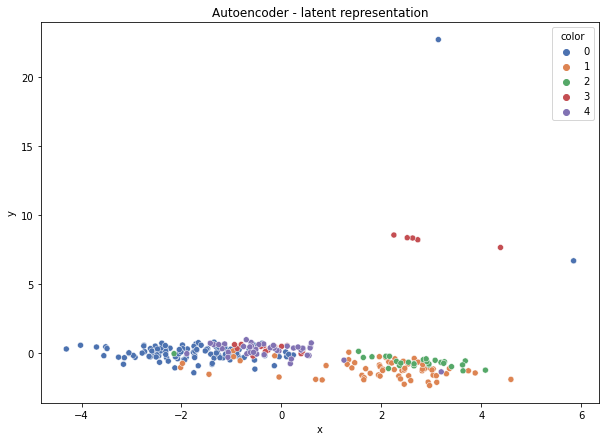

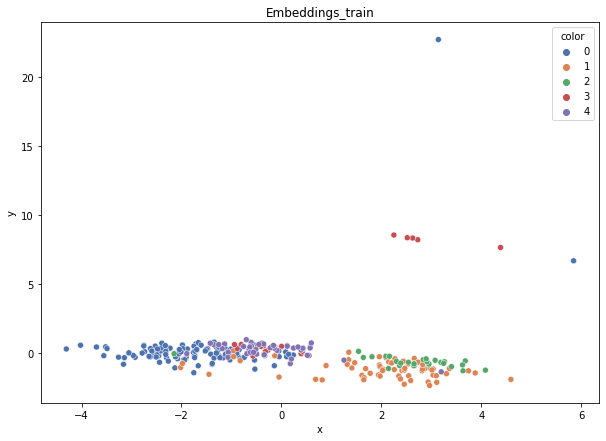

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.652
DT-f1-old+new-features: 0.675
DT-f1-old-features: 0.649
DT-gmean-new-features: 0.642
DT-gmean-old+new-features: 0.639
DT-gmean-old-features: 0.606
DT-minority_gmean-new-features: 0.049
DT-minority_gmean-old+new-features: 0.044
DT-minority_gmean-old-features: 0.105
KNN-f1-new-features: 0.763
KNN-f1-old+new-features: 0.775
KNN-f1-old-features: 0.817
KNN-gmean-new-features: 0.71
KNN-gmean-old+new-features: 0.736
KNN-gmean-old-features: 0.782
KNN-minority_gmean-new-features: 0.05
KNN-minority_gmean-old+new-features: 0.051
KNN-minority_gmean-old-features: 0.053


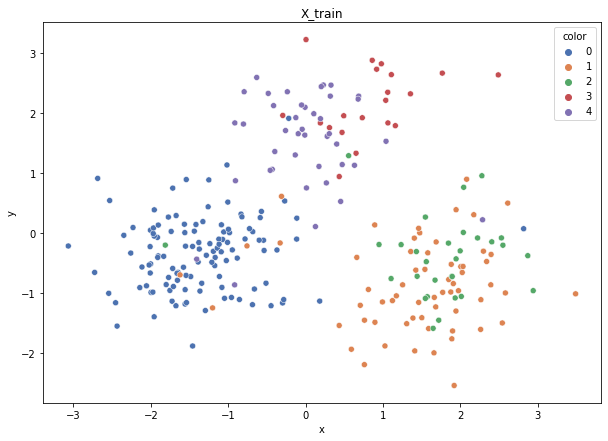

Class cardinalities: Counter({0: 116, 1: 62, 4: 41, 2: 30, 3: 20})
Weights: {0: 0.06507492234699798, 1: 0.12175308052018977, 2: 0.25162303307505884, 3: 0.3774345496125883, 4: 0.18411441444516502}
Training autoencoder...


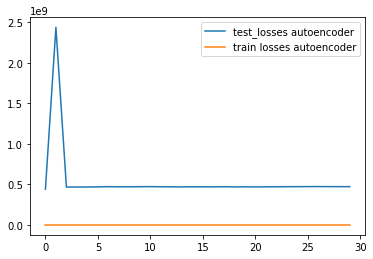

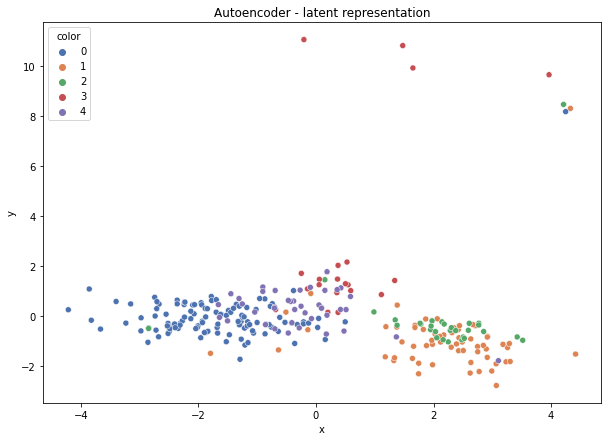

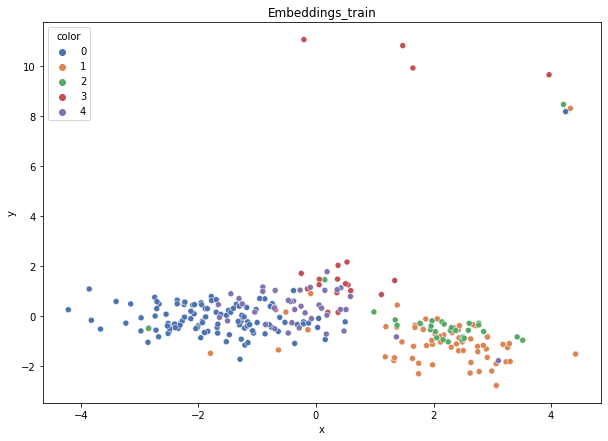

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.783
DT-f1-old+new-features: 0.779
DT-f1-old-features: 0.793
DT-gmean-new-features: 0.807
DT-gmean-old+new-features: 0.791
DT-gmean-old-features: 0.822
DT-minority_gmean-new-features: 0.151
DT-minority_gmean-old+new-features: 0.147
DT-minority_gmean-old-features: 0.155
KNN-f1-new-features: 0.785
KNN-f1-old+new-features: 0.796
KNN-f1-old-features: 0.808
KNN-gmean-new-features: 0.785
KNN-gmean-old+new-features: 0.791
KNN-gmean-old-features: 0.84
KNN-minority_gmean-new-features: 0.143
KNN-minority_gmean-old+new-features: 0.143
KNN-minority_gmean-old-features: 0.155
new_led7digit


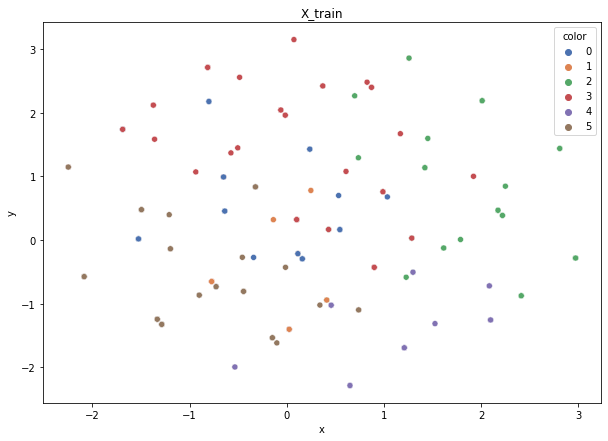

Class cardinalities: Counter({3: 87, 5: 79, 0: 78, 2: 75, 4: 41, 1: 40})
Weights: {0: 0.12859532399632337, 2: 0.1337391369561763, 3: 0.11529235944497956, 4: 0.24464476272471275, 5: 0.1269675350849775, 1: 0.25076088179283057}
Training autoencoder...


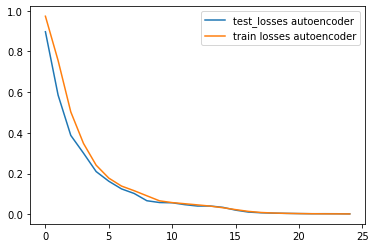

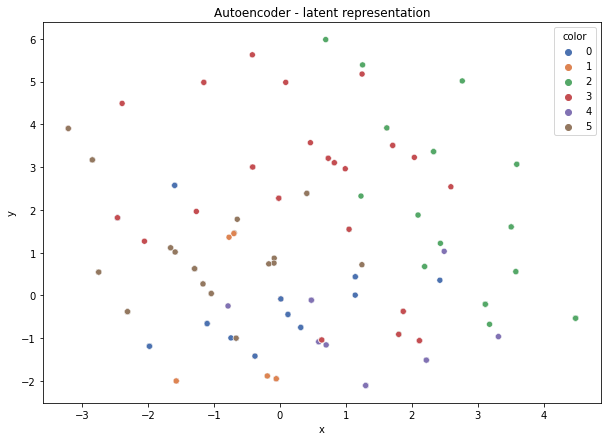

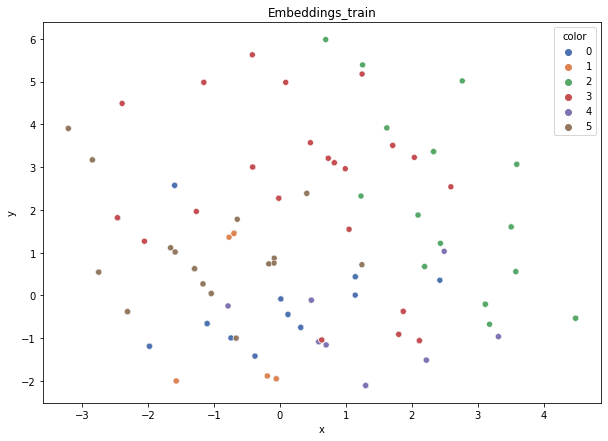

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.744
DT-f1-old+new-features: 0.777
DT-f1-old-features: 0.789
DT-gmean-new-features: 0.747
DT-gmean-old+new-features: 0.78
DT-gmean-old-features: 0.797
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.014
DT-minority_gmean-old-features: 0.014
KNN-f1-new-features: 0.72
KNN-f1-old+new-features: 0.734
KNN-f1-old-features: 0.741
KNN-gmean-new-features: 0.712
KNN-gmean-old+new-features: 0.731
KNN-gmean-old-features: 0.719
KNN-minority_gmean-new-features: 0.013
KNN-minority_gmean-old+new-features: 0.013
KNN-minority_gmean-old-features: 0.008


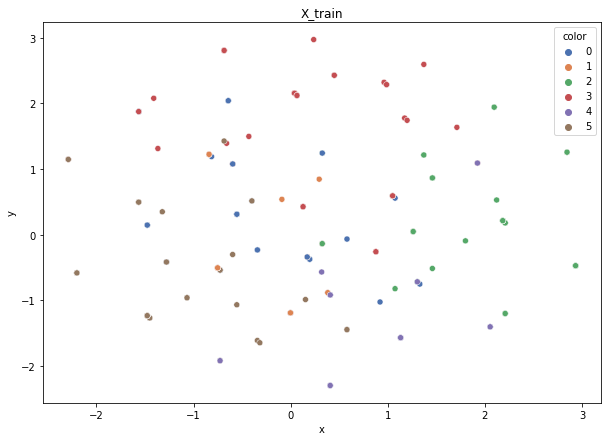

Class cardinalities: Counter({3: 87, 5: 80, 0: 78, 2: 75, 4: 41, 1: 39})
Weights: {0: 0.1279755802357915, 2: 0.13309460344522317, 3: 0.114736727107951, 4: 0.2434657380095546, 5: 0.12477619072989674, 1: 0.255951160471583}
Training autoencoder...


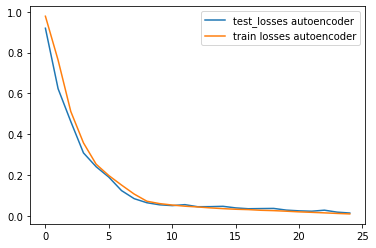

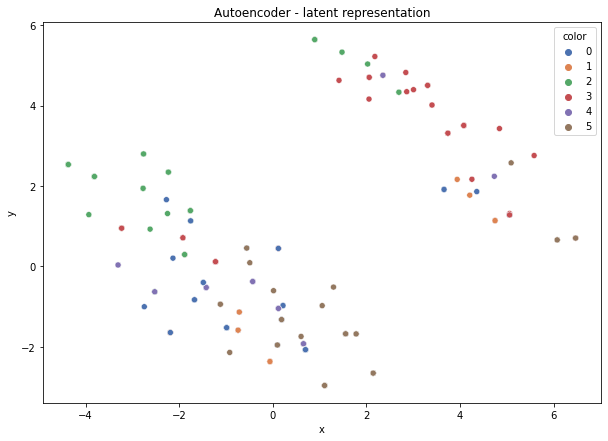

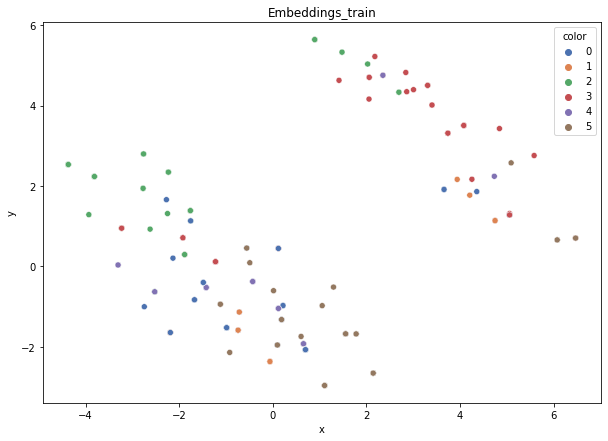

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.719
DT-f1-old+new-features: 0.743
DT-f1-old-features: 0.779
DT-gmean-new-features: 0.696
DT-gmean-old+new-features: 0.713
DT-gmean-old-features: 0.755
DT-minority_gmean-new-features: 0.008
DT-minority_gmean-old+new-features: 0.008
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.757
KNN-f1-old+new-features: 0.781
KNN-f1-old-features: 0.692
KNN-gmean-new-features: 0.715
KNN-gmean-old+new-features: 0.74
KNN-gmean-old-features: 0.283
KNN-minority_gmean-new-features: 0.008
KNN-minority_gmean-old+new-features: 0.012
KNN-minority_gmean-old-features: 0.004


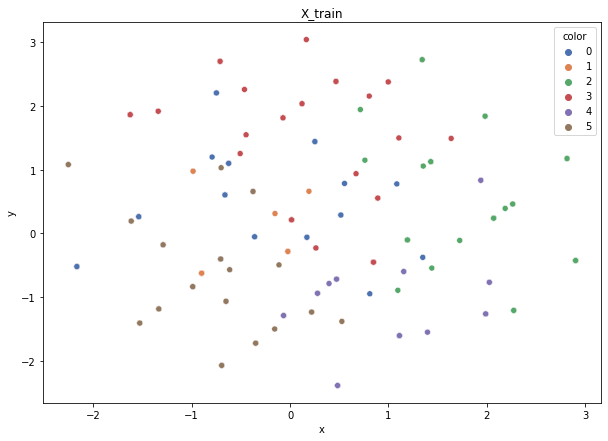

Class cardinalities: Counter({3: 86, 5: 79, 0: 78, 2: 76, 4: 42, 1: 39})
Weights: {0: 0.12857143873483481, 2: 0.1319548976489094, 3: 0.11661130489903622, 4: 0.23877552907897892, 5: 0.12694395216857107, 1: 0.25714287746966963}
Training autoencoder...


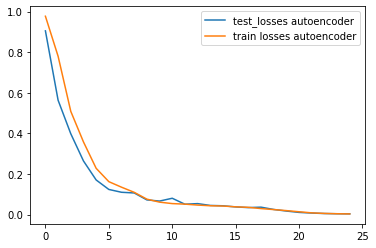

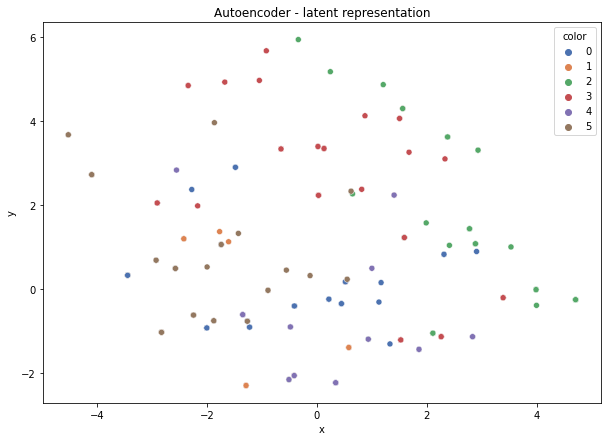

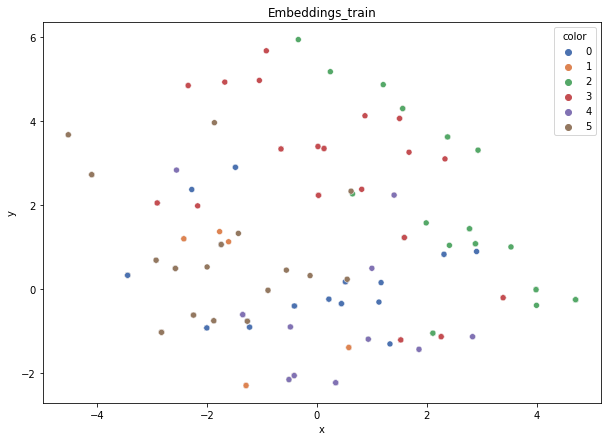

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.774
DT-f1-old+new-features: 0.776
DT-f1-old-features: 0.782
DT-gmean-new-features: 0.776
DT-gmean-old+new-features: 0.783
DT-gmean-old-features: 0.783
DT-minority_gmean-new-features: 0.081
DT-minority_gmean-old+new-features: 0.084
DT-minority_gmean-old-features: 0.081
KNN-f1-new-features: 0.713
KNN-f1-old+new-features: 0.713
KNN-f1-old-features: 0.739
KNN-gmean-new-features: 0.699
KNN-gmean-old+new-features: 0.699
KNN-gmean-old-features: 0.739
KNN-minority_gmean-new-features: 0.079
KNN-minority_gmean-old+new-features: 0.079
KNN-minority_gmean-old-features: 0.081


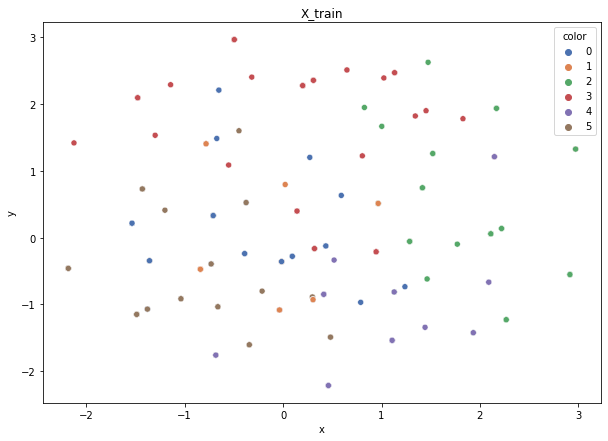

Class cardinalities: Counter({3: 86, 0: 79, 5: 79, 2: 75, 4: 42, 1: 39})
Weights: {0: 0.12692720893782067, 2: 0.13369666008117112, 3: 0.11659592448939342, 4: 0.23874403585923412, 5: 0.12692720893782067, 1: 0.2571089616945598}
Training autoencoder...


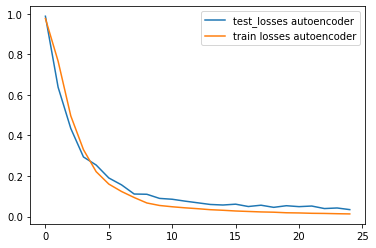

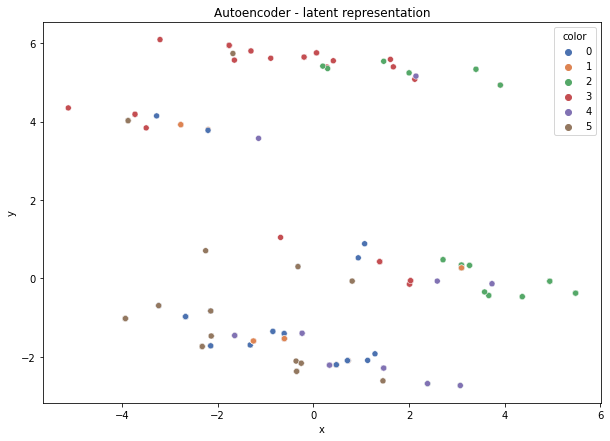

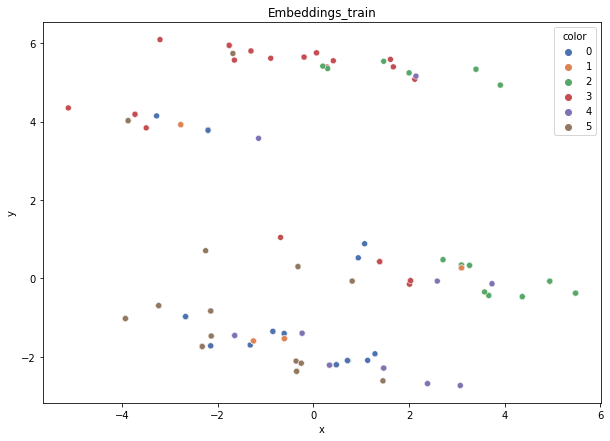

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.707
DT-f1-old+new-features: 0.701
DT-f1-old-features: 0.716
DT-gmean-new-features: 0.7
DT-gmean-old+new-features: 0.686
DT-gmean-old-features: 0.698
DT-minority_gmean-new-features: 0.03
DT-minority_gmean-old+new-features: 0.03
DT-minority_gmean-old-features: 0.03
KNN-f1-new-features: 0.705
KNN-f1-old+new-features: 0.713
KNN-f1-old-features: 0.714
KNN-gmean-new-features: 0.679
KNN-gmean-old+new-features: 0.689
KNN-gmean-old-features: 0.704
KNN-minority_gmean-new-features: 0.014
KNN-minority_gmean-old+new-features: 0.014
KNN-minority_gmean-old-features: 0.029


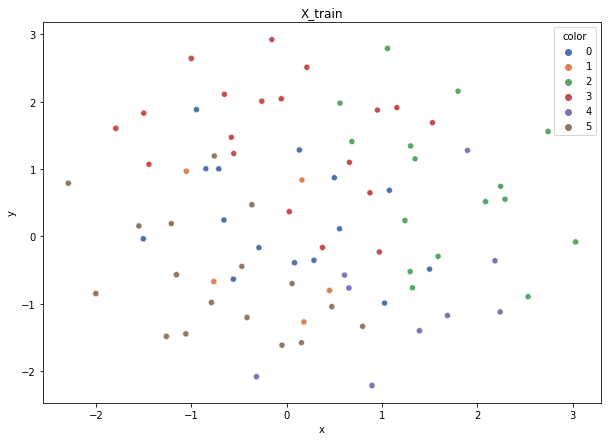

Class cardinalities: Counter({3: 86, 0: 79, 5: 79, 2: 75, 4: 42, 1: 39})
Weights: {0: 0.12692720893782067, 2: 0.13369666008117112, 3: 0.11659592448939342, 4: 0.23874403585923412, 5: 0.12692720893782067, 1: 0.2571089616945598}
Training autoencoder...


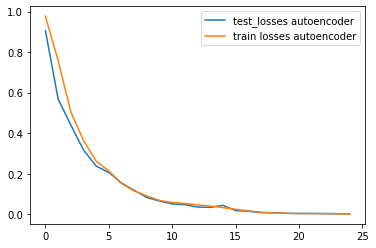

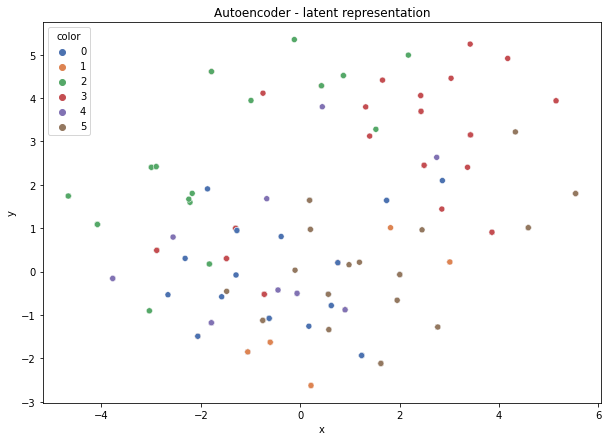

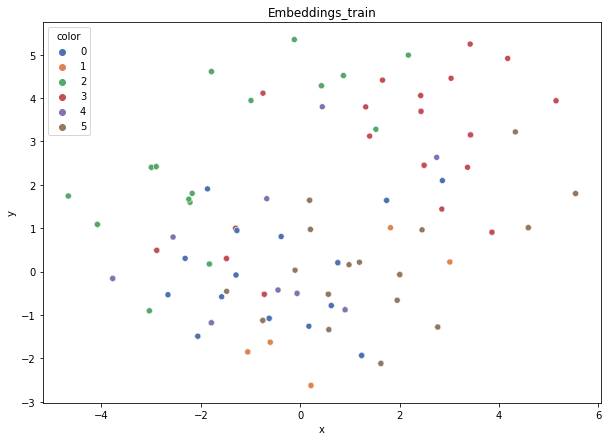

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.756
DT-f1-old+new-features: 0.802
DT-f1-old-features: 0.802
DT-gmean-new-features: 0.759
DT-gmean-old+new-features: 0.806
DT-gmean-old-features: 0.806
DT-minority_gmean-new-features: 0.026
DT-minority_gmean-old+new-features: 0.027
DT-minority_gmean-old-features: 0.027
KNN-f1-new-features: 0.645
KNN-f1-old+new-features: 0.645
KNN-f1-old-features: 0.785
KNN-gmean-new-features: 0.53
KNN-gmean-old+new-features: 0.53
KNN-gmean-old-features: 0.796
KNN-minority_gmean-new-features: 0.01
KNN-minority_gmean-old+new-features: 0.01
KNN-minority_gmean-old-features: 0.029
new_winequality-red


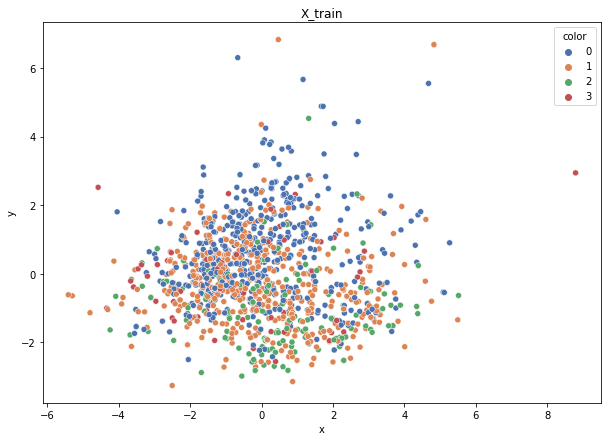

Class cardinalities: Counter({0: 544, 1: 511, 2: 159, 3: 65})
Weights: {0: 0.07217510080141348, 1: 0.07683611513888246, 2: 0.246938709660182, 3: 0.6040500743995221}
Training autoencoder...


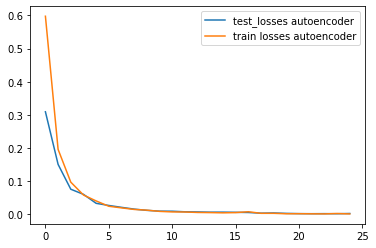

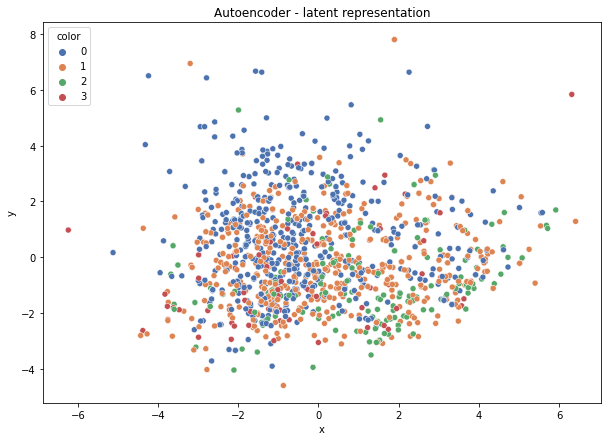

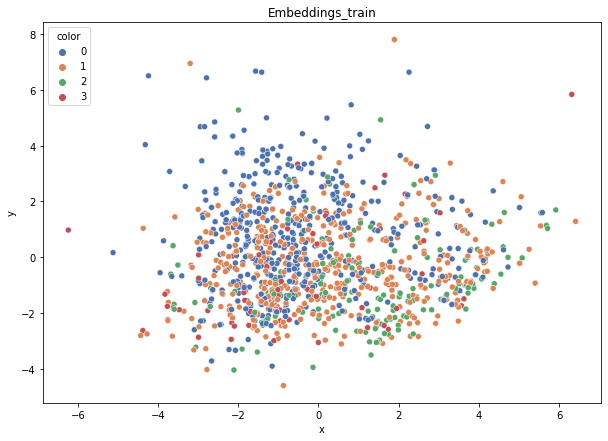

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.555
DT-f1-old+new-features: 0.532
DT-f1-old-features: 0.503
DT-gmean-new-features: 0.544
DT-gmean-old+new-features: 0.478
DT-gmean-old-features: 0.368
DT-minority_gmean-new-features: 0.021
DT-minority_gmean-old+new-features: 0.018
DT-minority_gmean-old-features: 0.014
KNN-f1-new-features: 0.555
KNN-f1-old+new-features: 0.552
KNN-f1-old-features: 0.555
KNN-gmean-new-features: 0.487
KNN-gmean-old+new-features: 0.482
KNN-gmean-old-features: 0.487
KNN-minority_gmean-new-features: 0.018
KNN-minority_gmean-old+new-features: 0.018
KNN-minority_gmean-old-features: 0.018


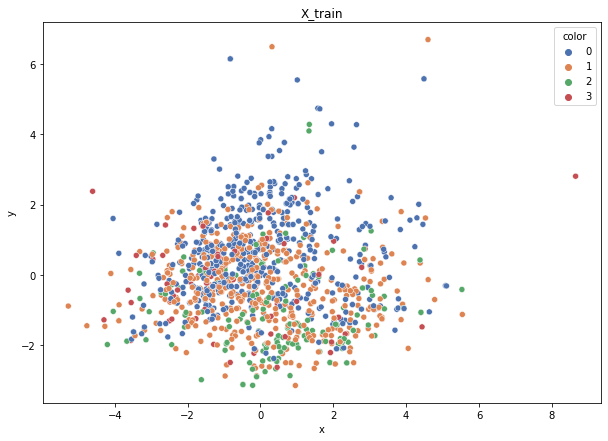

Class cardinalities: Counter({0: 545, 1: 510, 2: 159, 3: 65})
Weights: {0: 0.072041356277607, 1: 0.07698537092410943, 2: 0.24693420862450194, 3: 0.6040390641737817}
Training autoencoder...


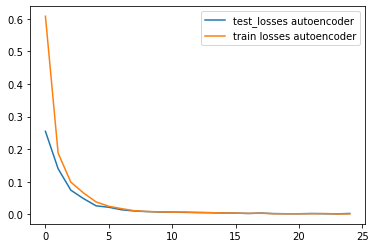

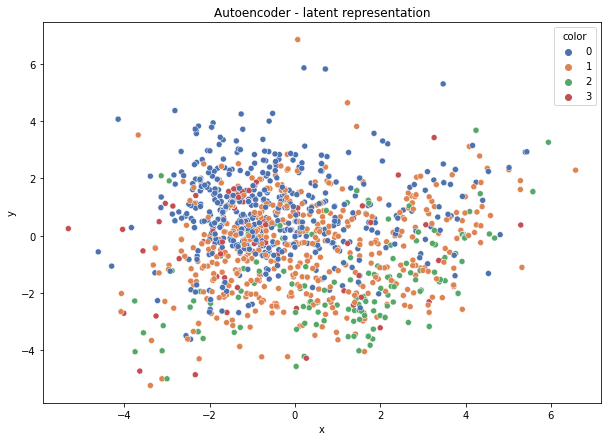

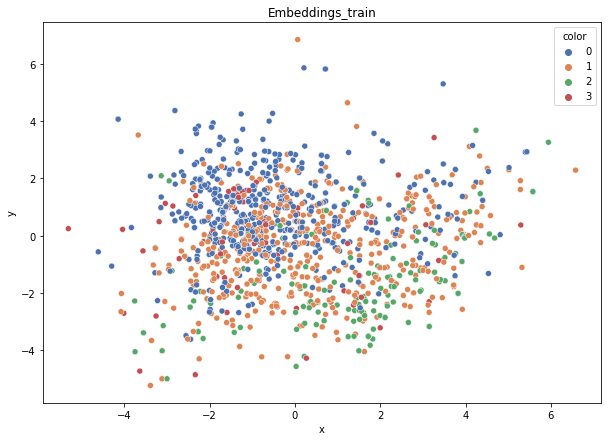

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.507
DT-f1-old+new-features: 0.45
DT-f1-old-features: 0.505
DT-gmean-new-features: 0.498
DT-gmean-old+new-features: 0.409
DT-gmean-old-features: 0.48
DT-minority_gmean-new-features: 0.02
DT-minority_gmean-old+new-features: 0.016
DT-minority_gmean-old-features: 0.019
KNN-f1-new-features: 0.542
KNN-f1-old+new-features: 0.557
KNN-f1-old-features: 0.555
KNN-gmean-new-features: 0.478
KNN-gmean-old+new-features: 0.514
KNN-gmean-old-features: 0.512
KNN-minority_gmean-new-features: 0.018
KNN-minority_gmean-old+new-features: 0.02
KNN-minority_gmean-old-features: 0.02


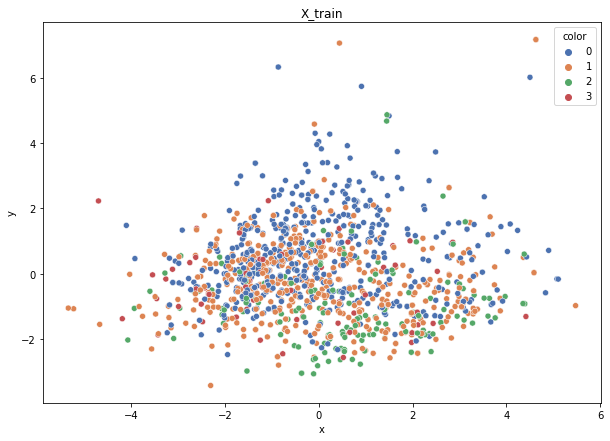

Class cardinalities: Counter({0: 545, 1: 510, 2: 159, 3: 65})
Weights: {0: 0.072041356277607, 1: 0.07698537092410943, 2: 0.24693420862450194, 3: 0.6040390641737817}
Training autoencoder...


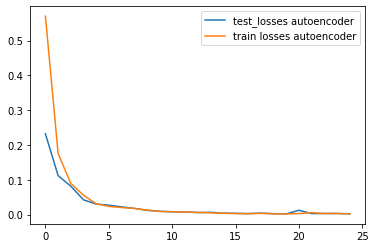

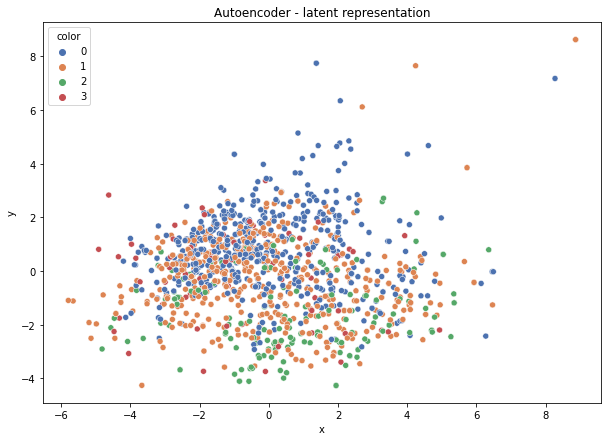

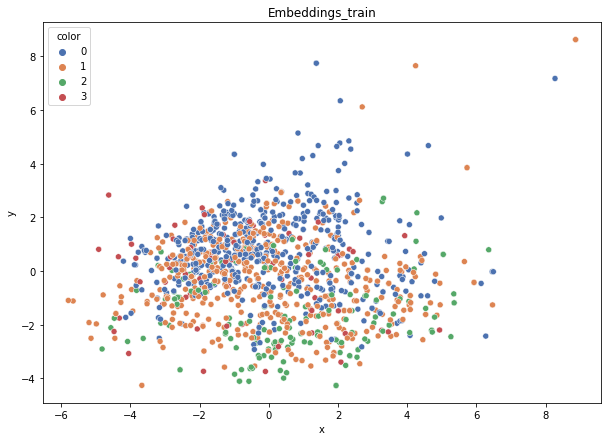

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.499
DT-f1-old+new-features: 0.433
DT-f1-old-features: 0.514
DT-gmean-new-features: 0.461
DT-gmean-old+new-features: 0.121
DT-gmean-old-features: 0.468
DT-minority_gmean-new-features: 0.019
DT-minority_gmean-old+new-features: 0.005
DT-minority_gmean-old-features: 0.019
KNN-f1-new-features: 0.523
KNN-f1-old+new-features: 0.532
KNN-f1-old-features: 0.544
KNN-gmean-new-features: 0.473
KNN-gmean-old+new-features: 0.481
KNN-gmean-old-features: 0.516
KNN-minority_gmean-new-features: 0.019
KNN-minority_gmean-old+new-features: 0.019
KNN-minority_gmean-old-features: 0.02


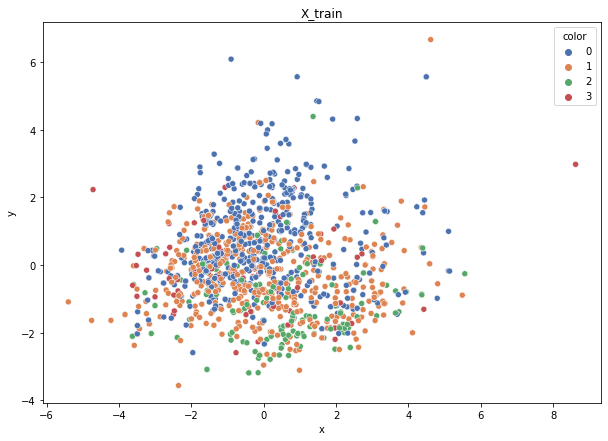

Class cardinalities: Counter({0: 545, 1: 510, 2: 160, 3: 64})
Weights: {0: 0.07147706120661339, 2: 0.24346873973502686, 3: 0.6086718493375671, 1: 0.07638234972079273}
Training autoencoder...


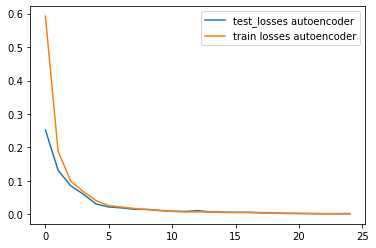

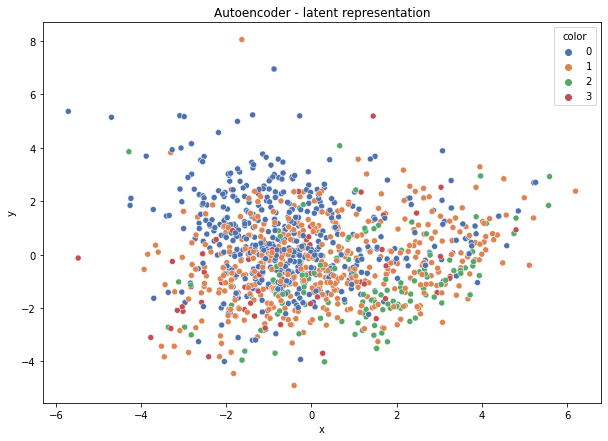

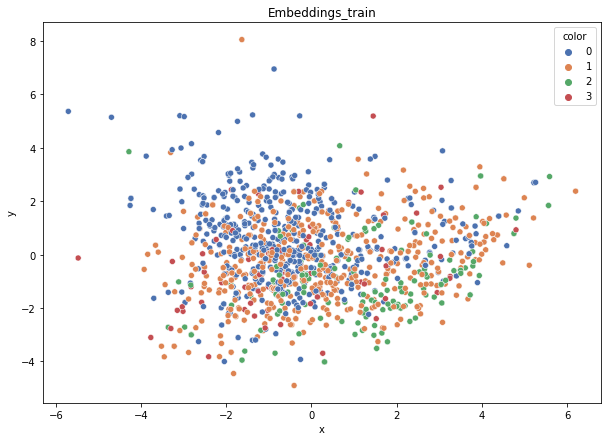

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.5
DT-f1-old+new-features: 0.489
DT-f1-old-features: 0.427
DT-gmean-new-features: 0.47
DT-gmean-old+new-features: 0.486
DT-gmean-old-features: 0.378
DT-minority_gmean-new-features: 0.019
DT-minority_gmean-old+new-features: 0.02
DT-minority_gmean-old-features: 0.015
KNN-f1-new-features: 0.485
KNN-f1-old+new-features: 0.474
KNN-f1-old-features: 0.486
KNN-gmean-new-features: 0.421
KNN-gmean-old+new-features: 0.415
KNN-gmean-old-features: 0.421
KNN-minority_gmean-new-features: 0.016
KNN-minority_gmean-old+new-features: 0.016
KNN-minority_gmean-old-features: 0.016


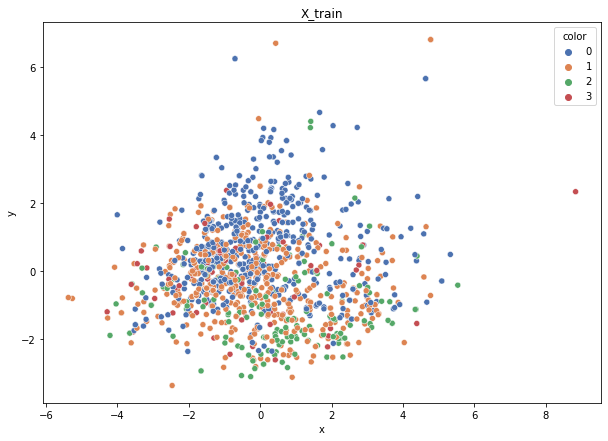

Class cardinalities: Counter({0: 545, 1: 511, 2: 159, 3: 65})
Weights: {0: 0.07205221139741194, 1: 0.07684629199919668, 2: 0.24697141642509127, 3: 0.6041300801783002}
Training autoencoder...


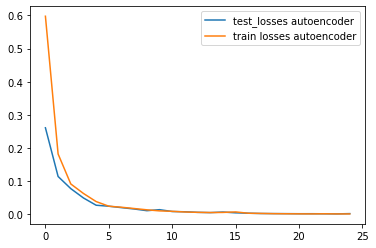

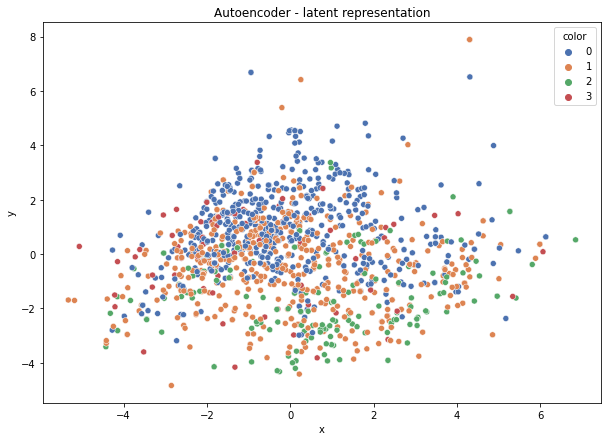

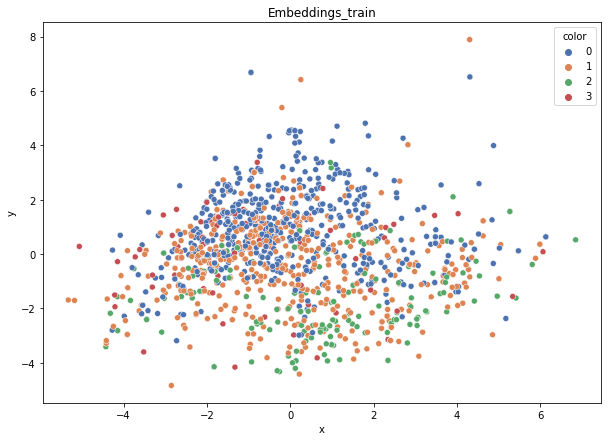

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.475
DT-f1-old+new-features: 0.469
DT-f1-old-features: 0.463
DT-gmean-new-features: 0.401
DT-gmean-old+new-features: 0.405
DT-gmean-old-features: 0.399
DT-minority_gmean-new-features: 0.016
DT-minority_gmean-old+new-features: 0.017
DT-minority_gmean-old-features: 0.017
KNN-f1-new-features: 0.542
KNN-f1-old+new-features: 0.523
KNN-f1-old-features: 0.537
KNN-gmean-new-features: 0.439
KNN-gmean-old+new-features: 0.37
KNN-gmean-old-features: 0.437
KNN-minority_gmean-new-features: 0.017
KNN-minority_gmean-old+new-features: 0.014
KNN-minority_gmean-old-features: 0.017
thyroid-newthyroid


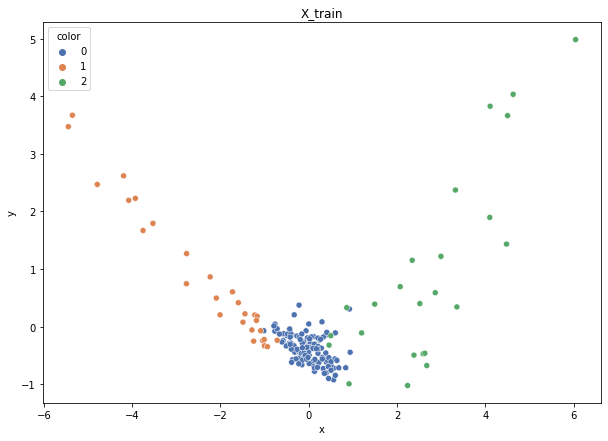

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


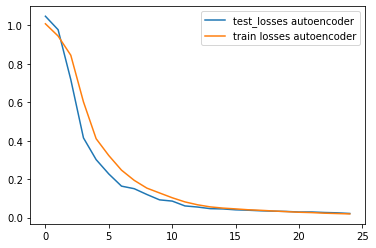

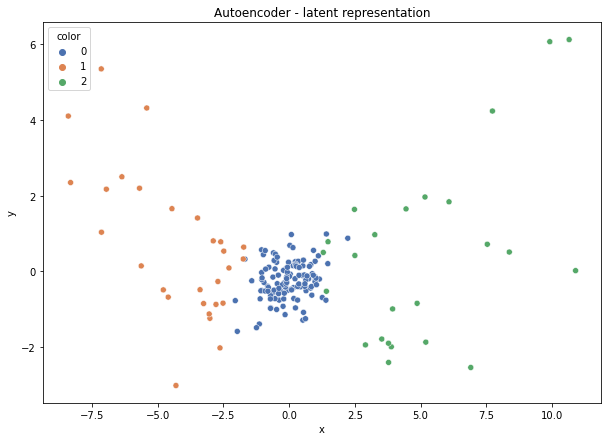

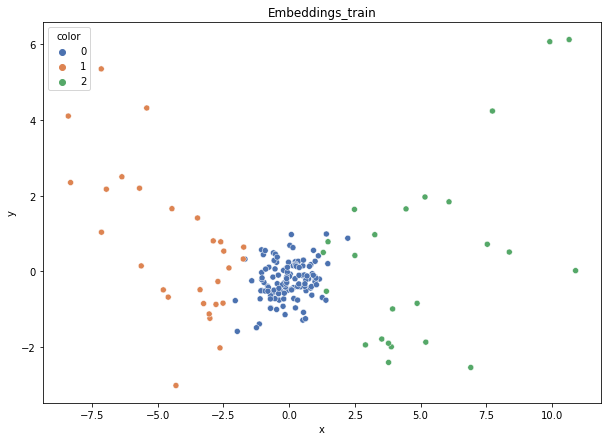

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.875
DT-f1-old+new-features: 0.933
DT-f1-old-features: 0.902
DT-gmean-new-features: 0.874
DT-gmean-old+new-features: 0.93
DT-gmean-old-features: 0.884
DT-minority_gmean-new-features: 0.089
DT-minority_gmean-old+new-features: 0.094
DT-minority_gmean-old-features: 0.089
KNN-f1-new-features: 0.964
KNN-f1-old+new-features: 0.964
KNN-f1-old-features: 0.964
KNN-gmean-new-features: 0.941
KNN-gmean-old+new-features: 0.941
KNN-gmean-old-features: 0.941
KNN-minority_gmean-new-features: 0.094
KNN-minority_gmean-old+new-features: 0.094
KNN-minority_gmean-old-features: 0.094


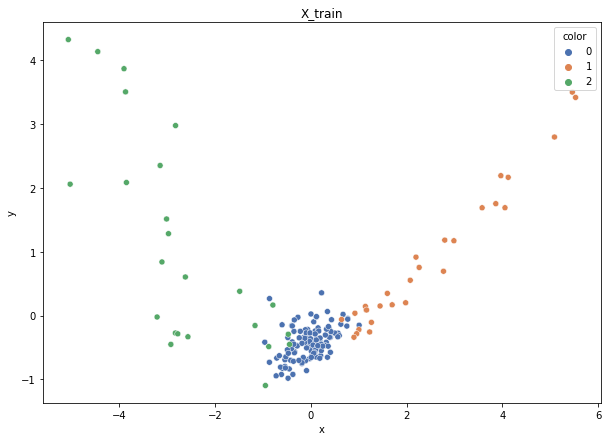

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


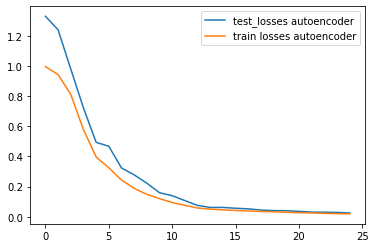

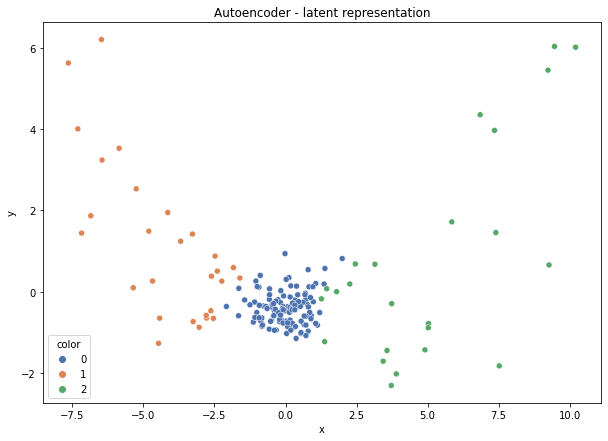

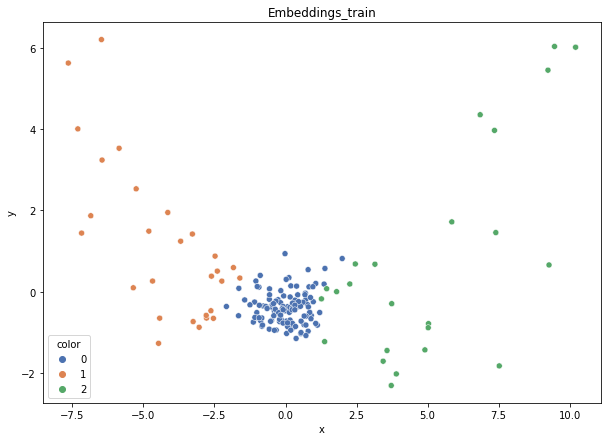

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.936
DT-f1-old+new-features: 0.972
DT-f1-old-features: 0.947
DT-gmean-new-features: 0.93
DT-gmean-old+new-features: 0.989
DT-gmean-old-features: 0.977
DT-minority_gmean-new-features: 0.094
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.972
KNN-f1-old+new-features: 0.972
KNN-f1-old-features: 0.972
KNN-gmean-new-features: 0.989
KNN-gmean-old+new-features: 0.989
KNN-gmean-old-features: 0.989
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


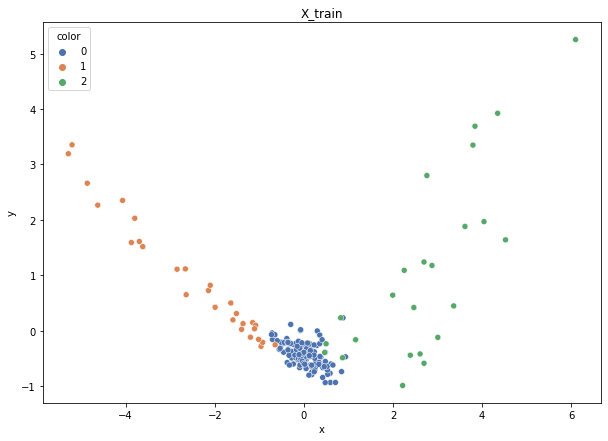

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


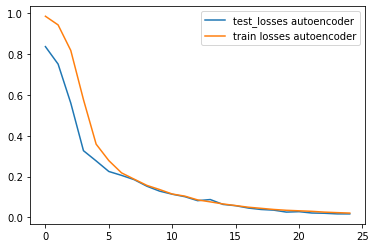

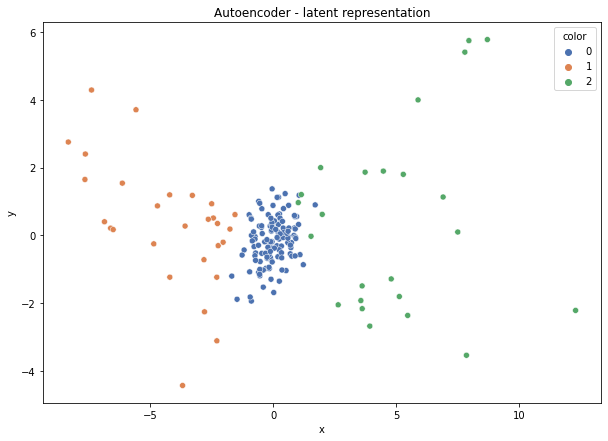

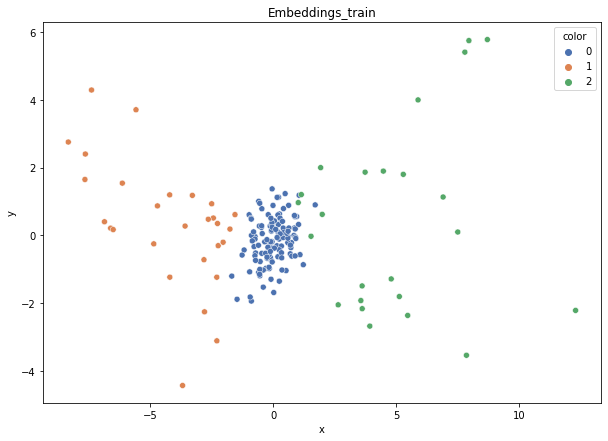

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.941
DT-f1-old+new-features: 0.941
DT-f1-old-features: 0.905
DT-gmean-new-features: 0.977
DT-gmean-old+new-features: 0.977
DT-gmean-old-features: 0.92
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 0.094
KNN-f1-new-features: 0.902
KNN-f1-old+new-features: 0.933
KNN-f1-old-features: 0.902
KNN-gmean-new-features: 0.884
KNN-gmean-old+new-features: 0.894
KNN-gmean-old-features: 0.884
KNN-minority_gmean-new-features: 0.089
KNN-minority_gmean-old+new-features: 0.089
KNN-minority_gmean-old-features: 0.089


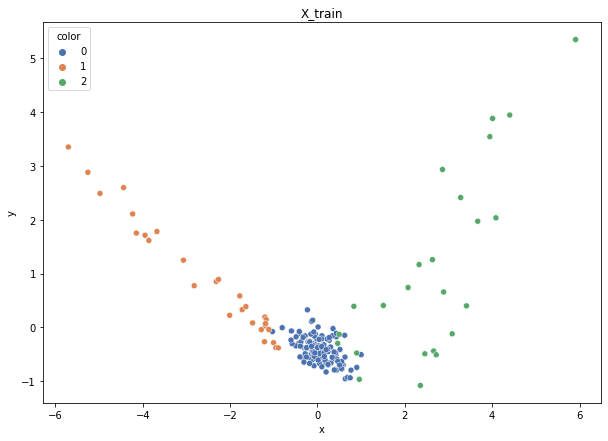

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


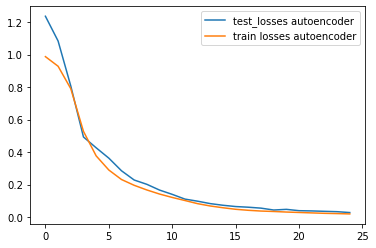

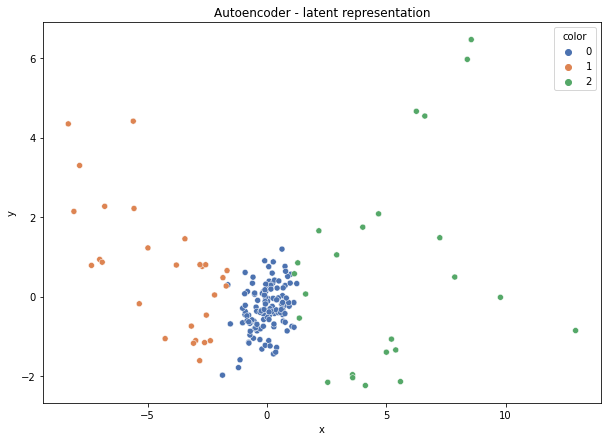

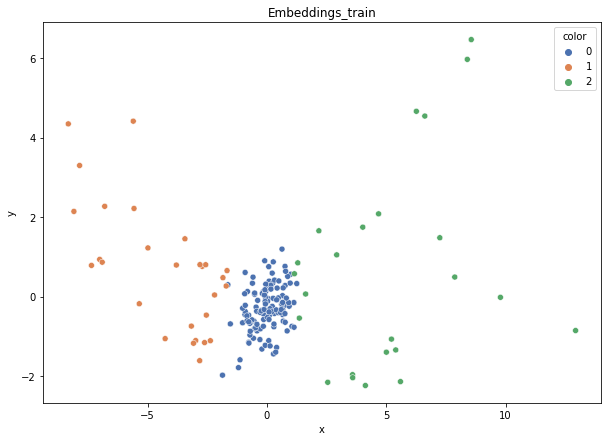

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.913
DT-f1-old+new-features: 0.905
DT-f1-old-features: 0.902
DT-gmean-new-features: 0.965
DT-gmean-old+new-features: 0.92
DT-gmean-old-features: 0.884
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 0.094
DT-minority_gmean-old-features: 0.089
KNN-f1-new-features: 0.936
KNN-f1-old+new-features: 0.972
KNN-f1-old-features: 0.941
KNN-gmean-new-features: 0.93
KNN-gmean-old+new-features: 0.989
KNN-gmean-old-features: 0.977
KNN-minority_gmean-new-features: 0.094
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


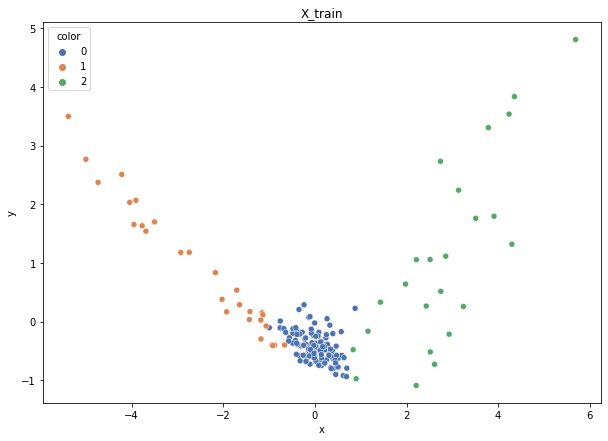

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


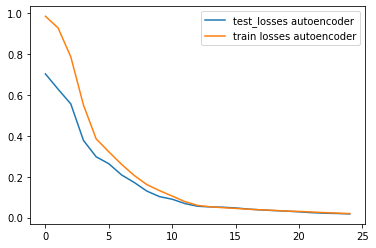

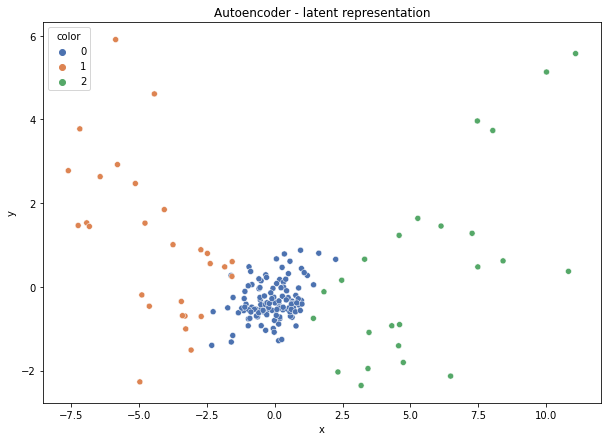

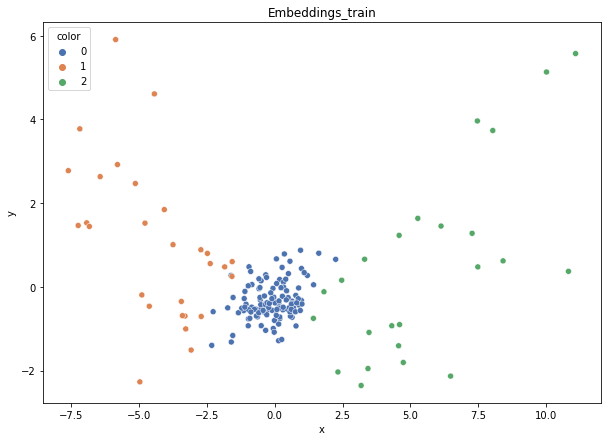

DT-f1-new-features: 0.867
DT-f1-old+new-features: 0.867
DT-f1-old-features: 0.893
DT-gmean-new-features: 0.854
DT-gmean-old+new-features: 0.854
DT-gmean-old-features: 0.864
DT-minority_gmean-new-features: 0.087
DT-minority_gmean-old+new-features: 0.087
DT-minority_gmean-old-features: 0.087
KNN-f1-new-features: 0.923
KNN-f1-old+new-features: 0.893
KNN-f1-old-features: 0.873
KNN-gmean-new-features: 0.874
KNN-gmean-old+new-features: 0.864
KNN-gmean-old-features: 0.794
KNN-minority_gmean-new-features: 0.087
KNN-minority_gmean-old+new-features: 0.087
KNN-minority_gmean-old-features: 0.079


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

In [16]:
result_dict = defaultdict(list)

std_dict = defaultdict(list)

safety_dict = defaultdict(list)

if test_all_ds:
    ds_names = dt_name_to_cols_to_encode.keys()
else:
    ds_names = [ds_name]
for dataset_name in ds_names:
    print(dataset_name)
    result_dict["dataset"].append(dataset_name)
    fold_result_dict = defaultdict(list)

    safety_dict["dataset"].append(dataset_name)
    fold_safety_dict = defaultdict(list)

    X, y = datasets[dataset_name]['data'], datasets[dataset_name]['target']
    X_encoded, y = datasets[f"{dataset_name}_encoded"]['data'], datasets[f"{dataset_name}_encoded"]['target']

    skf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    n_splits = skf.get_n_splits(X, y)

    folds = []
    if test_on_all_folds:
        folds = skf.split(X, y)
    else:
        folds = list(skf.split(X, y))[2:3]

    for train_index, test_index in folds:
#         try:
        X_train, X_test = X[train_index], X[test_index]
        X_train_norm, X_test_norm = standardize(X_train, X_test)
        y_train, y_test = y[train_index], y[test_index]


        X_train_enc, X_test_enc = X_encoded[train_index], X_encoded[test_index]
        X_train_enc, X_test_enc = standardize(X_train_enc, X_test_enc)


        # PCA X_train
        pca = PCA(n_components=2)
        pca.fit(X_train_enc)
        plot_embeddings(pca.transform(X_train_enc), y_train)
        plt.title("X_train")
        plt.show()

        weights = ex.weights_calculation_strategy1(X_train, y_train)
        cfg =  config[dataset_name]
        # pretrain ANN triplets
        autoenc_cfg = autoencoder_config[dataset_name]
        embeddings_train, embeddings_test = ex.train_triplets(X_train_enc, y_train, X_test_enc, y_test, weights,cfg, pca, autoenc_cfg, k_dict[dataset_name], dataset_name)

        s_dict = calc_safety5(embeddings_test, y_test)
        for k, v in s_dict.items():
            fold_safety_dict[f"emb-{k}"].append(v)

        s_dict = calc_safety5(X_test_enc, y_test)
        for k,v in s_dict.items():
            fold_safety_dict[f"raw-{k}"].append(v)

        # PCA embeddings_train
        pca = PCA(n_components=2)
        plot_embeddings(pca.fit_transform(embeddings_train), y_train)
        plt.title("Embeddings_train")
        plt.show()

        X_train_new = np.hstack([X_train_norm, embeddings_train])
        X_test_new = np.hstack([X_test_norm, embeddings_test])

        classifiers = instantiate_classifiers()
        for clf_name, clf in classifiers.items():
            clf.fit(X_train_norm, y_train)
            preds = clf.predict(X_test_norm)

            gmean = gmean_score(y_test, preds)
            f1 = f1_score(y_test, preds, average='macro')
            
            minority_classes = dt_name_minority_classes[dataset_name]
            minority_mask = np.argwhere([label in minority_classes for label in y_test]).ravel()
            gmean_minority = gmean_score(y_test[minority_mask], preds[minority_mask])
            
            fold_result_dict[f"{clf_name}-f1-old-features"].append(f1)
            fold_result_dict[f"{clf_name}-gmean-old-features"].append(gmean)
            fold_result_dict[f"{clf_name}-minority_gmean-old-features"].append(gmean_minority)


        classifiers = instantiate_classifiers()
        for clf_name, clf in classifiers.items():
            clf.fit(X_train_new, y_train)
            preds = clf.predict(X_test_new)

            gmean = gmean_score(y_test, preds)
            f1 = f1_score(y_test, preds, average='macro')
            
            minority_classes = dt_name_minority_classes[dataset_name]
            minority_mask = np.argwhere([label in minority_classes for label in y_test]).ravel()
            gmean_minority = gmean_score(y_test[minority_mask], preds[minority_mask])
            
            
            fold_result_dict[f"{clf_name}-f1-old+new-features"].append(f1)
            fold_result_dict[f"{clf_name}-gmean-old+new-features"].append(gmean)
            fold_result_dict[f"{clf_name}-minority_gmean-old+new-features"].append(gmean_minority)
            
            
        classifiers = instantiate_classifiers()
        for clf_name, clf in classifiers.items():
            clf.fit(embeddings_train, y_train)
            preds = clf.predict(embeddings_test)

            gmean = gmean_score(y_test, preds)
            f1 = f1_score(y_test, preds, average='macro')
            
            minority_classes = dt_name_minority_classes[dataset_name]
            minority_mask = np.argwhere([label in minority_classes for label in y_test]).ravel()
            gmean_minority = gmean_score(y_test[minority_mask], preds[minority_mask])
            
            fold_result_dict[f"{clf_name}-f1-new-features"].append(f1)
            fold_result_dict[f"{clf_name}-gmean-new-features"].append(gmean)
            fold_result_dict[f"{clf_name}-minority_gmean-new-features"].append(gmean_minority)
            
        for key in sorted(list(fold_result_dict.keys())):
            print(f"{key}: {np.round(fold_result_dict[key][-1],3)}")

    for k in fold_result_dict:
        result_dict[k].append(np.mean(fold_result_dict[k]))
        
    for k in fold_result_dict:
        std_dict[f"{k}-std"].append(np.std(fold_result_dict[k], ddof=1))

    for k in fold_safety_dict:
        safety_dict[k].append(np.sum(fold_safety_dict[k]) / X.shape[0])

In [17]:
results_df = pd.DataFrame.from_dict(result_dict)

In [18]:
std_df = pd.DataFrame.from_dict(std_dict)

In [19]:
safety_df = pd.DataFrame.from_dict(safety_dict)

In [20]:
results_df

,dataset,DT-f1-old-features,DT-gmean-old-features,DT-minority_gmean-old-features,KNN-f1-old-features,KNN-gmean-old-features,KNN-minority_gmean-old-features,DT-f1-old+new-features,DT-gmean-old+new-features,DT-minority_gmean-old+new-features,KNN-f1-old+new-features,KNN-gmean-old+new-features,KNN-minority_gmean-old+new-features,DT-f1-new-features,DT-gmean-new-features,DT-minority_gmean-new-features,KNN-f1-new-features,KNN-gmean-new-features,KNN-minority_gmean-new-features
0,cmc,0.467266,0.470278,0.007653,0.422592,0.412867,0.006848,0.450684,0.451567,0.007485,0.409788,0.404561,0.007011,0.389693,0.392220,0.007264,0.403134,0.397649,0.006943
1,dermatology,0.949703,0.951222,1.000000,0.937131,0.932309,1.000000,0.929201,0.927787,1.000000,0.924848,0.926062,1.000000,0.684863,0.640495,0.217014,0.919858,0.927245,1.000000
2,hayes-roth,0.851208,0.838449,1.000000,0.672362,0.636136,0.014118,0.804971,0.789789,0.611019,0.815311,0.803137,0.805774,0.793869,0.786547,0.417402,0.807445,0.793270,0.611547
3,new_vehicle,0.896672,0.898498,0.092997,0.912321,0.912341,0.093402,0.850507,0.851449,0.089199,0.920314,0.918772,0.093751,0.826656,0.831903,0.087859,0.918464,0.918078,0.093742
4,new_yeast,0.442388,0.282887,0.017781,0.486925,0.408416,0.026117,0.423018,0.274950,0.017309,0.490168,0.407814,0.028782,0.407620,0.263294,0.016558,0.488069,0.406819,0.028816
5,1czysty-cut,0.935490,0.936512,0.094798,0.945528,0.943824,0.095391,0.962165,0.962598,0.276885,0.945481,0.941662,0.095094,0.963052,0.962645,0.276850,0.944892,0.941680,0.095094
6,2delikatne-cut,0.724198,0.737376,0.077039,0.699865,0.678350,0.070180,0.763661,0.764069,0.078907,0.691516,0.671036,0.069569,0.751679,0.751159,0.077805,0.694182,0.675902,0.070131
7,3mocniej-cut,0.504810,0.502048,0.055608,0.508642,0.457700,0.048806,0.518355,0.499707,0.054432,0.517536,0.466397,0.049749,0.516865,0.495460,0.053726,0.521169,0.473957,0.050642
8,4delikatne-bezover-cut,0.796105,0.813035,0.085097,0.767612,0.760887,0.079412,0.813267,0.817527,0.084862,0.767907,0.764406,0.079851,0.806373,0.811966,0.084387,0.766574,0.764068,0.079851
9,balance-scale,0.605016,0.416495,0.004768,0.560676,0.089082,0.001000,0.574905,0.412718,0.004848,0.474452,0.080098,0.001000,0.397088,0.227859,0.004498,0.401459,0.071181,0.001000


In [21]:
safety_df[sorted(safety_df.filter(regex=("dataset|emb")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,emb-borderline,emb-outlier,emb-rare,emb-safe
0,cmc,0.522743,0.114053,0.257298,0.105906
1,dermatology,0.398907,0.038251,0.060109,0.502732
2,hayes-roth,0.650000,0.037500,0.175000,0.137500
3,new_vehicle,0.230496,0.018913,0.055556,0.695035
4,new_yeast,0.415768,0.163747,0.177224,0.243261
5,1czysty-cut,0.130833,0.005000,0.015000,0.849167
6,2delikatne-cut,0.200833,0.013333,0.060833,0.725000
7,3mocniej-cut,0.250833,0.065833,0.069167,0.614167
8,4delikatne-bezover-cut,0.191667,0.014167,0.034167,0.760000
9,balance-scale,0.536000,0.075200,0.123200,0.265600


In [22]:
safety_df[sorted(safety_df.filter(regex=("dataset|raw")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,raw-borderline,raw-outlier,raw-rare,raw-safe
0,cmc,0.505771,0.118126,0.262050,0.114053
1,dermatology,0.464481,0.060109,0.144809,0.330601
2,hayes-roth,0.687500,0.031250,0.131250,0.150000
3,new_vehicle,0.255319,0.020095,0.053191,0.671395
4,new_yeast,0.415768,0.164420,0.174528,0.245283
5,1czysty-cut,0.131667,0.003333,0.015000,0.850000
6,2delikatne-cut,0.209167,0.010000,0.060833,0.720000
7,3mocniej-cut,0.232500,0.062500,0.079167,0.625833
8,4delikatne-bezover-cut,0.185833,0.010833,0.040833,0.762500
9,balance-scale,0.508800,0.064000,0.116800,0.310400


In [23]:
safety_df[sorted(safety_df.filter(regex=("dataset|.*safe")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,emb-safe,raw-safe
0,cmc,0.105906,0.114053
1,dermatology,0.502732,0.330601
2,hayes-roth,0.137500,0.150000
3,new_vehicle,0.695035,0.671395
4,new_yeast,0.243261,0.245283
5,1czysty-cut,0.849167,0.850000
6,2delikatne-cut,0.725000,0.720000
7,3mocniej-cut,0.614167,0.625833
8,4delikatne-bezover-cut,0.760000,0.762500
9,balance-scale,0.265600,0.310400


In [24]:
from IPython.display import display
for clf in instantiate_classifiers().keys():
    print(clf)
    display(results_df.filter(regex=(f"dataset|{clf}-f1*")).style.highlight_max(color = 'lightgreen', axis = 1))
    display(results_df.filter(regex=(f"dataset|{clf}-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1))
    display(results_df.filter(regex=(f"dataset|{clf}-minority_gmean*")).style.highlight_max(color = 'lightgreen', axis = 1))

DT


,dataset,DT-f1-old-features,DT-f1-old+new-features,DT-f1-new-features
0,cmc,0.467266,0.450684,0.389693
1,dermatology,0.949703,0.929201,0.684863
2,hayes-roth,0.851208,0.804971,0.793869
3,new_vehicle,0.896672,0.850507,0.826656
4,new_yeast,0.442388,0.423018,0.407620
5,1czysty-cut,0.935490,0.962165,0.963052
6,2delikatne-cut,0.724198,0.763661,0.751679
7,3mocniej-cut,0.504810,0.518355,0.516865
8,4delikatne-bezover-cut,0.796105,0.813267,0.806373
9,balance-scale,0.605016,0.574905,0.397088


,dataset,DT-gmean-old-features,DT-gmean-old+new-features,DT-gmean-new-features
0,cmc,0.470278,0.451567,0.392220
1,dermatology,0.951222,0.927787,0.640495
2,hayes-roth,0.838449,0.789789,0.786547
3,new_vehicle,0.898498,0.851449,0.831903
4,new_yeast,0.282887,0.274950,0.263294
5,1czysty-cut,0.936512,0.962598,0.962645
6,2delikatne-cut,0.737376,0.764069,0.751159
7,3mocniej-cut,0.502048,0.499707,0.495460
8,4delikatne-bezover-cut,0.813035,0.817527,0.811966
9,balance-scale,0.416495,0.412718,0.227859


,dataset,DT-minority_gmean-old-features,DT-minority_gmean-old+new-features,DT-minority_gmean-new-features
0,cmc,0.007653,0.007485,0.007264
1,dermatology,1.000000,1.000000,0.217014
2,hayes-roth,1.000000,0.611019,0.417402
3,new_vehicle,0.092997,0.089199,0.087859
4,new_yeast,0.017781,0.017309,0.016558
5,1czysty-cut,0.094798,0.276885,0.276850
6,2delikatne-cut,0.077039,0.078907,0.077805
7,3mocniej-cut,0.055608,0.054432,0.053726
8,4delikatne-bezover-cut,0.085097,0.084862,0.084387
9,balance-scale,0.004768,0.004848,0.004498


KNN


,dataset,KNN-f1-old-features,KNN-f1-old+new-features,KNN-f1-new-features
0,cmc,0.422592,0.409788,0.403134
1,dermatology,0.937131,0.924848,0.919858
2,hayes-roth,0.672362,0.815311,0.807445
3,new_vehicle,0.912321,0.920314,0.918464
4,new_yeast,0.486925,0.490168,0.488069
5,1czysty-cut,0.945528,0.945481,0.944892
6,2delikatne-cut,0.699865,0.691516,0.694182
7,3mocniej-cut,0.508642,0.517536,0.521169
8,4delikatne-bezover-cut,0.767612,0.767907,0.766574
9,balance-scale,0.560676,0.474452,0.401459


,dataset,KNN-gmean-old-features,KNN-gmean-old+new-features,KNN-gmean-new-features
0,cmc,0.412867,0.404561,0.397649
1,dermatology,0.932309,0.926062,0.927245
2,hayes-roth,0.636136,0.803137,0.793270
3,new_vehicle,0.912341,0.918772,0.918078
4,new_yeast,0.408416,0.407814,0.406819
5,1czysty-cut,0.943824,0.941662,0.941680
6,2delikatne-cut,0.678350,0.671036,0.675902
7,3mocniej-cut,0.457700,0.466397,0.473957
8,4delikatne-bezover-cut,0.760887,0.764406,0.764068
9,balance-scale,0.089082,0.080098,0.071181


,dataset,KNN-minority_gmean-old-features,KNN-minority_gmean-old+new-features,KNN-minority_gmean-new-features
0,cmc,0.006848,0.007011,0.006943
1,dermatology,1.000000,1.000000,1.000000
2,hayes-roth,0.014118,0.805774,0.611547
3,new_vehicle,0.093402,0.093751,0.093742
4,new_yeast,0.026117,0.028782,0.028816
5,1czysty-cut,0.095391,0.095094,0.095094
6,2delikatne-cut,0.070180,0.069569,0.070131
7,3mocniej-cut,0.048806,0.049749,0.050642
8,4delikatne-bezover-cut,0.079412,0.079851,0.079851
9,balance-scale,0.001000,0.001000,0.001000


In [25]:
for clf in instantiate_classifiers().keys():
    print(clf)
    display(std_df.filter(regex=(f"dataset|{clf}-f1*")))
    display(std_df.filter(regex=(f"dataset|{clf}-gmean*")))
    display(std_df.filter(regex=(f"dataset|{clf}-minority_gmean*")))

DT


,DT-f1-old-features-std,DT-f1-old+new-features-std,DT-f1-new-features-std
0,0.018423,0.020129,0.027852
1,0.027136,0.046341,0.083322
2,0.078039,0.064340,0.090387
3,0.013212,0.049849,0.033023
4,0.032903,0.033330,0.030149
5,0.025871,0.019489,0.019183
6,0.029002,0.017773,0.025970
7,0.044341,0.039795,0.048149
8,0.023401,0.012533,0.030149
9,0.038866,0.053108,0.020975


,DT-gmean-old-features-std,DT-gmean-old+new-features-std,DT-gmean-new-features-std
0,0.024349,0.019674,0.028953
1,0.028982,0.056637,0.110651
2,0.092643,0.070198,0.087922
3,0.017400,0.049027,0.027210
4,0.067375,0.080139,0.087770
5,0.032237,0.023926,0.024945
6,0.045134,0.015808,0.023810
7,0.048943,0.055618,0.053744
8,0.038262,0.019447,0.042042
9,0.205822,0.197994,0.148578


,DT-minority_gmean-old-features-std,DT-minority_gmean-old+new-features-std,DT-minority_gmean-new-features-std
0,0.000506,0.000257,0.000228
1,0.000000,0.000000,0.437775
2,0.000000,0.532635,0.531836
3,0.001956,0.003437,0.002095
4,0.004706,0.005006,0.005598
5,0.003279,0.404238,0.404258
6,0.004905,0.001947,0.002363
7,0.004673,0.005932,0.005435
8,0.004363,0.001811,0.004009
9,0.002326,0.002276,0.003761


KNN


,KNN-f1-old-features-std,KNN-f1-old+new-features-std,KNN-f1-new-features-std
0,0.014522,0.010930,0.021593
1,0.017976,0.027528,0.017241
2,0.113050,0.054102,0.051458
3,0.022863,0.022800,0.034679
4,0.038790,0.037087,0.039892
5,0.011746,0.010459,0.011517
6,0.034828,0.025269,0.023783
7,0.040857,0.042076,0.037144
8,0.014169,0.016433,0.015864
9,0.009340,0.030696,0.059216


,KNN-gmean-old-features-std,KNN-gmean-old+new-features-std,KNN-gmean-new-features-std
0,0.016508,0.013283,0.026652
1,0.023759,0.033925,0.016017
2,0.113909,0.060888,0.058014
3,0.017843,0.018178,0.031241
4,0.088142,0.085561,0.085524
5,0.011651,0.010349,0.011291
6,0.052077,0.036362,0.032575
7,0.049446,0.052677,0.047543
8,0.020123,0.022177,0.022412
9,0.000947,0.004328,0.008034


,KNN-minority_gmean-old-features-std,KNN-minority_gmean-old+new-features-std,KNN-minority_gmean-new-features-std
0,0.000124,0.000227,0.000324
1,0.000000,0.000000,0.000000
2,0.009192,0.434304,0.531911
3,0.000973,0.001229,0.002318
4,0.002660,0.006642,0.007064
5,0.001804,0.001703,0.001703
6,0.005565,0.003879,0.003391
7,0.005011,0.005263,0.004828
8,0.002212,0.002395,0.002395
9,0.000000,0.000000,0.000000
